In [49]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.optim as optim
from torch import nn
from torch.nn import functional as F
from torchdiffeq import odeint_adjoint as odeint
from ode import *
from utils import *

In [50]:
metric = Metric()
ode_func = ODEFunc(metric)
ode = NeuralODE(ode_func)

In [51]:
H = np.array([0.00067, 0.0013, 0.0027, 0.0054, 0.011, 0.022])
M = np.array([0.0063, 0.012, 0.021, 0.038, 0.068, 0.1])
poly_fit = np.polyfit(H, M, 3)

In [53]:
def data_line(x, poly_fit):
    return (poly_fit[0] * x**3 + poly_fit[1] * x**2 + poly_fit[2] * x**1 +
            poly_fit[3])
num_of_data = int(1e4)
pos_H = np.zeros(num_of_data)
pos_M = np.zeros(num_of_data)
neg_H = np.zeros(num_of_data)
neg_M = np.zeros(num_of_data)
pos_iter = 0
neg_iter = 0
while pos_iter < num_of_data or neg_iter < num_of_data:
    rand_H = np.random.uniform(0.00001, 0.022)
    rand_M = np.random.uniform(0.00001, 0.1)
    if (abs(rand_M - data_line(rand_H, poly_fit)) < 0.005
            and pos_iter < num_of_data):
        pos_H[pos_iter] = rand_H
        pos_M[pos_iter] = rand_M
        pos_iter += 1
    elif neg_iter < num_of_data:
        neg_H[neg_iter] = rand_H
        neg_M[neg_iter] = rand_M
        neg_iter += 1

In [55]:
def plot_phase_and_metric(eps, dev, threshold=None):
    n_points = 100
    batch_size = 100
    eps = eps
    dev = dev

    times_np = np.linspace(0, 0.9, num=n_points)
    times = torch.from_numpy(times_np.astype(np.float32))

    with torch.no_grad():
        init0 = data_2_init_cond(neg_H, neg_M, ode.func.L, ode.func.lmd)
        pred_final_state = ode(init0, times)
        NN2_predicts = tanaka(pred_final_state.detach().numpy()[:, 1],
                              epsilon=eps,
                              tanh=np.tanh, dev = dev)

    NN2_pos_phis_1 = []
    NN2_pos_Pis_1 = []
    for index in range(len(neg_H)):
        value = NN2_predicts[index]
        if value < threshold:
            NN2_pos_phis_1.append(neg_H[index])
            NN2_pos_Pis_1.append(neg_M[index])
    NN2_pos_phis_1 = np.array(NN2_pos_phis_1)
    NN2_pos_Pis_1 = np.array(NN2_pos_Pis_1)

    with torch.no_grad():
        init0 = data_2_init_cond(pos_H, pos_M, ode.func.L, ode.func.lmd)
        pred_final_state = ode(init0, times)
        NN2_predicts = tanaka(pred_final_state.detach().numpy()[:, 1],
                              epsilon=eps,
                              tanh=np.tanh, dev = dev)

    NN2_pos_phis_2 = []
    NN2_pos_Pis_2 = []
    for index in range(len(pos_H)):
        value = NN2_predicts[index]
        if value < threshold:
            NN2_pos_phis_2.append(pos_H[index])
            NN2_pos_Pis_2.append(pos_M[index])
    NN2_pos_phis_2 = np.array(NN2_pos_phis_2)
    NN2_pos_Pis_2 = np.array(NN2_pos_Pis_2)

    plt.rcParams["font.size"] = 18
    fig = plt.figure(figsize=(14, 4))
    fig.subplots_adjust(bottom=0.15)
    al = fig.add_subplot(1, 2, 1)
    ar = fig.add_subplot(1, 2, 2)
    al.set_xlabel('quark mass [GeV]', fontsize=18)
    al.set_ylabel('<qbar q> [GeV^3]', fontsize=18)
    al.plot(pos_H, pos_M, '.', label='Positive', alpha=0.5)

    al.plot(NN2_pos_phis_1,
            NN2_pos_Pis_1,
            'o',
            label='NN(negative)=0',
            alpha=0.5)
    al.plot(NN2_pos_phis_2,
            NN2_pos_Pis_2,
            'o',
            label='NN(positive)=0',
            alpha=0.1)
    al.plot(H, M, 'o-')
    al.tick_params(labelsize=18)

    with torch.no_grad():
        tensor_metric = metric(times)
        np_metric = tensor_metric.detach().numpy()
        np_metric = np.reshape(np_metric, -1)

    ar.plot(times_np, np_metric, label='Emergent metric', lw=5, alpha=0.5)
    plt.ylim([-1,30])
    ar.legend(loc="upper left")
    ar.tick_params(labelsize=18)
    plt.show()

    return NN2_pos_phis_1, NN2_pos_Pis_1, NN2_pos_phis_2, NN2_pos_Pis_2

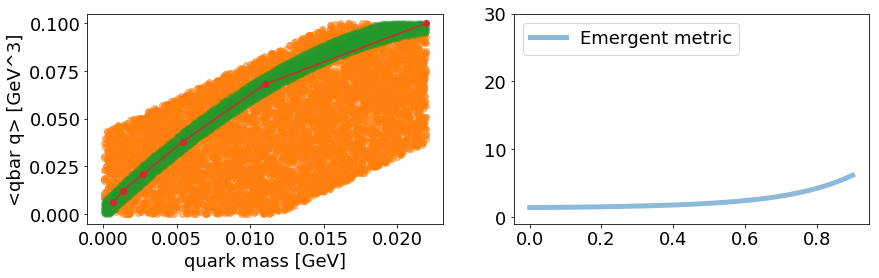

In [57]:
para = plot_phase_and_metric(eps = 0.01, dev = 0.005, threshold=0.1)

In [59]:
np_losses=[]

iter 0 loss 0.499787
L: 0.781999945640564, lmd: 0.006744207348674536, poly: [1.2698991  1.7115992  0.89119947 0.8983996  1.7650996  0.04339981
 1.1233999  0.3417999  1.3948001 ]
name grad
func.lmd tensor([-6.9230e-08])
func.L tensor([-0.0012])
func.metric.poly_para tensor([-2.0888e-05, -2.7145e-05, -3.6130e-05, -4.9626e-05, -7.1137e-05,
        -1.0835e-04, -1.8096e-04, -3.5319e-04, -9.6263e-04])


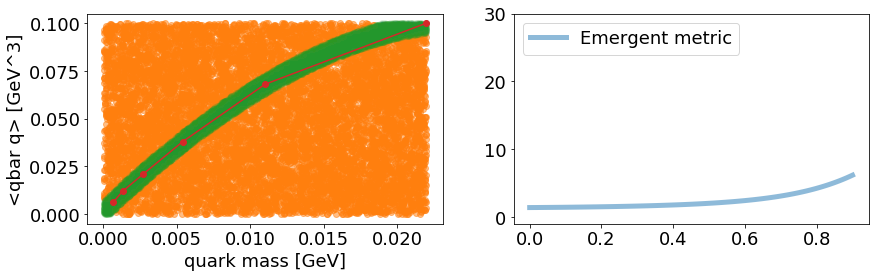

iter 50 loss 0.498993
L: 0.8429210782051086, lmd: 0.06475426256656647, poly: [1.3305557  1.7722677  0.9518814  0.95909745 1.8258159  0.10413916
 1.1841689  0.40261173 1.4556783 ]
name grad
func.lmd tensor([-1.4262e-06])
func.L tensor([-0.0160])
func.metric.poly_para tensor([-0.0003, -0.0003, -0.0004, -0.0006, -0.0009, -0.0014, -0.0023, -0.0046,
        -0.0128])


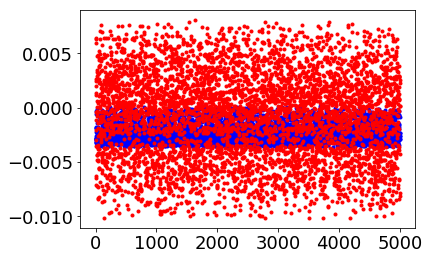

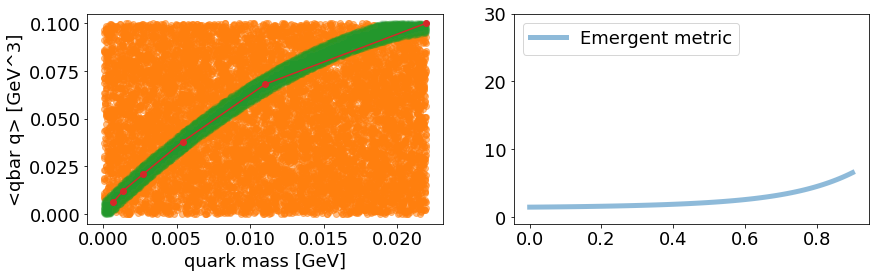

iter 100 loss 0.425970
L: 0.9394659399986267, lmd: 0.16080130636692047, poly: [1.4271204  1.8688204  1.0484197  1.0556192  1.9223177  0.20061727
 1.28062    0.49903202 1.5520695 ]
name grad
func.lmd tensor([-1.0340e-05])
func.L tensor([-0.3792])
func.metric.poly_para tensor([-0.0066, -0.0085, -0.0112, -0.0151, -0.0213, -0.0317, -0.0517, -0.0983,
        -0.2621])


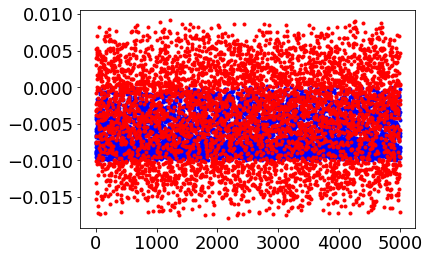

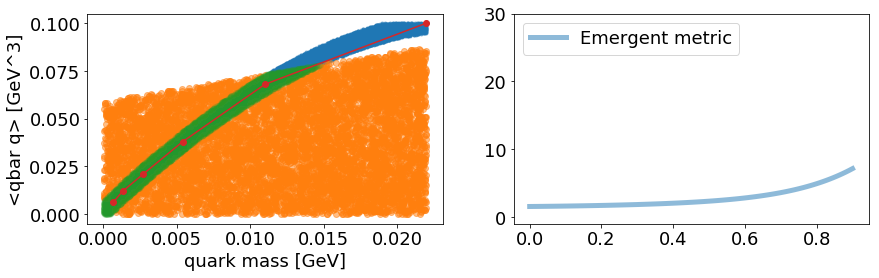

iter 150 loss 0.424178
L: 0.9439674615859985, lmd: 0.1119762733578682, poly: [1.4385911  1.8797072  1.0586034  1.0649452  1.9305857  0.20756009
 1.2858772  0.5020997  1.5521525 ]
name grad
func.lmd tensor([8.7229e-05])
func.L tensor([0.0628])
func.metric.poly_para tensor([0.0002, 0.0004, 0.0006, 0.0011, 0.0020, 0.0038, 0.0079, 0.0196, 0.0698])


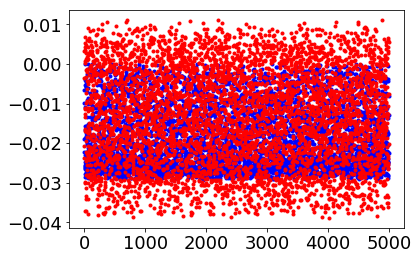

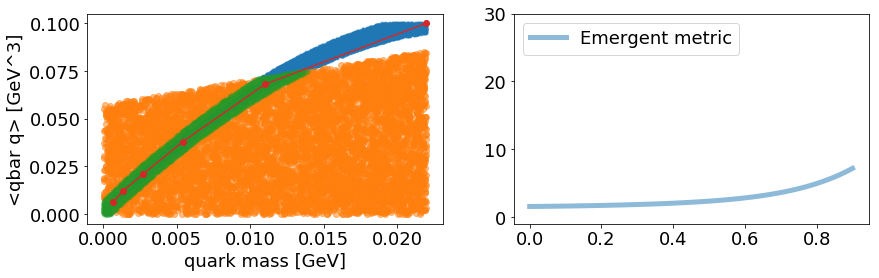

iter 200 loss 0.424557
L: 0.9451068639755249, lmd: 0.058801066130399704, poly: [1.4487497  1.8890948  1.0670624  1.0722706  1.9365109  0.2117321
 1.2878213  0.50116295 1.5473353 ]
name grad
func.lmd tensor([6.2756e-05])
func.L tensor([-0.0510])
func.metric.poly_para tensor([-0.0015, -0.0019, -0.0024, -0.0031, -0.0040, -0.0054, -0.0075, -0.0109,
        -0.0160])


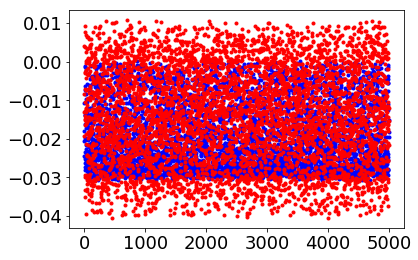

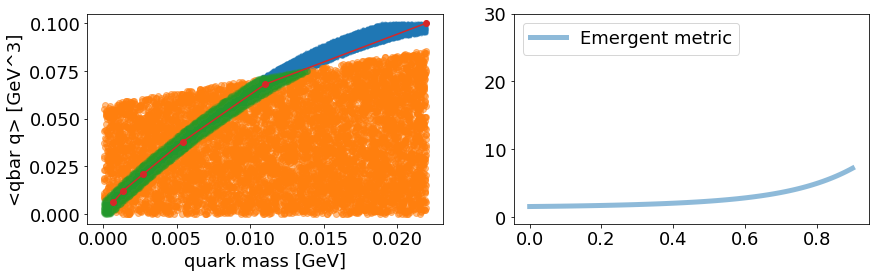

iter 250 loss 0.426345
L: 0.9469583630561829, lmd: 0.006148868706077337, poly: [1.4608934  1.900367   1.0772827  1.0812018  1.9438446  0.21705674
 1.2905853  0.50060904 1.5423198 ]
name grad
func.lmd tensor([6.8956e-05])
func.L tensor([-0.0205])
func.metric.poly_para tensor([-0.0010, -0.0013, -0.0016, -0.0019, -0.0024, -0.0029, -0.0033, -0.0027,
         0.0069])


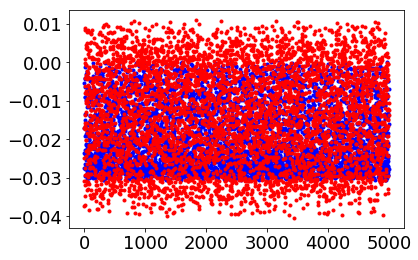

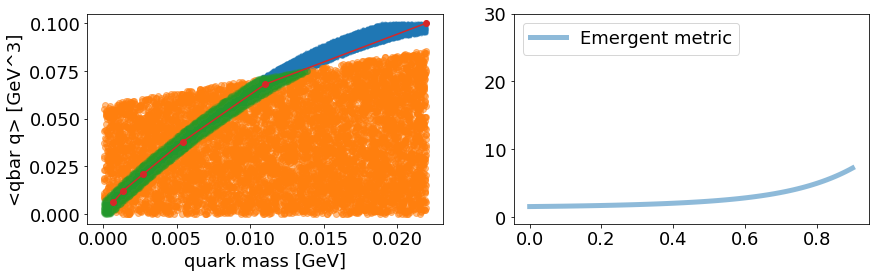

iter 300 loss 0.425174
L: 0.9488144516944885, lmd: -0.04640497639775276, poly: [1.4741553  1.9126738  1.0884309  1.0909278  1.9517995  0.22277732
 1.2934492  0.4997635  1.5364964 ]
name grad
func.lmd tensor([6.9190e-05])
func.L tensor([-0.0245])
func.metric.poly_para tensor([-0.0011, -0.0014, -0.0017, -0.0021, -0.0026, -0.0032, -0.0039, -0.0038,
         0.0037])


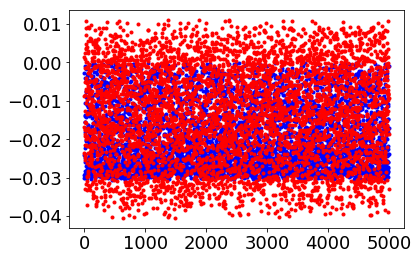

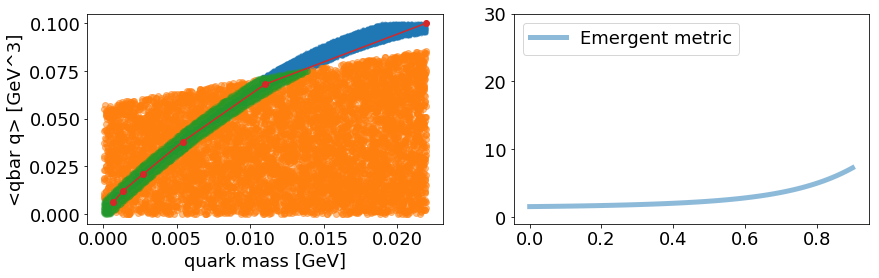

iter 350 loss 0.422850
L: 0.9507544040679932, lmd: -0.09944194555282593, poly: [1.4885992  1.9260813  1.1005777  1.1015211  1.9604512  0.22896971
 1.2964865  0.4986973  1.5299348 ]
name grad
func.lmd tensor([7.0326e-05])
func.L tensor([-0.0294])
func.metric.poly_para tensor([-0.0012, -0.0015, -0.0018, -0.0023, -0.0029, -0.0037, -0.0046, -0.0051,
         0.0006])


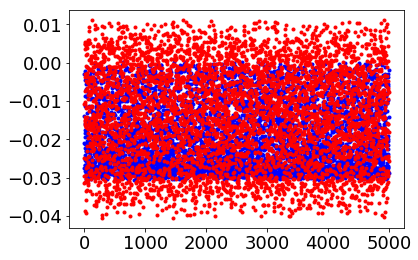

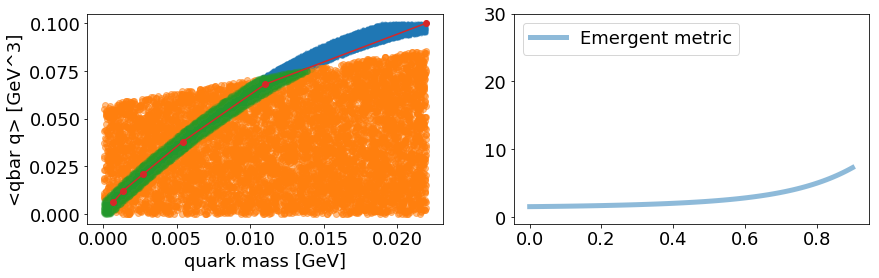

iter 400 loss 0.425027
L: 0.9536193609237671, lmd: -0.15247270464897156, poly: [1.5049832  1.9413595  1.1145068  1.1137798  1.970614   0.23646483
 1.300544   0.49827182 1.5235103 ]
name grad
func.lmd tensor([6.7951e-05])
func.L tensor([-0.0562])
func.metric.poly_para tensor([-0.0017, -0.0021, -0.0026, -0.0034, -0.0044, -0.0059, -0.0083, -0.0123,
        -0.0194])


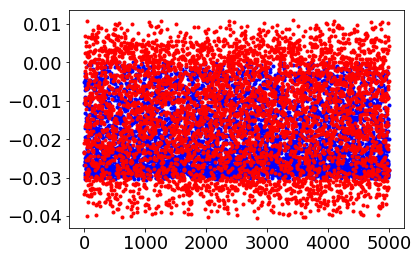

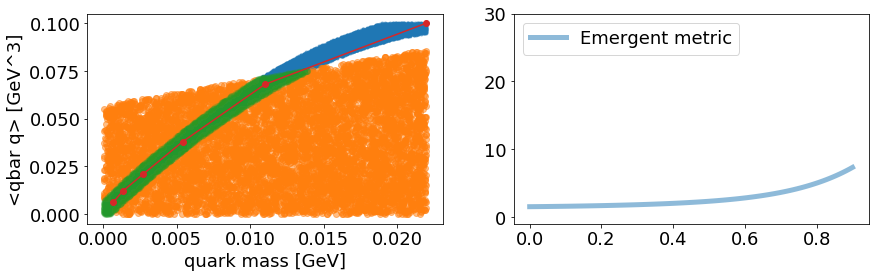

iter 450 loss 0.426783
L: 0.9561798572540283, lmd: -0.20600561797618866, poly: [1.5219682  1.957177   1.1288946  1.1263901  1.9809871  0.24397847
 1.3043607  0.4972587  1.5160531 ]
name grad
func.lmd tensor([7.9707e-05])
func.L tensor([0.0013])
func.metric.poly_para tensor([-0.0007, -0.0009, -0.0010, -0.0012, -0.0012, -0.0011, -0.0003,  0.0034,
         0.0246])


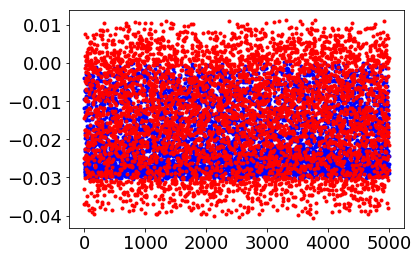

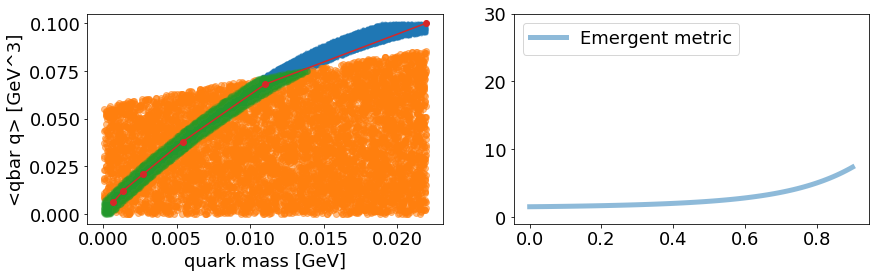

iter 500 loss 0.423174
L: 0.9590712189674377, lmd: -0.25997593998908997, poly: [1.5402052  1.9741879  1.1443975  1.140013   1.9922299  0.25216764
 1.3085854  0.49629083 1.5081705 ]
name grad
func.lmd tensor([7.8555e-05])
func.L tensor([-0.0074])
func.metric.poly_para tensor([-0.0008, -0.0010, -0.0012, -0.0014, -0.0017, -0.0018, -0.0015,  0.0009,
         0.0172])


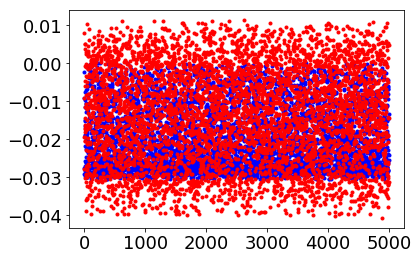

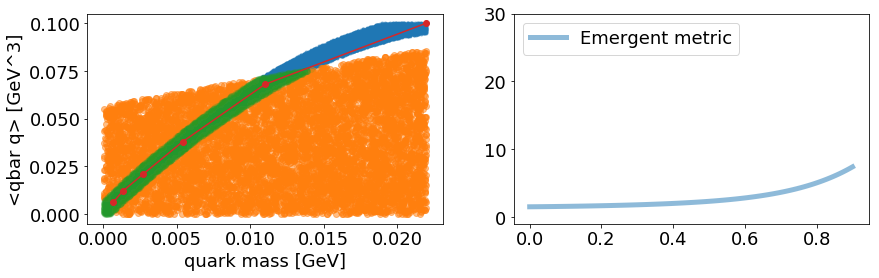

iter 550 loss 0.422263
L: 0.9628967642784119, lmd: -0.3139328062534332, poly: [1.5601592  1.9928727  1.1615171  1.1551706  2.0048935  0.26161277
 1.3138316  0.49601755 1.50055   ]
name grad
func.lmd tensor([9.1839e-05])
func.L tensor([0.0255])
func.metric.poly_para tensor([-3.6389e-04, -3.8130e-04, -3.6242e-04, -2.5775e-04,  5.0560e-05,
         8.7033e-04,  3.1302e-03,  1.0388e-02,  4.4805e-02])


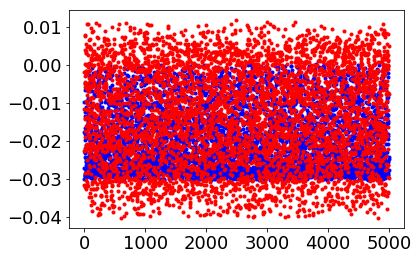

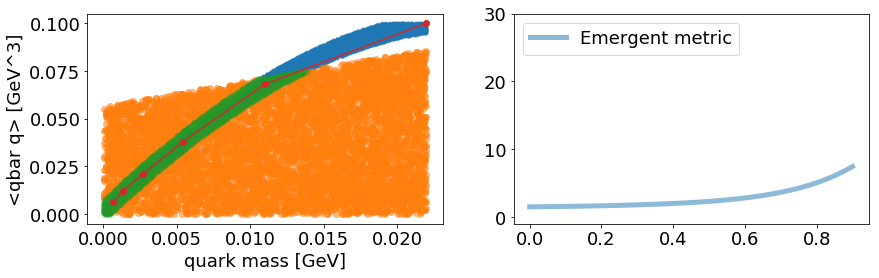

iter 600 loss 0.422191
L: 0.9660418629646301, lmd: -0.369026780128479, poly: [1.5803362  2.0117207  1.1787183  1.1703025  2.0173838  0.27068406
 1.3184273  0.49472553 1.491457  ]
name grad
func.lmd tensor([8.6899e-05])
func.L tensor([0.0093])
func.metric.poly_para tensor([-0.0006, -0.0007, -0.0008, -0.0009, -0.0008, -0.0005,  0.0009,  0.0059,
         0.0319])


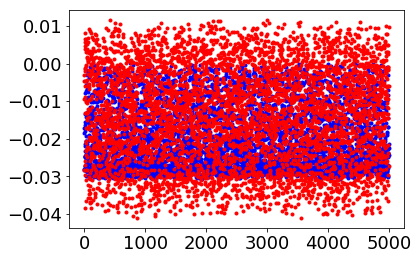

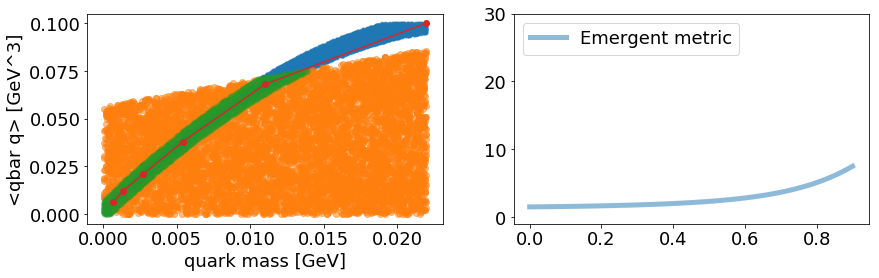

iter 650 loss 0.421871
L: 0.9694809317588806, lmd: -0.42472732067108154, poly: [1.6016147  2.0316234  1.1969131  1.1863401  2.0306556  0.28035745
 1.3233709  0.49343118 1.4819187 ]
name grad
func.lmd tensor([8.8953e-05])
func.L tensor([0.0059])
func.metric.poly_para tensor([-0.0006, -0.0008, -0.0009, -0.0009, -0.0010, -0.0007,  0.0004,  0.0049,
         0.0288])


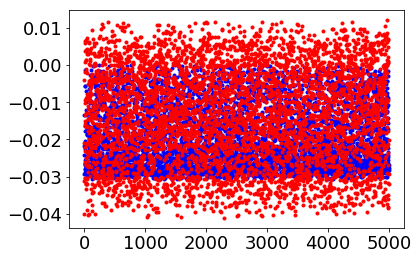

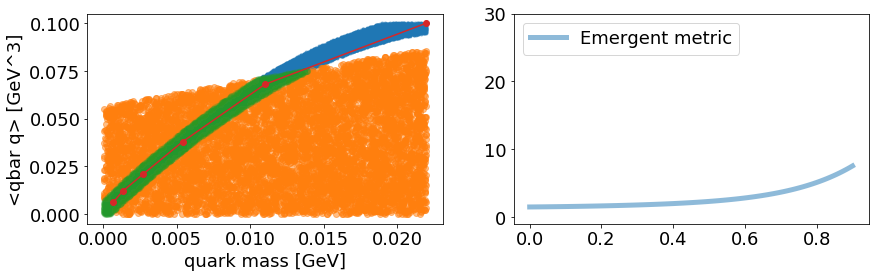

iter 700 loss 0.422523
L: 0.973355233669281, lmd: -0.4811185598373413, poly: [1.6240714  2.0526671  1.2161934  1.2033864  2.0448232  0.2907601
 1.3288018  0.49228582 1.4721012 ]
name grad
func.lmd tensor([9.0025e-05])
func.L tensor([0.0006])
func.metric.poly_para tensor([-0.0008, -0.0009, -0.0010, -0.0012, -0.0013, -0.0012, -0.0003,  0.0036,
         0.0255])


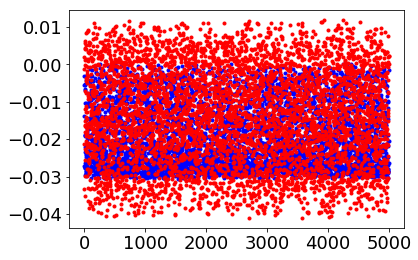

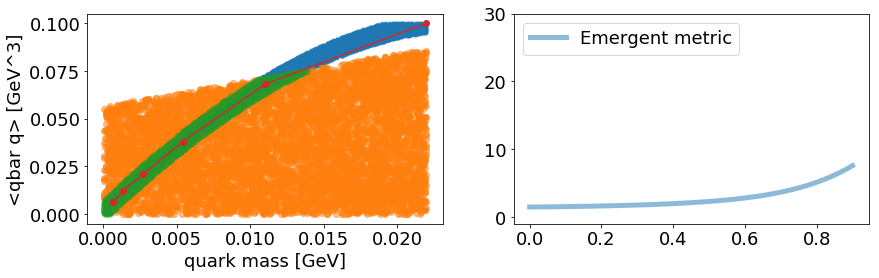

iter 750 loss 0.425574
L: 0.9773185849189758, lmd: -0.5384618639945984, poly: [1.6473567  2.0744994  1.2362076  1.2210867  2.0595276  0.30152762
 1.3343471  0.49090958 1.4616259 ]
name grad
func.lmd tensor([8.3659e-05])
func.L tensor([-0.0352])
func.metric.poly_para tensor([-0.0013, -0.0016, -0.0021, -0.0026, -0.0033, -0.0043, -0.0055, -0.0069,
        -0.0044])


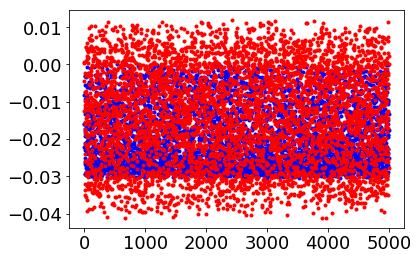

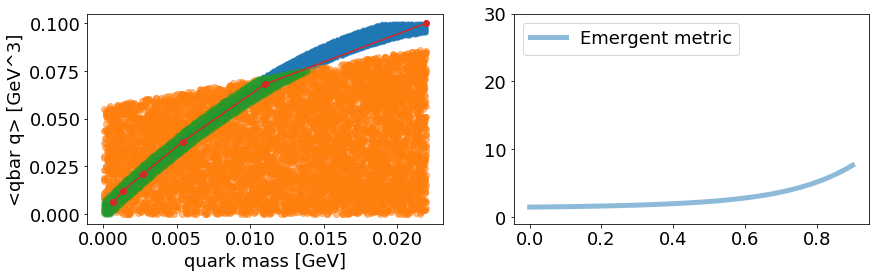

iter 800 loss 0.419850
L: 0.9818753004074097, lmd: -0.5966461300849915, poly: [1.6720294  2.0976846  1.2575227  1.2400105  2.0753386  0.31322262
 1.3405514  0.48980826 1.4509398 ]
name grad
func.lmd tensor([0.0001])
func.L tensor([0.0630])
func.metric.poly_para tensor([0.0003, 0.0005, 0.0008, 0.0013, 0.0023, 0.0043, 0.0090, 0.0222, 0.0785])


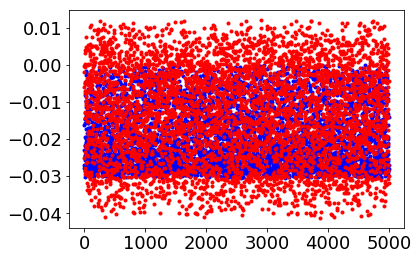

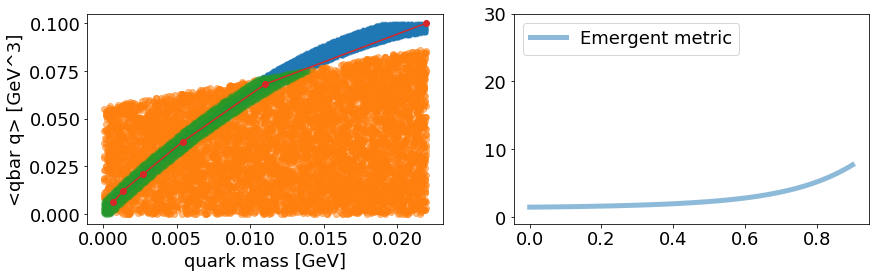

iter 850 loss 0.421123
L: 0.9862986207008362, lmd: -0.6554232239723206, poly: [1.6971686  2.1213078  1.2792337  1.2592643  2.0913804  0.32499444
 1.3466026  0.48823088 1.4393982 ]
name grad
func.lmd tensor([8.5587e-05])
func.L tensor([-0.0381])
func.metric.poly_para tensor([-0.0014, -0.0017, -0.0021, -0.0027, -0.0035, -0.0045, -0.0060, -0.0080,
        -0.0076])


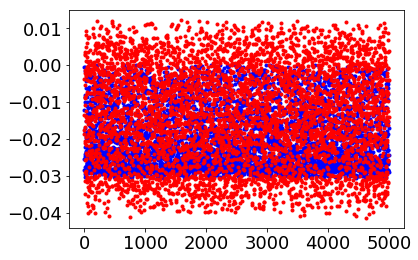

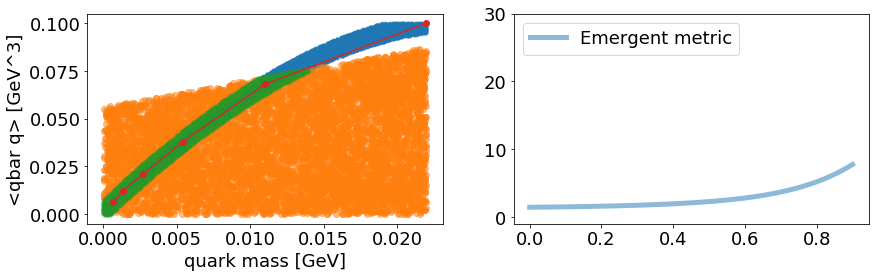

iter 900 loss 0.420472
L: 0.9908819794654846, lmd: -0.7149460315704346, poly: [1.7231193  2.1457148  1.3016832  1.2791895  2.107987   0.33716962
 1.3528093  0.48645854 1.4272432 ]
name grad
func.lmd tensor([7.9356e-05])
func.L tensor([-0.0712])
func.metric.poly_para tensor([-0.0020, -0.0025, -0.0031, -0.0041, -0.0054, -0.0076, -0.0111, -0.0180,
        -0.0361])


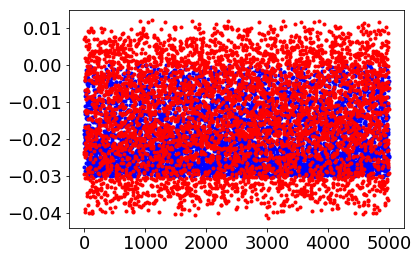

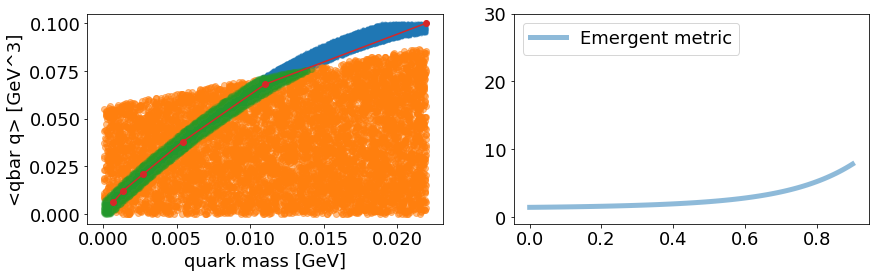

iter 950 loss 0.417043
L: 0.9966036677360535, lmd: -0.7751692533493042, poly: [1.7508216  2.17186    1.3258469  1.3007839  2.1261842  0.35079968
 1.3602487  0.48558116 1.4155457 ]
name grad
func.lmd tensor([8.6423e-05])
func.L tensor([-0.0600])
func.metric.poly_para tensor([-0.0018, -0.0022, -0.0028, -0.0037, -0.0048, -0.0066, -0.0095, -0.0148,
        -0.0266])


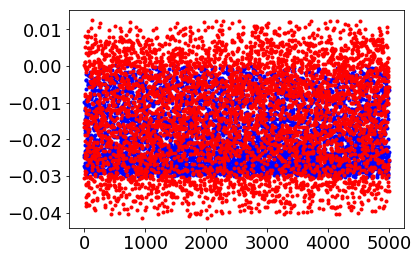

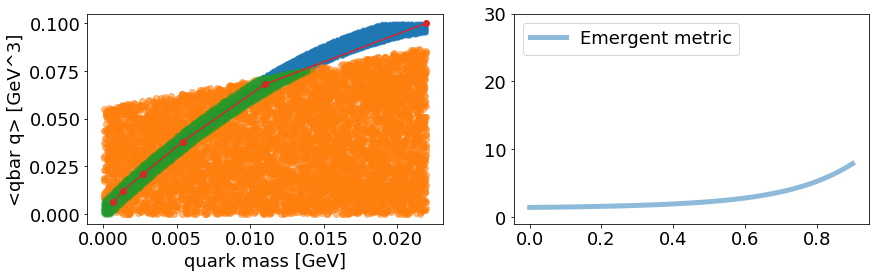

iter 1000 loss 0.418479
L: 1.0025771856307983, lmd: -0.8361804485321045, poly: [1.7793069  2.1987722  1.350749   1.3230681  2.1449883  0.36489648
 1.3679292  0.48461434 1.403367  ]
name grad
func.lmd tensor([0.0001])
func.L tensor([0.0050])
func.metric.poly_para tensor([-0.0007, -0.0008, -0.0009, -0.0010, -0.0010, -0.0007,  0.0006,  0.0056,
         0.0321])


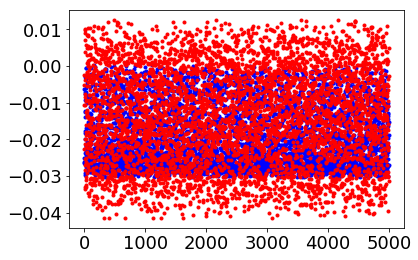

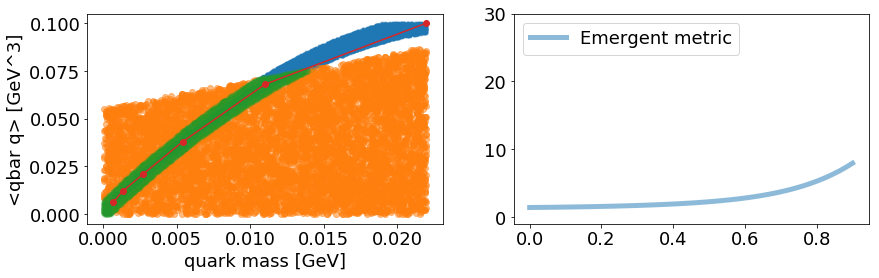

iter 1050 loss 0.417944
L: 1.0077850818634033, lmd: -0.8984692692756653, poly: [1.807591   2.2254448  1.3753569  1.3449775  2.1632953  0.3783179
 1.374671   0.48235795 1.3895439 ]
name grad
func.lmd tensor([9.4673e-05])
func.L tensor([-0.0546])
func.metric.poly_para tensor([-0.0017, -0.0021, -0.0027, -0.0035, -0.0046, -0.0062, -0.0088, -0.0134,
        -0.0224])


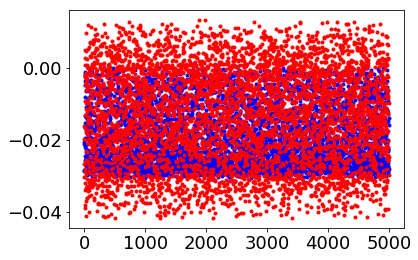

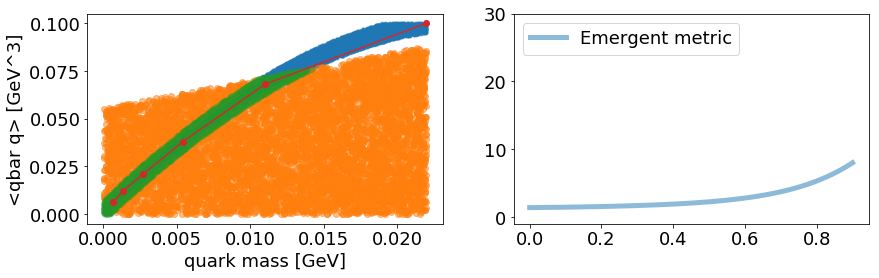

iter 1100 loss 0.417348
L: 1.0146421194076538, lmd: -0.961908221244812, poly: [1.8381255  2.2543697  1.4022108  1.3691076  2.1837637  0.39377522
 1.3832184  0.4815301  1.3766408 ]
name grad
func.lmd tensor([0.0001])
func.L tensor([-0.0234])
func.metric.poly_para tensor([-0.0012, -0.0015, -0.0018, -0.0022, -0.0027, -0.0033, -0.0039, -0.0034,
         0.0065])


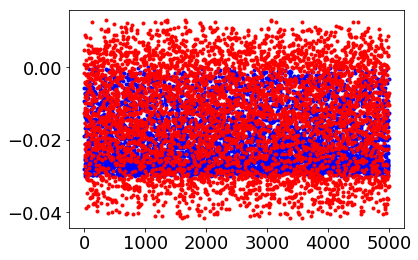

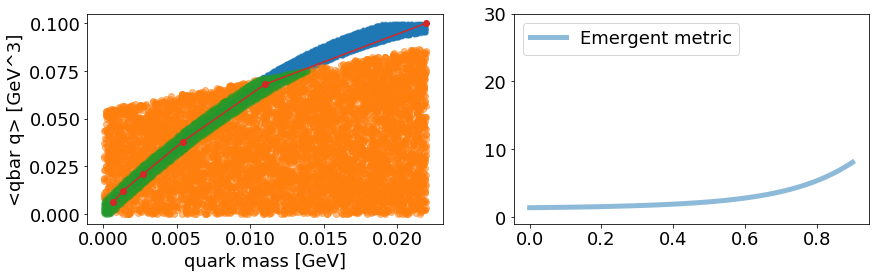

iter 1150 loss 0.416381
L: 1.0214147567749023, lmd: -1.0265611410140991, poly: [1.8691366  2.2837498  1.4294835  1.3935949  2.2044868  0.40931576
 1.3915732  0.48010945 1.362703  ]
name grad
func.lmd tensor([0.0001])
func.L tensor([0.0048])
func.metric.poly_para tensor([-0.0007, -0.0008, -0.0009, -0.0010, -0.0010, -0.0006,  0.0007,  0.0060,
         0.0334])


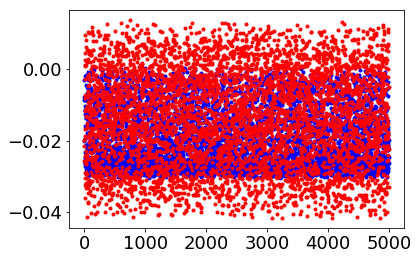

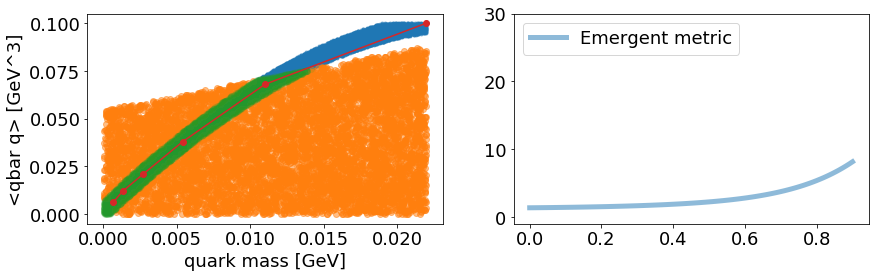

iter 1200 loss 0.417093
L: 1.0285660028457642, lmd: -1.0924367904663086, poly: [1.9010345  2.3140066  1.4576082  1.418889   2.2259333  0.4254308
 1.400247   0.47862318 1.348258  ]
name grad
func.lmd tensor([0.0001])
func.L tensor([-0.0255])
func.metric.poly_para tensor([-0.0013, -0.0015, -0.0019, -0.0023, -0.0029, -0.0036, -0.0042, -0.0039,
         0.0053])


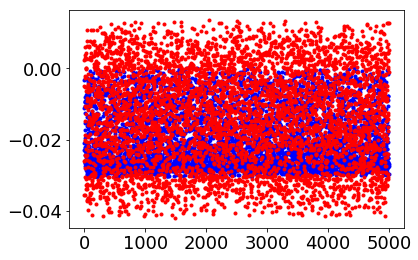

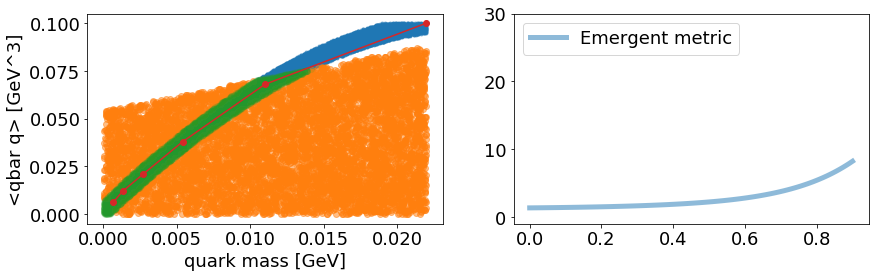

iter 1250 loss 0.421497
L: 1.0355455875396729, lmd: -1.1602071523666382, poly: [1.9335386 2.3448217 1.4862257 1.4445742 2.2476149 0.4415355 1.4085352
 0.4762298 1.3323512]
name grad
func.lmd tensor([0.0001])
func.L tensor([-0.0045])
func.metric.poly_para tensor([-0.0009, -0.0010, -0.0012, -0.0014, -0.0015, -0.0015, -0.0007,  0.0031,
         0.0253])


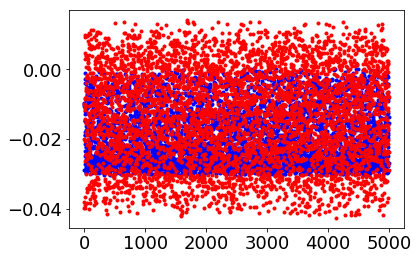

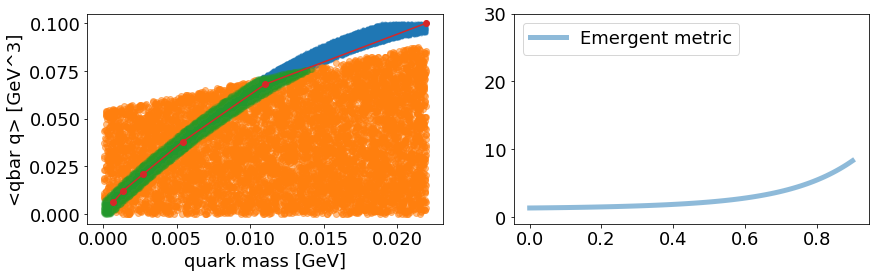

iter 1300 loss 0.413736
L: 1.0438222885131836, lmd: -1.2285419702529907, poly: [1.9674634  2.3770945  1.5163332  1.4717783  2.2708235  0.4591289
 1.4181873  0.47495207 1.3172411 ]
name grad
func.lmd tensor([0.0001])
func.L tensor([-0.0316])
func.metric.poly_para tensor([-0.0014, -0.0017, -0.0022, -0.0027, -0.0034, -0.0043, -0.0053, -0.0058,
         0.0008])


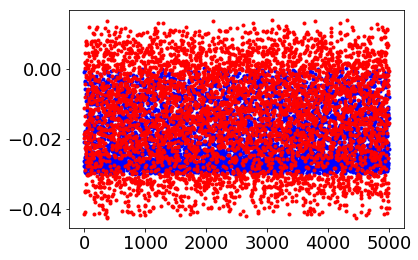

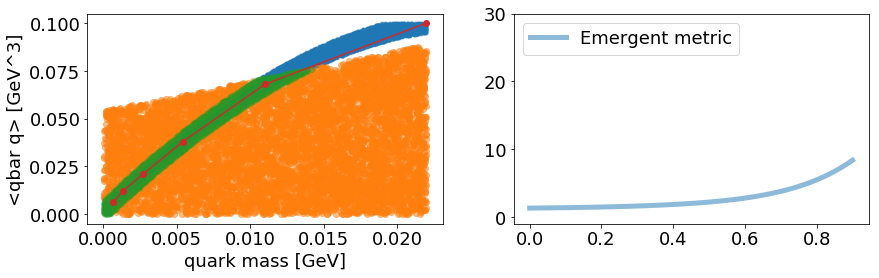

iter 1350 loss 0.414091
L: 1.0522211790084839, lmd: -1.2988420724868774, poly: [2.0020401  2.4099965  1.5470351  1.499513   2.2944531  0.47695348
 1.4277517  0.47311726 1.3010759 ]
name grad
func.lmd tensor([0.0001])
func.L tensor([-0.0288])
func.metric.poly_para tensor([-0.0013, -0.0016, -0.0020, -0.0025, -0.0032, -0.0040, -0.0049, -0.0051,
         0.0022])


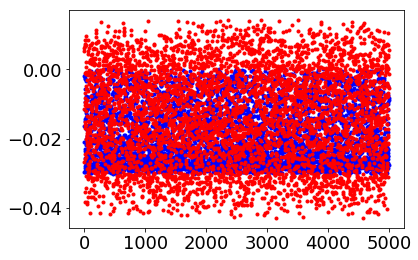

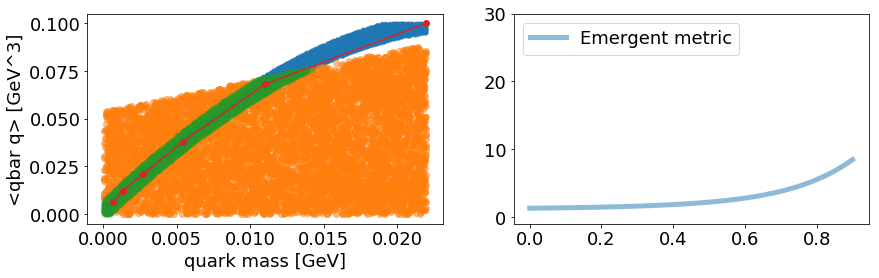

iter 1400 loss 0.414810
L: 1.061975359916687, lmd: -1.3703023195266724, poly: [2.0382414  2.444543   1.5793989  1.5289161  2.3197317  0.49635577
 1.4387261  0.47239044 1.2856328 ]
name grad
func.lmd tensor([0.0002])
func.L tensor([0.0237])
func.metric.poly_para tensor([-0.0004, -0.0004, -0.0003, -0.0002,  0.0003,  0.0015,  0.0046,  0.0145,
         0.0602])


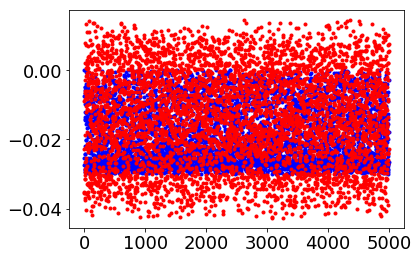

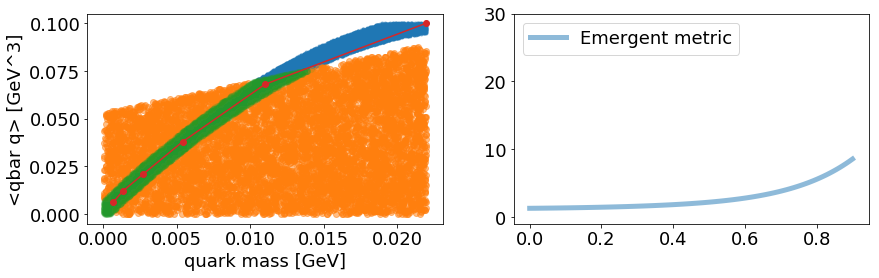

iter 1450 loss 0.409274
L: 1.0712573528289795, lmd: -1.4437710046768188, poly: [2.0743103  2.4789174  1.6115305  1.5580016  2.3445592  0.5151022
 1.4487356  0.47029993 1.2685028 ]
name grad
func.lmd tensor([0.0002])
func.L tensor([-0.0157])
func.metric.poly_para tensor([-1.1297e-03, -1.3593e-03, -1.6374e-03, -1.9658e-03, -2.3251e-03,
        -2.6181e-03, -2.4453e-03,  3.9600e-05,  1.7855e-02])


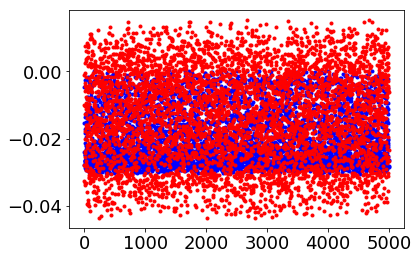

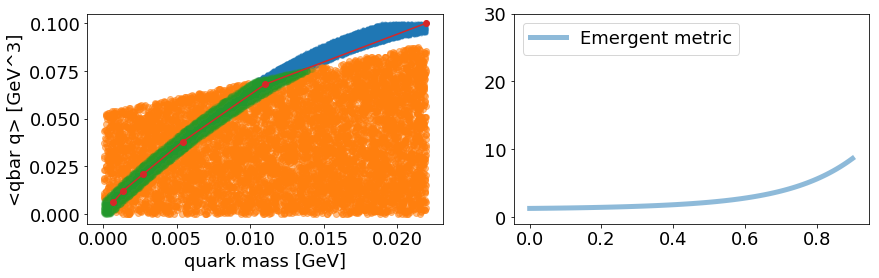

iter 1500 loss 0.412623
L: 1.0813802480697632, lmd: -1.5187852382659912, poly: [2.1115112  2.5144348  1.6448104  1.5882208  2.37047    0.53480315
 1.4594337  0.46845382 1.2511226 ]
name grad
func.lmd tensor([0.0002])
func.L tensor([-0.0023])
func.metric.poly_para tensor([-0.0009, -0.0010, -0.0012, -0.0013, -0.0014, -0.0011,  0.0002,  0.0054,
         0.0337])


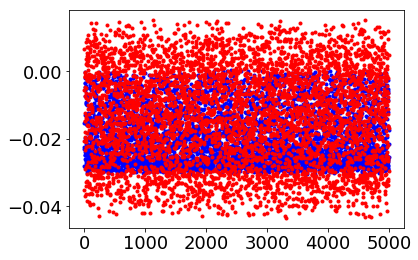

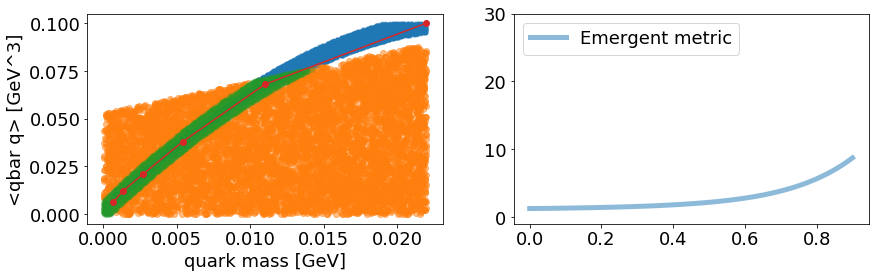

iter 1550 loss 0.410240
L: 1.0920729637145996, lmd: -1.5959848165512085, poly: [2.1495852 2.5508144 1.6789285 1.6192318 2.397085  0.5550433 1.4703805
 0.466422  1.233123 ]
name grad
func.lmd tensor([0.0002])
func.L tensor([-0.0094])
func.metric.poly_para tensor([-0.0010, -0.0012, -0.0014, -0.0017, -0.0019, -0.0019, -0.0011,  0.0030,
         0.0270])


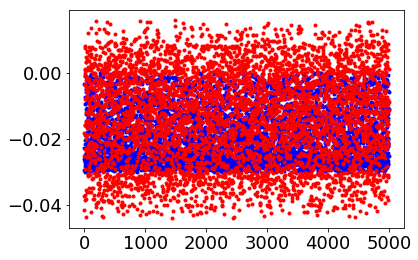

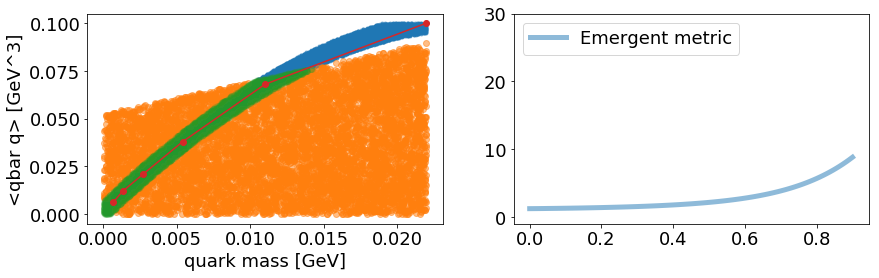

iter 1600 loss 0.411864
L: 1.1034064292907715, lmd: -1.6748629808425903, poly: [2.1883786  2.587918   1.7137673  1.6509442  2.4243493  0.5758141
 1.4816254  0.46432397 1.2147096 ]
name grad
func.lmd tensor([0.0002])
func.L tensor([0.0039])
func.metric.poly_para tensor([-0.0007, -0.0008, -0.0009, -0.0009, -0.0008, -0.0002,  0.0017,  0.0085,
         0.0425])


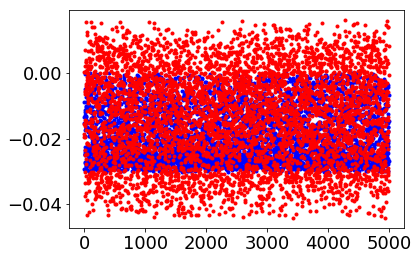

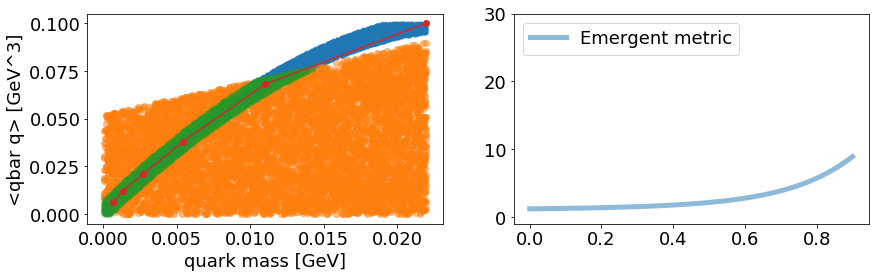

iter 1650 loss 0.408664
L: 1.1160874366760254, lmd: -1.754859209060669, poly: [2.2283444  2.626239   1.7498752  1.6839767  2.4529705  0.59793663
 1.4941224  0.46324196 1.1970323 ]
name grad
func.lmd tensor([0.0003])
func.L tensor([0.0370])
func.metric.poly_para tensor([-8.2190e-05,  2.9309e-05,  2.5589e-04,  7.1228e-04,  1.6556e-03,
         3.7247e-03,  8.7633e-03,  2.3536e-02,  8.8099e-02])


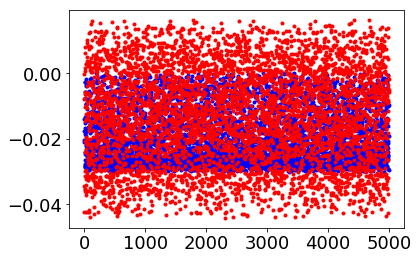

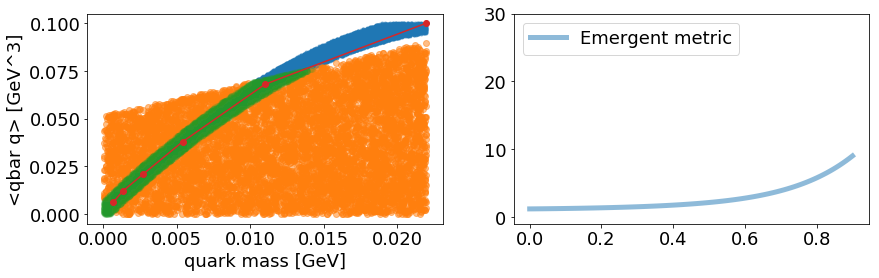

iter 1700 loss 0.408137
L: 1.1290721893310547, lmd: -1.8374322652816772, poly: [2.2687736  2.6649957  1.7863743  1.7173289  2.4817905  0.6200525
 1.506273   0.46134526 1.178142  ]
name grad
func.lmd tensor([0.0003])
func.L tensor([-0.0052])
func.metric.poly_para tensor([-0.0009, -0.0011, -0.0013, -0.0014, -0.0015, -0.0012,  0.0002,  0.0060,
         0.0368])


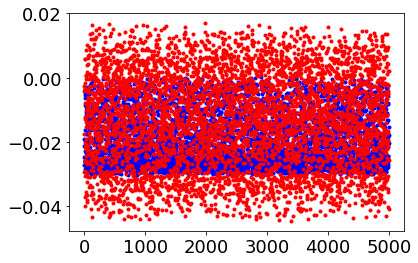

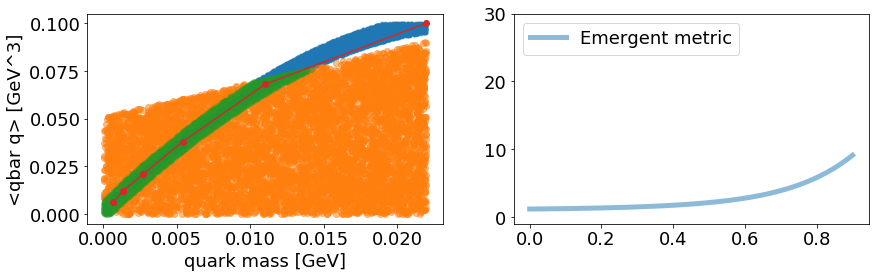

iter 1750 loss 0.408828
L: 1.142804503440857, lmd: -1.9228354692459106, poly: [2.3101087  2.7046428  1.8237314  1.7514814  2.511303   0.642656
 1.5185441  0.45901915 1.1583055 ]
name grad
func.lmd tensor([0.0003])
func.L tensor([0.0020])
func.metric.poly_para tensor([-0.0008, -0.0009, -0.0009, -0.0010, -0.0008, -0.0002,  0.0020,  0.0096,
         0.0470])


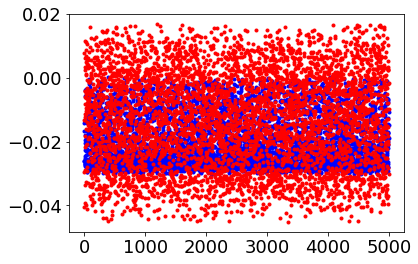

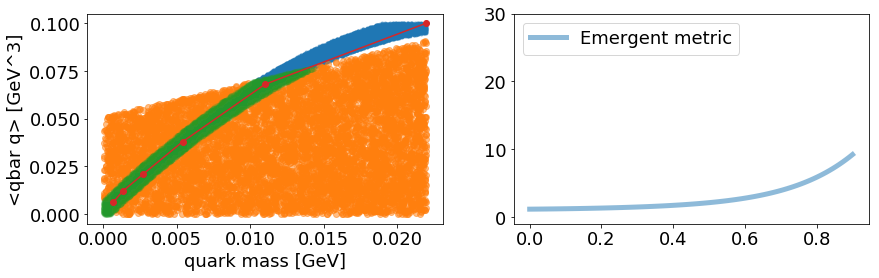

iter 1800 loss 0.408834
L: 1.1578885316848755, lmd: -2.00991153717041, poly: [2.3526158  2.7454972  1.8623313  1.7869047  2.5420876  0.66646284
 1.5318003  0.4572554  1.1385776 ]
name grad
func.lmd tensor([0.0004])
func.L tensor([0.0380])
func.metric.poly_para tensor([5.1114e-06, 1.5900e-04, 4.5468e-04, 1.0294e-03, 2.1884e-03, 4.6854e-03,
        1.0683e-02, 2.8063e-02, 1.0312e-01])


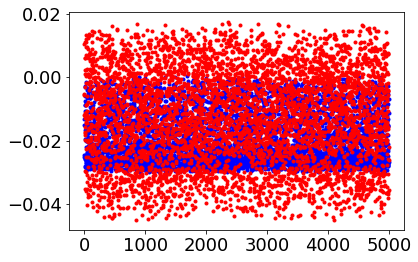

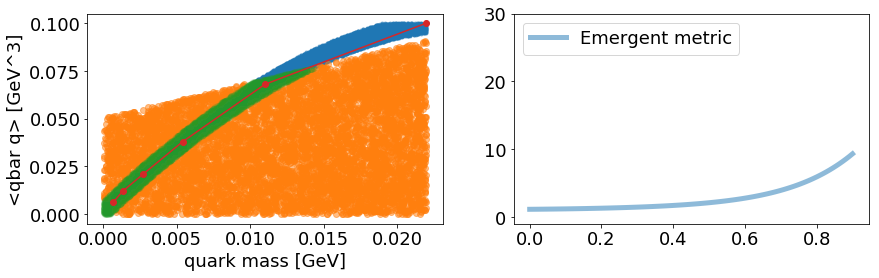

iter 1850 loss 0.409275
L: 1.1739416122436523, lmd: -2.0994582176208496, poly: [2.3959162  2.7871468  1.9017205  1.8230915  2.573571   0.6908168
 1.5452974  0.45524797 1.1181723 ]
name grad
func.lmd tensor([0.0003])
func.L tensor([-0.0137])
func.metric.poly_para tensor([-0.0011, -0.0013, -0.0016, -0.0018, -0.0020, -0.0019, -0.0010,  0.0038,
         0.0310])


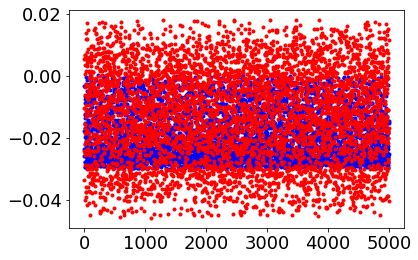

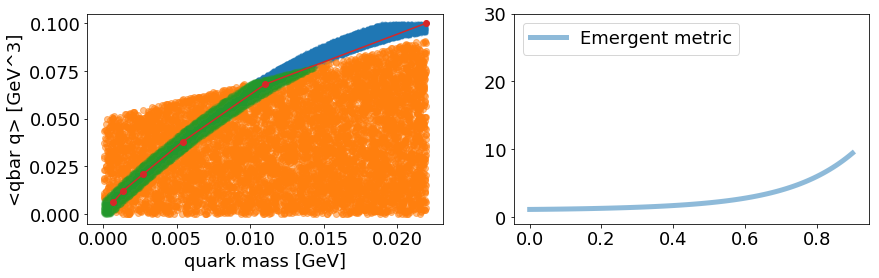

iter 1900 loss 0.404003
L: 1.191567301750183, lmd: -2.191842555999756, poly: [2.4406345  2.8302217  1.9425349  1.8606869  2.606407   0.7163911
 1.5597351  0.45372865 1.0978025 ]
name grad
func.lmd tensor([0.0005])
func.L tensor([0.0259])
func.metric.poly_para tensor([-2.5951e-04, -1.7014e-04,  3.9855e-05,  4.9787e-04,  1.4928e-03,
         3.7490e-03,  9.3708e-03,  2.6105e-02,  9.9771e-02])


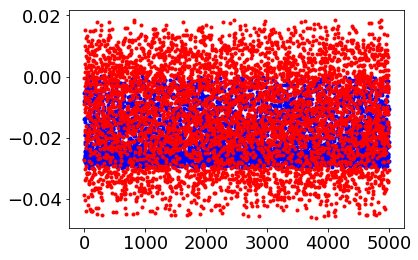

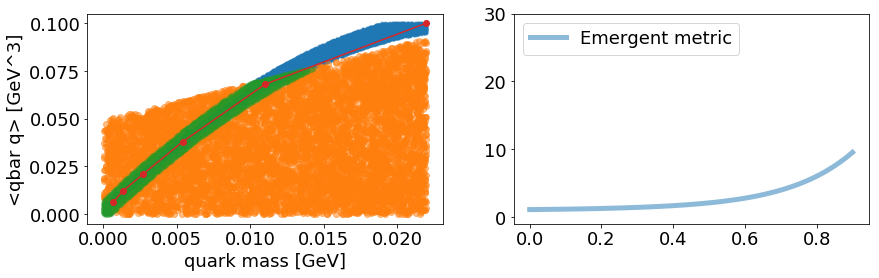

iter 1950 loss 0.402677
L: 1.209490418434143, lmd: -2.2861881256103516, poly: [2.4847982  2.8726864  1.9826652  1.8974978  2.6383252  0.7408861
 1.5729641  0.45106584 1.0766898 ]
name grad
func.lmd tensor([0.0003])
func.L tensor([-0.0657])
func.metric.poly_para tensor([-0.0023, -0.0029, -0.0037, -0.0049, -0.0066, -0.0093, -0.0140, -0.0236,
        -0.0510])


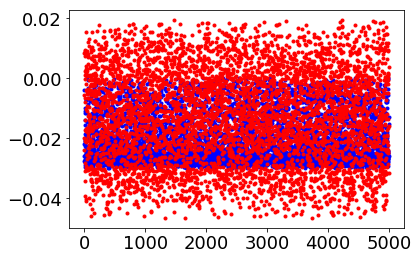

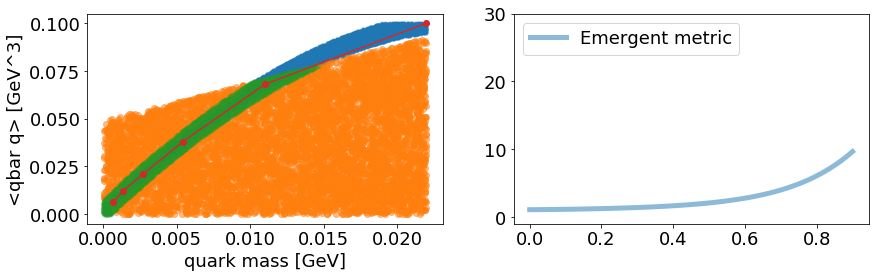

iter 2000 loss 0.404562
L: 1.2297979593276978, lmd: -2.3836050033569336, poly: [2.5310342 2.9172478 2.0249147 1.9364357 2.672343  0.7673674 1.5878962
 0.4496031 1.056213 ]
name grad
func.lmd tensor([0.0005])
func.L tensor([-0.0179])
func.metric.poly_para tensor([-0.0012, -0.0014, -0.0017, -0.0019, -0.0021, -0.0021, -0.0010,  0.0042,
         0.0336])


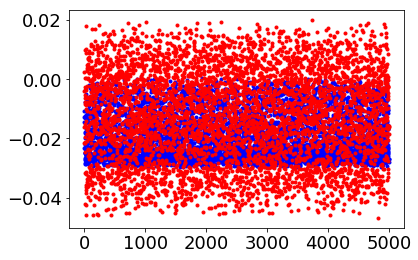

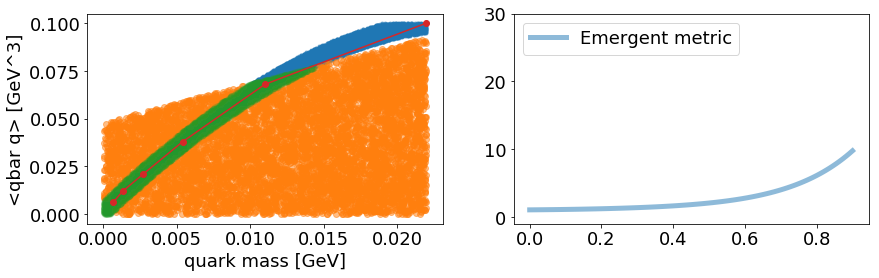

iter 2050 loss 0.401980
L: 1.251367449760437, lmd: -2.484409809112549, poly: [2.5779471  2.9624364  2.0677183  1.9758184  2.70663    0.79384035
 1.6024072  0.44724044 1.0345557 ]
name grad
func.lmd tensor([0.0005])
func.L tensor([-0.0263])
func.metric.poly_para tensor([-0.0014, -0.0017, -0.0020, -0.0024, -0.0028, -0.0032, -0.0030,  0.0001,
         0.0214])


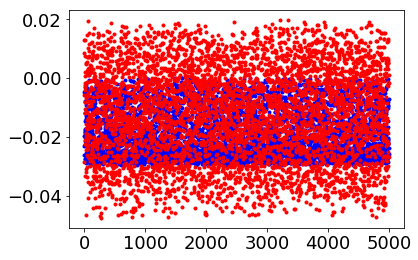

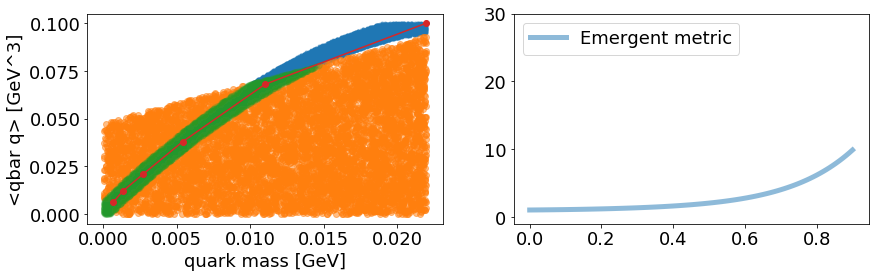

iter 2100 loss 0.397364
L: 1.274937629699707, lmd: -2.5877199172973633, poly: [2.6258569 3.0086117 2.111487  2.0161233 2.7417622 0.8210242 1.6174324
 0.4452055 1.013183 ]
name grad
func.lmd tensor([0.0006])
func.L tensor([-0.0464])
func.metric.poly_para tensor([-0.0019, -0.0024, -0.0030, -0.0038, -0.0048, -0.0063, -0.0085, -0.0115,
        -0.0130])


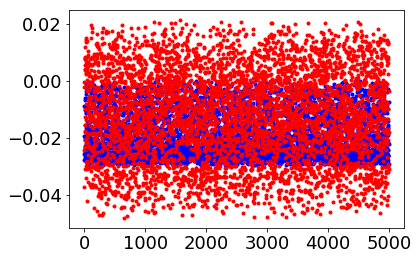

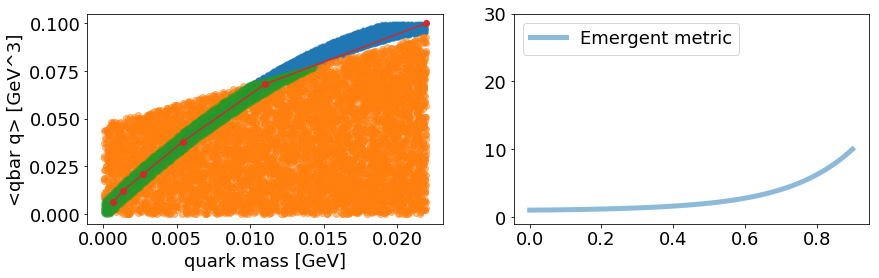

iter 2150 loss 0.395167
L: 1.3011339902877808, lmd: -2.694951295852661, poly: [2.6755903  3.0565856  2.1570082  2.0581     2.7784193  0.8494639
 1.6332606  0.4433646  0.99148536]
name grad
func.lmd tensor([0.0006])
func.L tensor([-0.0692])
func.metric.poly_para tensor([-0.0026, -0.0032, -0.0041, -0.0054, -0.0073, -0.0104, -0.0156, -0.0265,
        -0.0580])


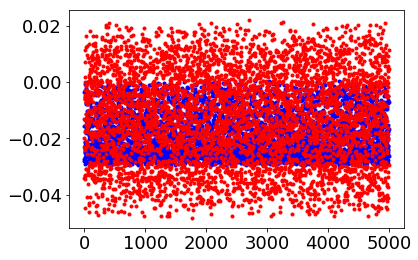

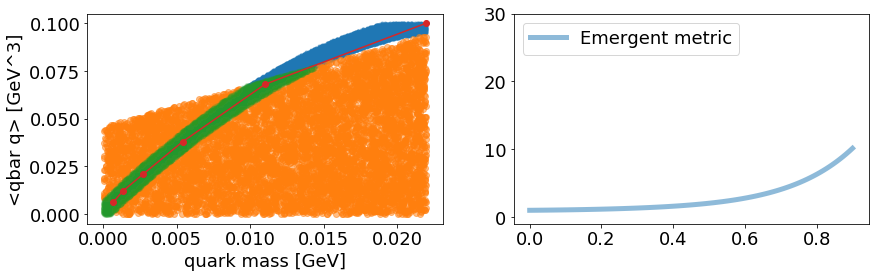

iter 2200 loss 0.390511
L: 1.330232858657837, lmd: -2.8060359954833984, poly: [2.7270024  3.1061943  2.204098   2.1015372  2.81636    0.8789061
 1.6496878  0.44169152 0.969684  ]
name grad
func.lmd tensor([0.0009])
func.L tensor([2.9899e-05])
func.metric.poly_para tensor([-5.7967e-04, -5.5549e-04, -4.2409e-04, -5.8111e-05,  8.3779e-04,
         3.0165e-03,  8.6904e-03,  2.6054e-02,  1.0353e-01])


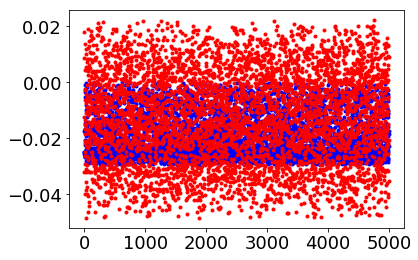

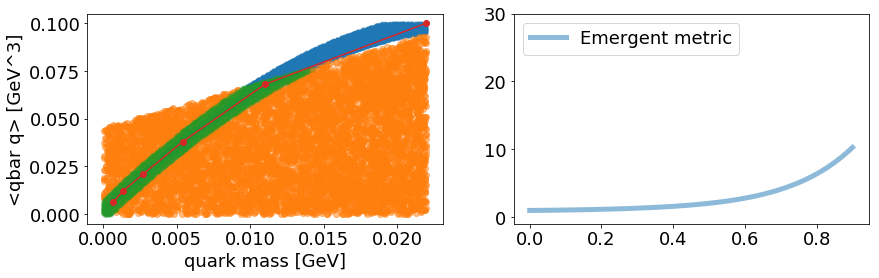

iter 2250 loss 0.388771
L: 1.3621450662612915, lmd: -2.919649124145508, poly: [2.7797327 3.1570268 2.2522762 2.1458678 2.8549097 0.9085613 1.6658565
 0.4394014 0.9472035]
name grad
func.lmd tensor([0.0012])
func.L tensor([-0.0087])
func.metric.poly_para tensor([-0.0008, -0.0008, -0.0007, -0.0004,  0.0004,  0.0025,  0.0081,  0.0257,
         0.1051])


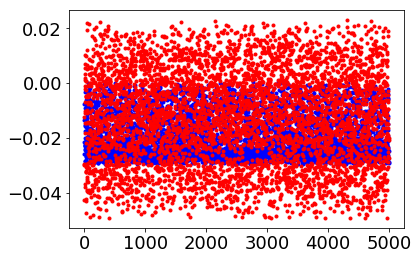

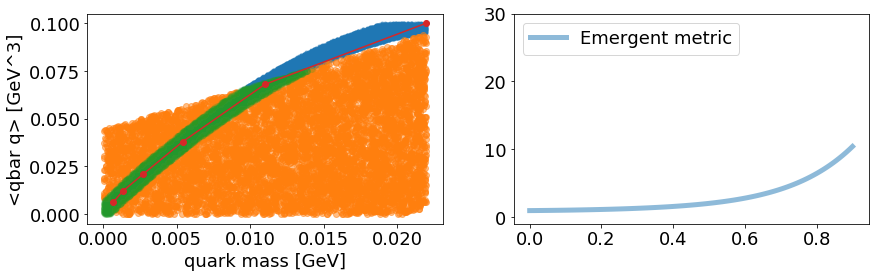

iter 2300 loss 0.388196
L: 1.3980876207351685, lmd: -3.0386650562286377, poly: [2.8347614  3.2100422  2.3024707  2.1919649  2.8948402  0.93900007
 1.6819506  0.43605664 0.92296004]
name grad
func.lmd tensor([0.0013])
func.L tensor([-0.0147])
func.metric.poly_para tensor([-0.0008, -0.0009, -0.0008, -0.0006,  0.0002,  0.0022,  0.0077,  0.0251,
         0.1035])


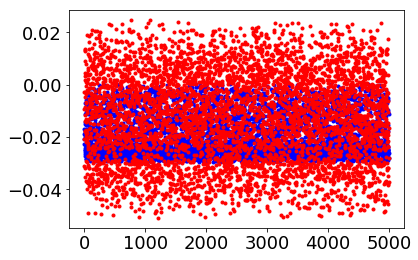

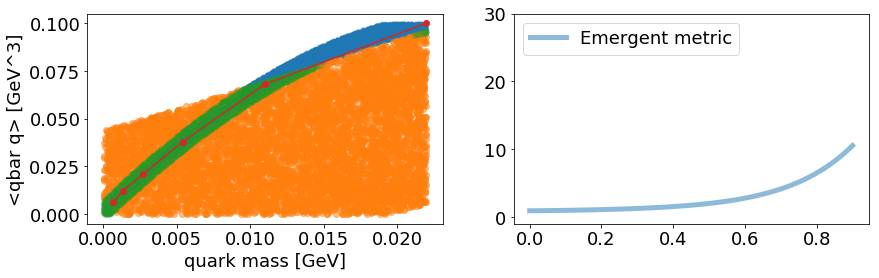

iter 2350 loss 0.397821
L: 1.4399363994598389, lmd: -3.1616103649139404, poly: [2.8937101  3.266916   2.3564215  2.2416484  2.9380784  0.9723072
 1.7003127  0.4343531  0.89983624]
name grad
func.lmd tensor([0.0016])
func.L tensor([-0.0274])
func.metric.poly_para tensor([-0.0011, -0.0013, -0.0013, -0.0011, -0.0005,  0.0012,  0.0064,  0.0231,
         0.1004])


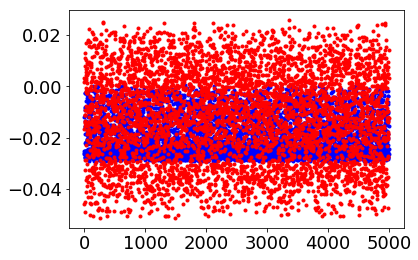

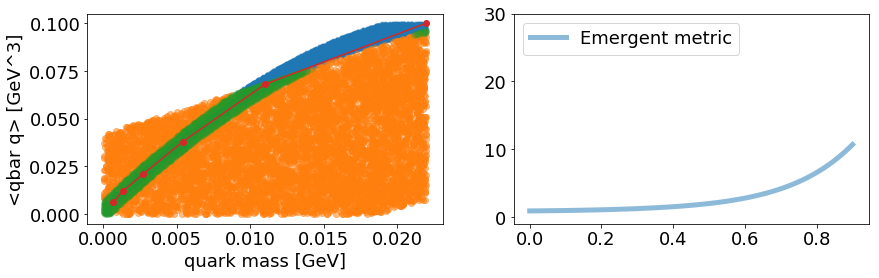

iter 2400 loss 0.376888
L: 1.488303303718567, lmd: -3.2893850803375244, poly: [2.9568     3.3277488  2.4140685  2.2946358  2.9840255  1.0074376
 1.7193012  0.43200156 0.87510616]
name grad
func.lmd tensor([0.0017])
func.L tensor([-0.0666])
func.metric.poly_para tensor([-0.0025, -0.0031, -0.0038, -0.0047, -0.0059, -0.0073, -0.0089, -0.0092,
         0.0032])


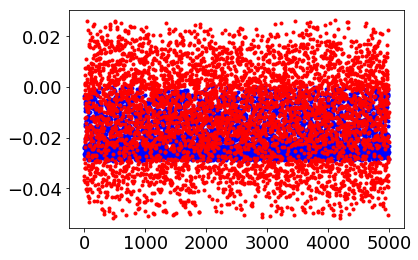

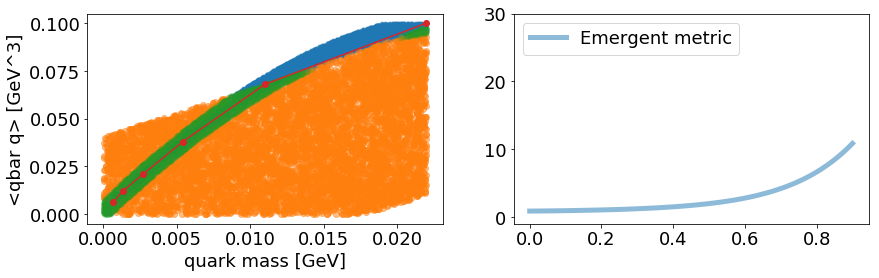

iter 2450 loss 0.370495
L: 1.54572594165802, lmd: -3.4223079681396484, poly: [3.0265512  3.3951535  2.478131   2.3537605  3.035597   1.0472505
 1.7413673  0.43052417 0.8491668 ]
name grad
func.lmd tensor([0.0020])
func.L tensor([-0.0851])
func.metric.poly_para tensor([-0.0032, -0.0040, -0.0050, -0.0064, -0.0082, -0.0108, -0.0146, -0.0200,
        -0.0254])


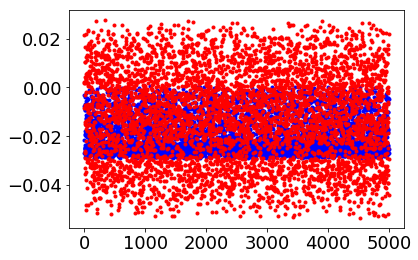

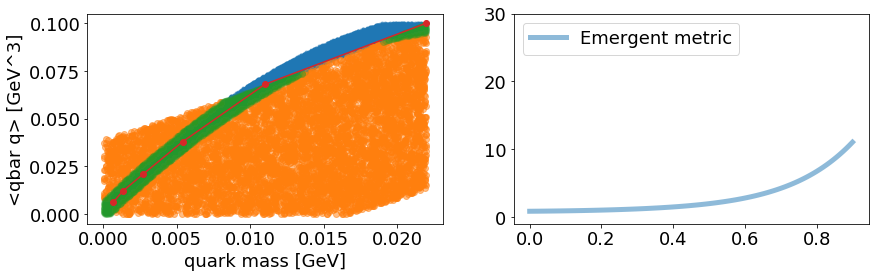

iter 2500 loss 0.366392
L: 1.612413763999939, lmd: -3.5564045906066895, poly: [3.1037407  3.4700115  2.5496223  2.420195   3.0941308  1.0931548
 1.7676674  0.43032345 0.8215571 ]
name grad
func.lmd tensor([0.0019])
func.L tensor([-0.1100])
func.metric.poly_para tensor([-0.0045, -0.0057, -0.0074, -0.0097, -0.0132, -0.0188, -0.0288, -0.0501,
        -0.1153])


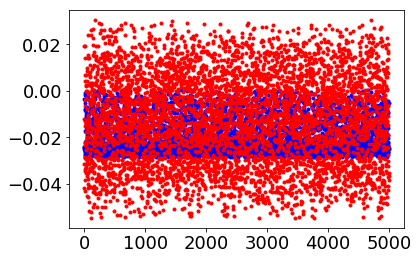

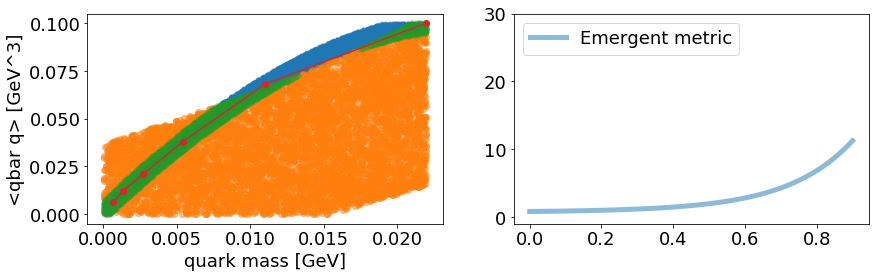

iter 2550 loss 0.353765
L: 1.6843675374984741, lmd: -3.6813113689422607, poly: [3.1859806  3.549994   2.6263058  2.4918473  3.1577938  1.1438365
 1.7979188  0.43278703 0.79530466]
name grad
func.lmd tensor([0.0004])
func.L tensor([-0.1194])
func.metric.poly_para tensor([-0.0062, -0.0080, -0.0106, -0.0146, -0.0208, -0.0316, -0.0527, -0.1032,
        -0.2820])


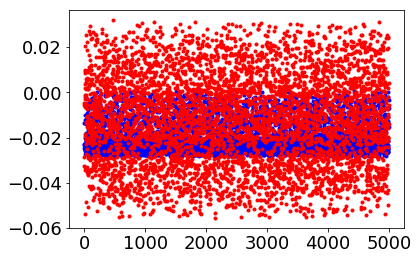

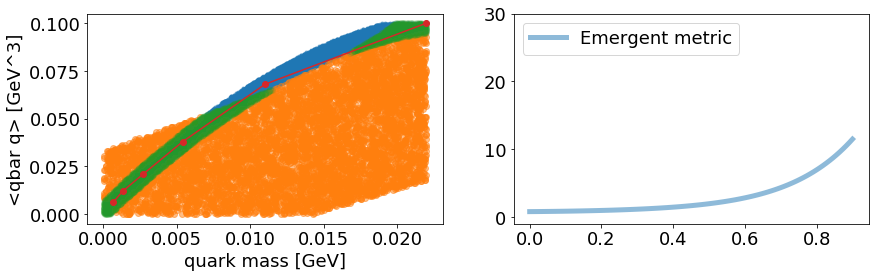

iter 2600 loss 0.345621
L: 1.7490406036376953, lmd: -3.772813320159912, poly: [3.2682571  3.6301901  2.703421   2.5641985  3.22247    1.1958752
 1.8298637  0.43725297 0.7711813 ]
name grad
func.lmd tensor([0.0014])
func.L tensor([-0.0606])
func.metric.poly_para tensor([-0.0031, -0.0037, -0.0045, -0.0053, -0.0062, -0.0067, -0.0057,  0.0025,
         0.0550])


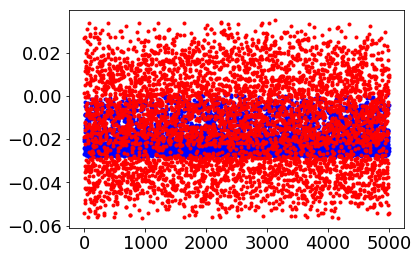

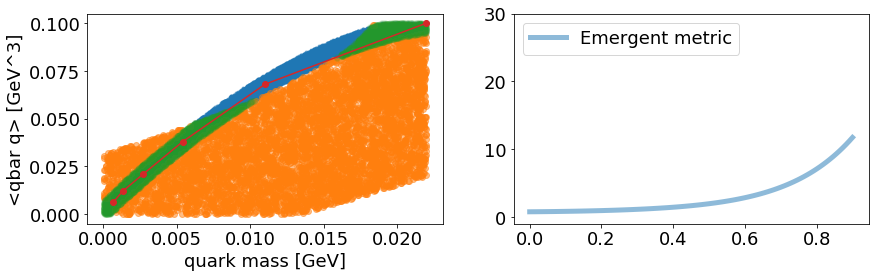

iter 2650 loss 0.340001
L: 1.793348789215088, lmd: -3.8031809329986572, poly: [3.346846   3.70686    2.7772186  2.6335142  3.2845247  1.2459708
 1.8610803  0.44286358 0.74981743]
name grad
func.lmd tensor([0.0004])
func.L tensor([-0.0347])
func.metric.poly_para tensor([-2.7816e-03, -3.2665e-03, -3.7931e-03, -4.2883e-03, -4.5296e-03,
        -3.8454e-03, -1.9124e-05,  1.5886e-02,  1.0011e-01])


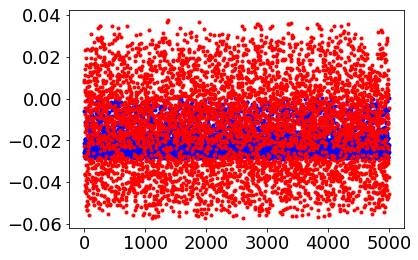

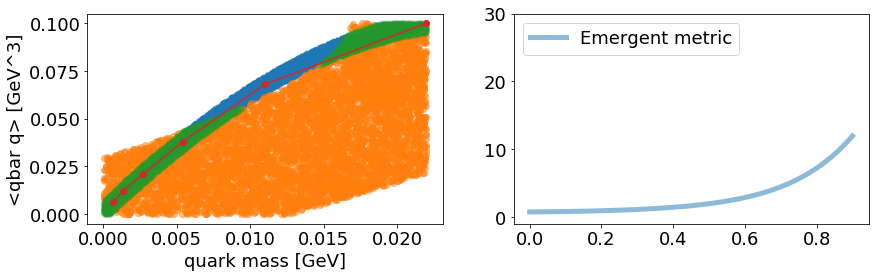

iter 2700 loss 0.339250
L: 1.8133586645126343, lmd: -3.765049695968628, poly: [3.419321   3.7774727  2.8450391  2.6969953  3.3410625  1.291353
 1.8894827  0.44894603 0.7321575 ]
name grad
func.lmd tensor([-0.0032])
func.L tensor([-0.0394])
func.metric.poly_para tensor([-0.0058, -0.0074, -0.0098, -0.0133, -0.0188, -0.0283, -0.0466, -0.0895,
        -0.2362])


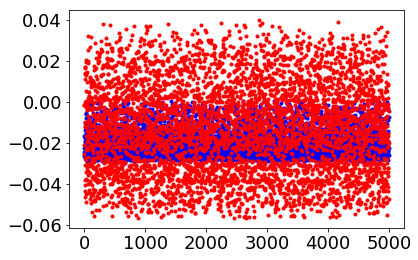

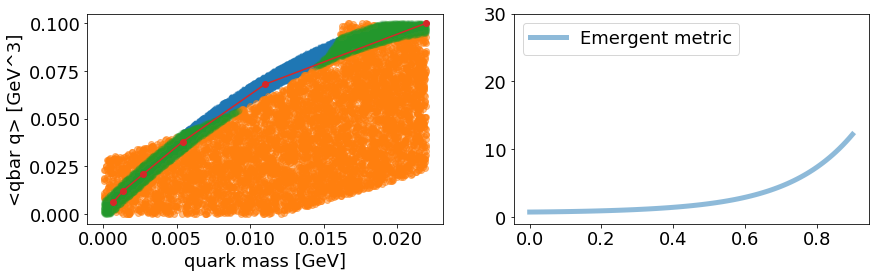

iter 2750 loss 0.340315
L: 1.8223187923431396, lmd: -3.693408727645874, poly: [3.4912548  3.847602   2.9124467  2.7601542  3.3973987  1.336707
 1.9181161  0.45557266 0.715169  ]
name grad
func.lmd tensor([-0.0011])
func.L tensor([0.0029])
func.metric.poly_para tensor([-0.0022, -0.0024, -0.0025, -0.0023, -0.0012,  0.0020,  0.0116,  0.0434,
         0.1932])


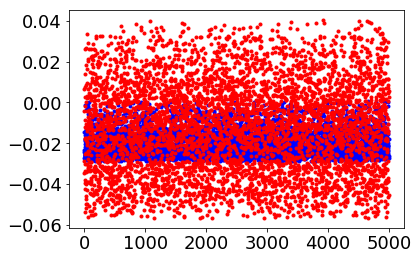

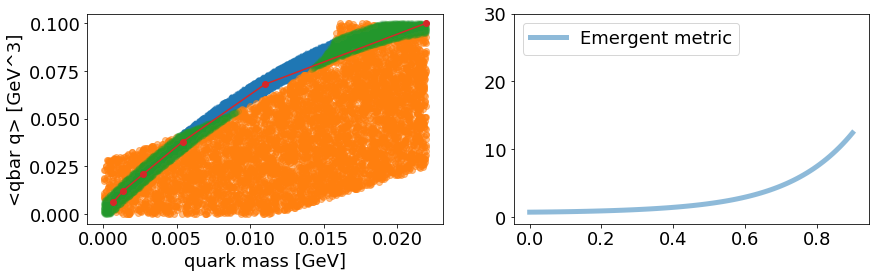

iter 2800 loss 0.331339
L: 1.82465398311615, lmd: -3.607494354248047, poly: [3.5614066 3.9159288 2.978031  2.8214736 3.4519303 1.3804585 1.9457412
 0.4622907 0.6994599]
name grad
func.lmd tensor([-0.0011])
func.L tensor([-0.0043])
func.metric.poly_para tensor([-0.0026, -0.0029, -0.0032, -0.0032, -0.0026, -0.0002,  0.0077,  0.0354,
         0.1700])


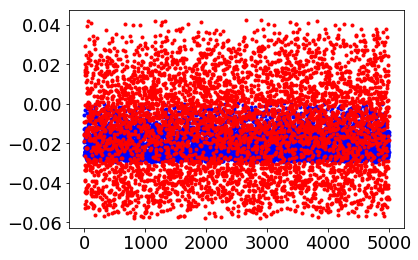

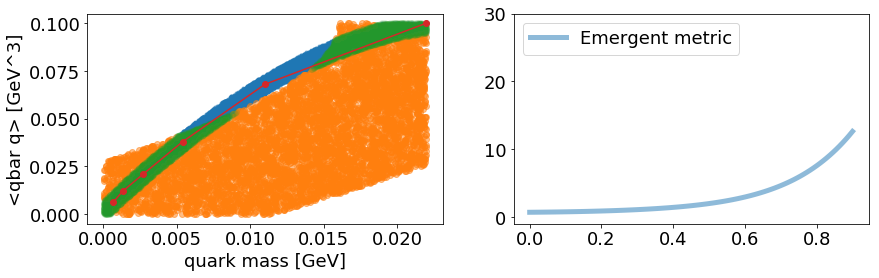

iter 2850 loss 0.334216
L: 1.8260743618011475, lmd: -3.5199778079986572, poly: [3.6319764 3.9846866 3.044058  2.8832462 3.5069046 1.4245756 1.9735093
 0.4687547 0.6830731]
name grad
func.lmd tensor([-0.0042])
func.L tensor([-0.0063])
func.metric.poly_para tensor([-0.0048, -0.0060, -0.0078, -0.0103, -0.0142, -0.0204, -0.0315, -0.0552,
        -0.1254])


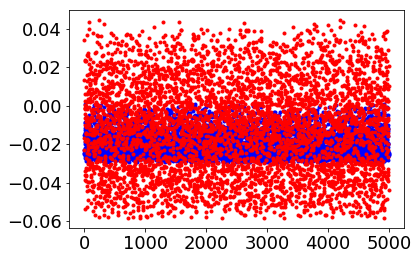

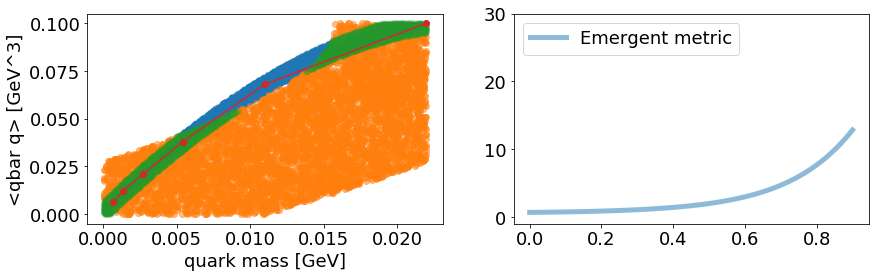

iter 2900 loss 0.325024
L: 1.8264961242675781, lmd: -3.4316844940185547, poly: [3.7026772 4.0535736 3.1102107 2.9451356 3.561975  1.4687567 2.0013013
 0.4752199 0.6667009]
name grad
func.lmd tensor([-0.0045])
func.L tensor([-0.0142])
func.metric.poly_para tensor([-0.0054, -0.0068, -0.0089, -0.0119, -0.0164, -0.0239, -0.0378, -0.0682,
        -0.1638])


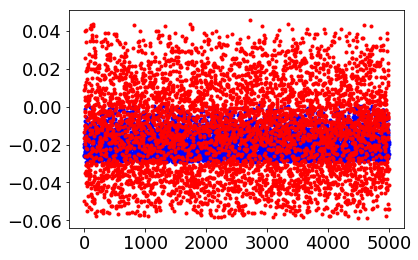

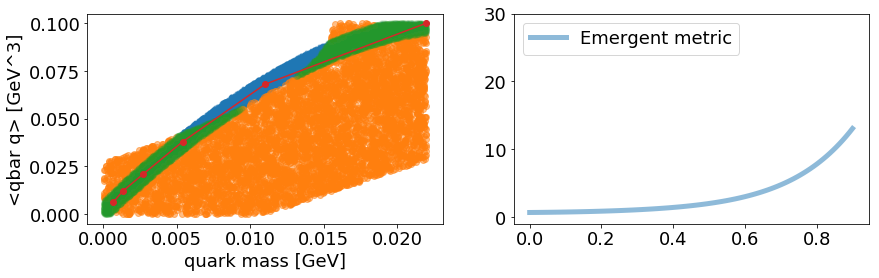

iter 2950 loss 0.317596
L: 1.8264669179916382, lmd: -3.343205451965332, poly: [3.7736495  4.1227236  3.1766114  3.0072496  3.6172495  1.5131617
 2.0294743  0.48242906 0.65150785]
name grad
func.lmd tensor([-0.0040])
func.L tensor([0.0044])
func.metric.poly_para tensor([-0.0043, -0.0053, -0.0065, -0.0080, -0.0099, -0.0120, -0.0137, -0.0108,
         0.0302])


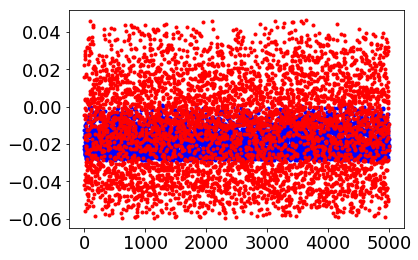

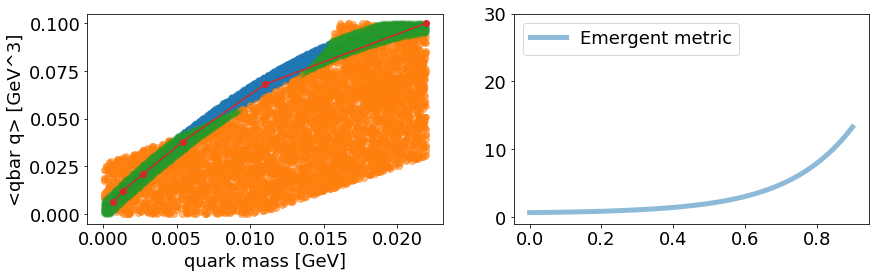

iter 3000 loss 0.318298
L: 1.8260853290557861, lmd: -3.254716157913208, poly: [3.8448658 4.1921787 3.2433984 3.0698516 3.673103  1.5581456 2.0579512
 0.489307  0.6352791]
name grad
func.lmd tensor([-0.0015])
func.L tensor([0.0129])
func.metric.poly_para tensor([-0.0022, -0.0023, -0.0021, -0.0012,  0.0011,  0.0073,  0.0240,  0.0770,
         0.3191])


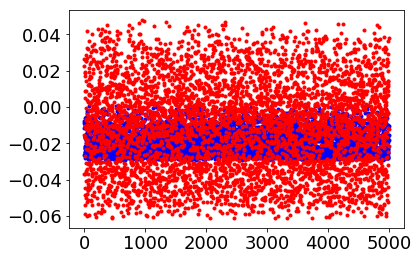

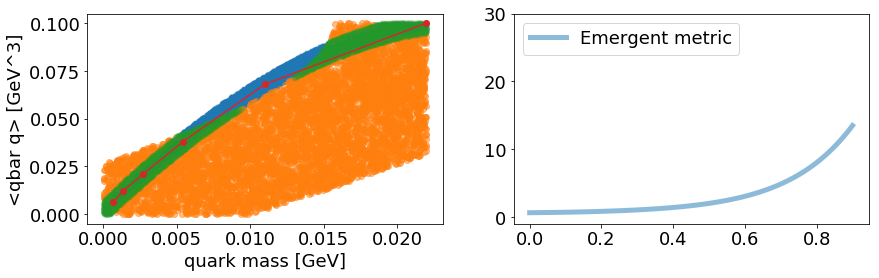

iter 3050 loss 0.310849
L: 1.8275460004806519, lmd: -3.169252872467041, poly: [3.9165335  4.2621317  3.3107445  3.1330862  3.7296658  1.6038566
 2.0870118  0.49640998 0.61889327]
name grad
func.lmd tensor([-0.0054])
func.L tensor([-0.0033])
func.metric.poly_para tensor([-0.0054, -0.0068, -0.0088, -0.0115, -0.0155, -0.0218, -0.0327, -0.0546,
        -0.1126])


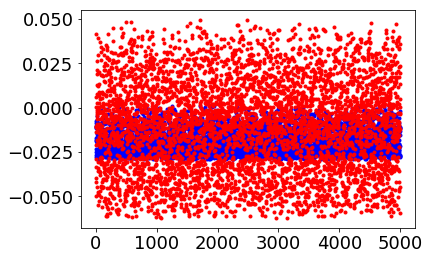

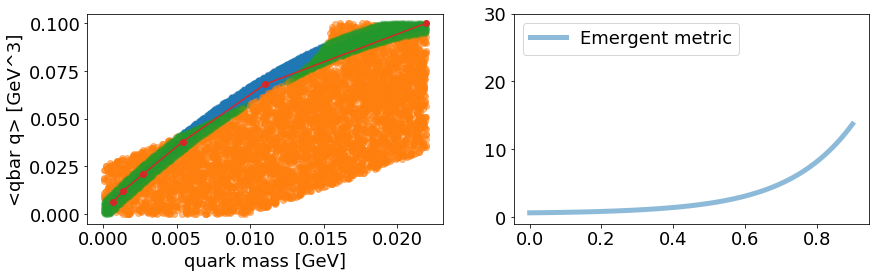

iter 3100 loss 0.310254
L: 1.8275980949401855, lmd: -3.0815532207489014, poly: [3.9882069 4.33217   3.378283  3.1966522 3.7867272 1.6502081 2.1166956
 0.5038506 0.6024575]
name grad
func.lmd tensor([-0.0043])
func.L tensor([-0.0020])
func.metric.poly_para tensor([-0.0047, -0.0057, -0.0071, -0.0088, -0.0110, -0.0138, -0.0166, -0.0164,
         0.0154])


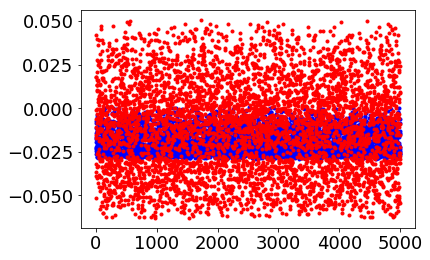

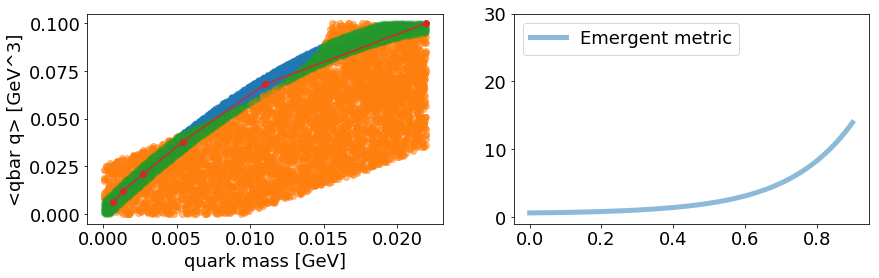

iter 3150 loss 0.306930
L: 1.827749252319336, lmd: -2.9948883056640625, poly: [4.059264   4.401627   3.4452853  3.259748   3.843409   1.6963221
 2.1463666  0.5116112  0.58673936]
name grad
func.lmd tensor([-0.0045])
func.L tensor([-0.0086])
func.metric.poly_para tensor([-0.0050, -0.0062, -0.0078, -0.0099, -0.0127, -0.0167, -0.0222, -0.0292,
        -0.0264])


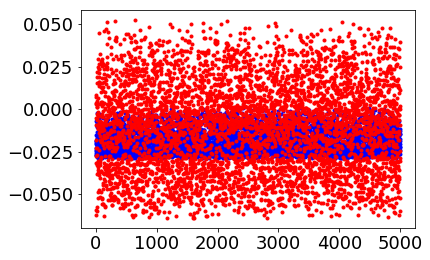

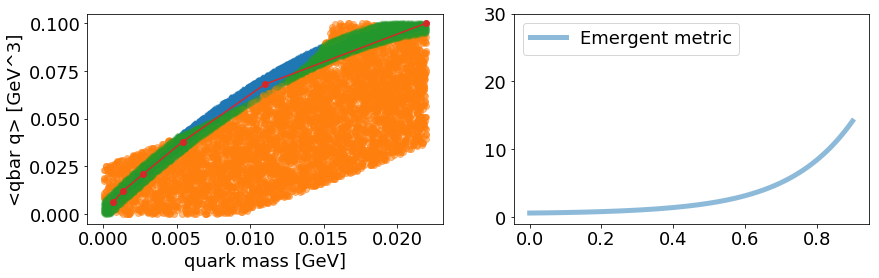

iter 3200 loss 0.295651
L: 1.8278535604476929, lmd: -2.9084482192993164, poly: [4.1299105 4.470734  3.5120213 3.3226879 3.9000843 1.7426093 2.1764004
 0.519908  0.5717348]
name grad
func.lmd tensor([-0.0030])
func.L tensor([0.0163])
func.metric.poly_para tensor([-0.0030, -0.0033, -0.0034, -0.0030, -0.0012,  0.0041,  0.0195,  0.0703,
         0.3099])


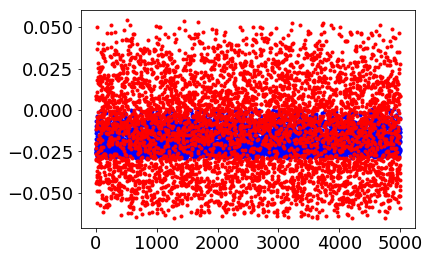

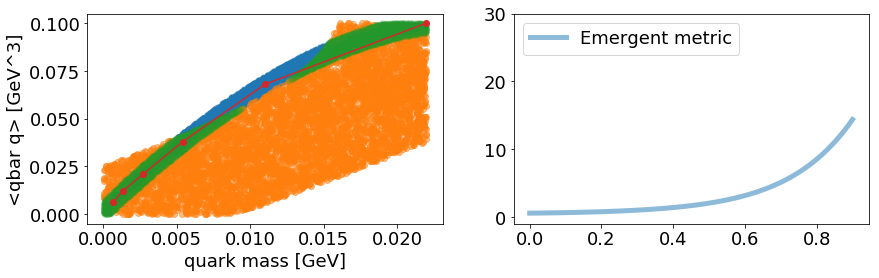

iter 3250 loss 0.295708
L: 1.8278309106826782, lmd: -2.8247523307800293, poly: [4.198549   4.537757   3.5765712  3.3833144  3.954305   1.7863535
 2.2040365  0.52639806 0.5558662 ]
name grad
func.lmd tensor([-0.0055])
func.L tensor([-0.0231])
func.metric.poly_para tensor([-0.0065, -0.0081, -0.0104, -0.0135, -0.0182, -0.0254, -0.0377, -0.0619,
        -0.1242])


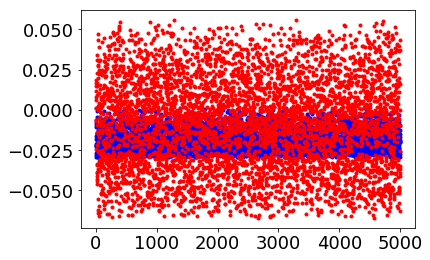

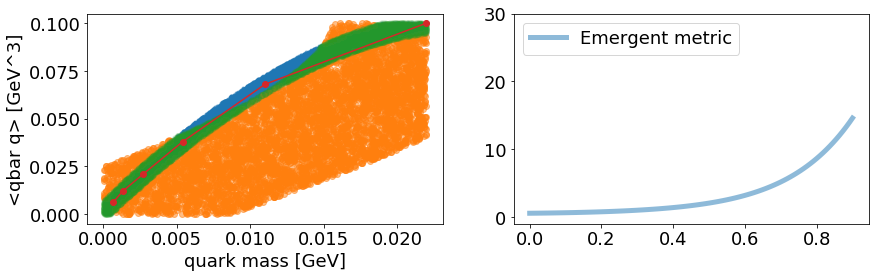

iter 3300 loss 0.292177
L: 1.8285636901855469, lmd: -2.7412283420562744, poly: [4.267178   4.604921   3.641473   3.4445755  4.009519   1.8314615
 2.233209   0.53417945 0.5408299 ]
name grad
func.lmd tensor([-0.0023])
func.L tensor([0.0303])
func.metric.poly_para tensor([-0.0019, -0.0017, -0.0010,  0.0007,  0.0047,  0.0144,  0.0395,  0.1171,
         0.4654])


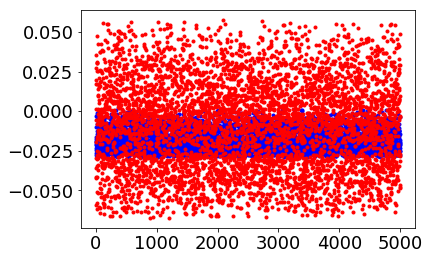

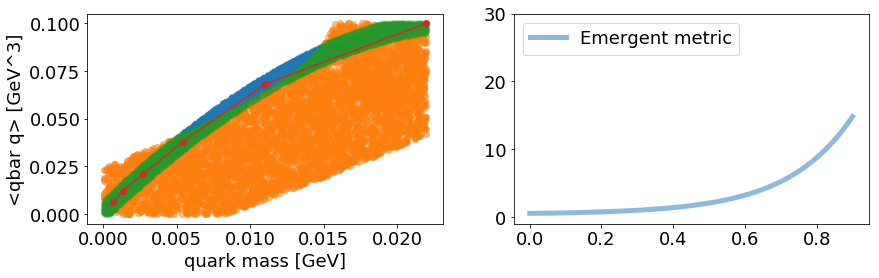

iter 3350 loss 0.292817
L: 1.8302663564682007, lmd: -2.6597235202789307, poly: [4.334888   4.6712136  3.7055695  3.5051286  4.0641522  1.8761157
 2.2619493  0.5413788  0.52508307]
name grad
func.lmd tensor([-0.0063])
func.L tensor([-0.0233])
func.metric.poly_para tensor([-0.0065, -0.0083, -0.0108, -0.0144, -0.0199, -0.0291, -0.0461, -0.0842,
        -0.2059])


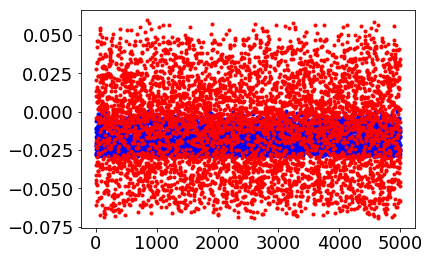

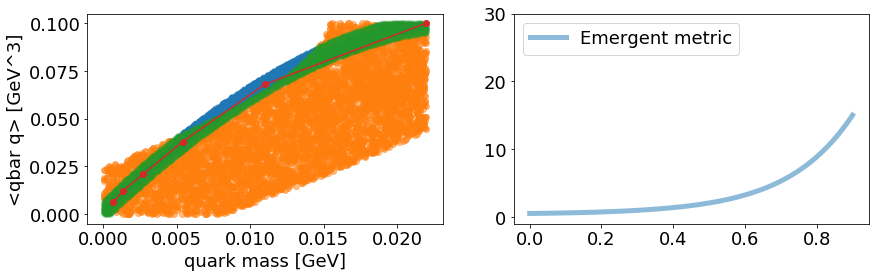

iter 3400 loss 0.283911
L: 1.8315346240997314, lmd: -2.5771591663360596, poly: [4.4023757  4.737384   3.7696788  3.56588    4.119229   1.9214796
 2.291562   0.54936206 0.5099134 ]
name grad
func.lmd tensor([-0.0042])
func.L tensor([0.0201])
func.metric.poly_para tensor([-0.0033, -0.0037, -0.0039, -0.0037, -0.0022,  0.0026,  0.0171,  0.0662,
         0.3016])


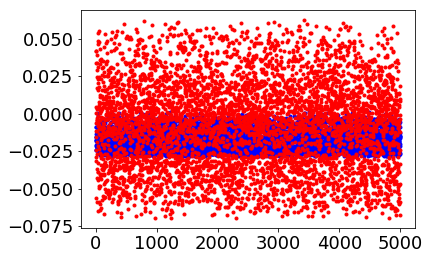

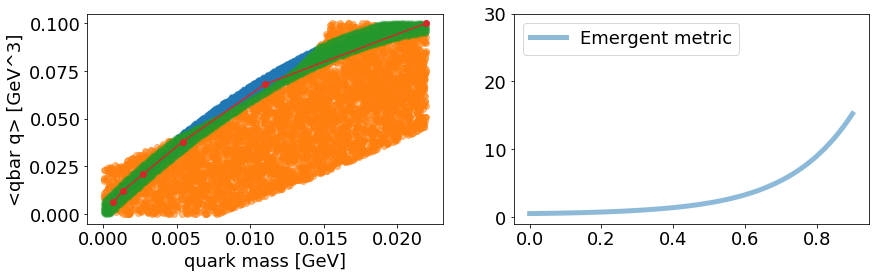

iter 3450 loss 0.272938
L: 1.832577109336853, lmd: -2.49460506439209, poly: [4.469166   4.802908   3.8332186  3.6261668  4.173985   1.9666977
 2.3211827  0.55743676 0.4949214 ]
name grad
func.lmd tensor([-0.0051])
func.L tensor([-0.0015])
func.metric.poly_para tensor([-0.0048, -0.0058, -0.0069, -0.0083, -0.0097, -0.0106, -0.0088,  0.0054,
         0.0989])


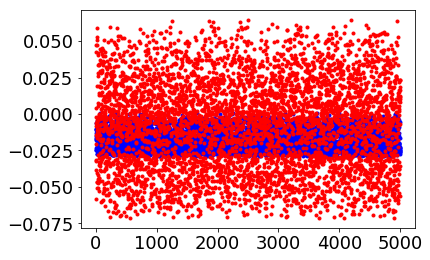

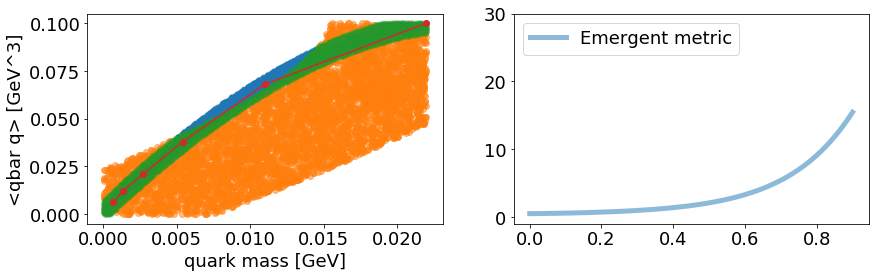

iter 3500 loss 0.271938
L: 1.8323233127593994, lmd: -2.4100182056427, poly: [4.5361223  4.868624   3.896984   3.6867237  4.2290535  2.012233
 2.3509817  0.5653436  0.47940513]
name grad
func.lmd tensor([-0.0077])
func.L tensor([-0.0187])
func.metric.poly_para tensor([-0.0069, -0.0087, -0.0113, -0.0150, -0.0207, -0.0301, -0.0473, -0.0853,
        -0.2048])


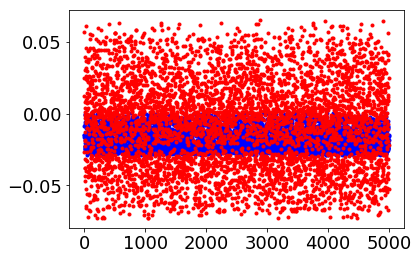

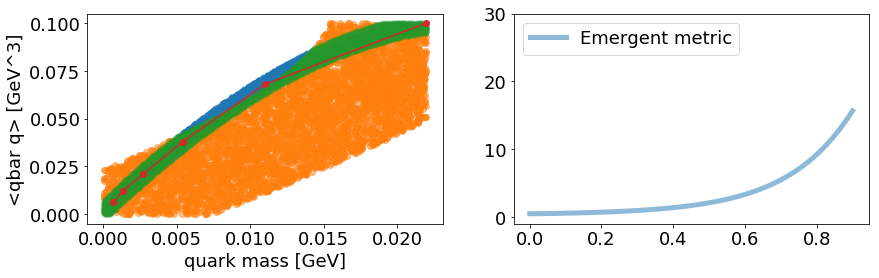

iter 3550 loss 0.264880
L: 1.8353044986724854, lmd: -2.3280131816864014, poly: [4.603063  4.9343157 3.9607034 3.7471998 4.2839885 2.0575848 2.3806453
 0.5734156 0.46454  ]
name grad
func.lmd tensor([-0.0103])
func.L tensor([-0.0311])
func.metric.poly_para tensor([-0.0087, -0.0113, -0.0150, -0.0207, -0.0298, -0.0459, -0.0781, -0.1567,
        -0.4405])


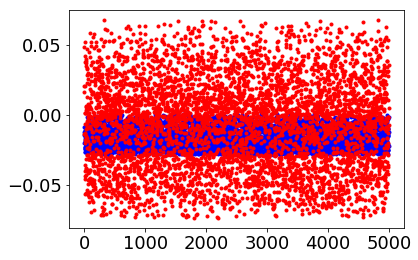

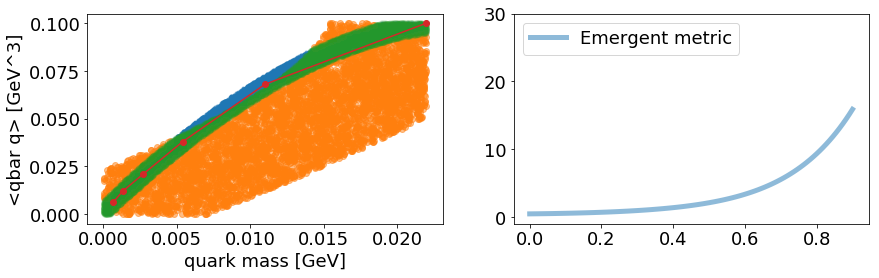

iter 3600 loss 0.264559
L: 1.8383651971817017, lmd: -2.2449517250061035, poly: [4.6700773  5.0000796  4.0244927  3.8077376  4.3389664  2.1029317
 2.4102302  0.5813472  0.44955137]
name grad
func.lmd tensor([-0.0082])
func.L tensor([-0.0124])
func.metric.poly_para tensor([-0.0066, -0.0084, -0.0107, -0.0140, -0.0189, -0.0267, -0.0402, -0.0674,
        -0.1414])


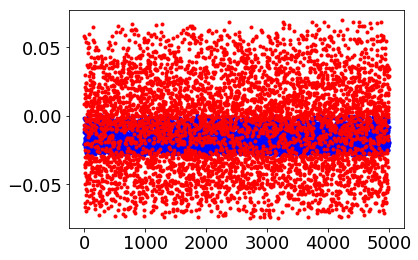

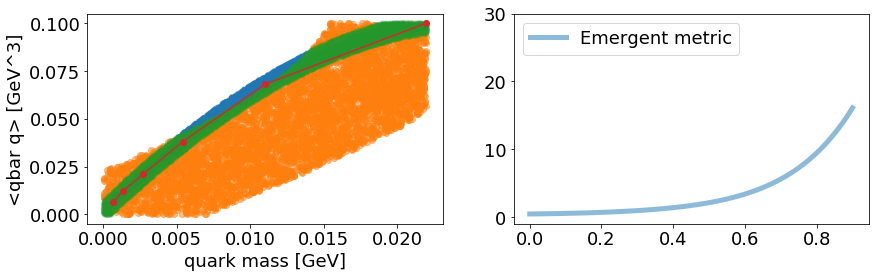

iter 3650 loss 0.262104
L: 1.8409099578857422, lmd: -2.1624386310577393, poly: [4.735672   5.0644436  4.0869136  3.8669598  4.392713   2.1471863
 2.4389586  0.5887989  0.43458357]
name grad
func.lmd tensor([-0.0083])
func.L tensor([-0.0286])
func.metric.poly_para tensor([-0.0075, -0.0095, -0.0122, -0.0162, -0.0222, -0.0319, -0.0495, -0.0873,
        -0.2024])


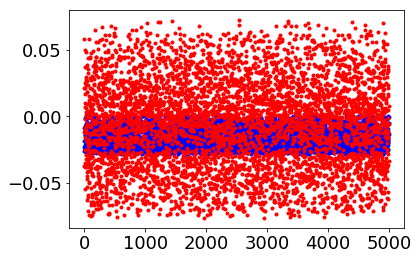

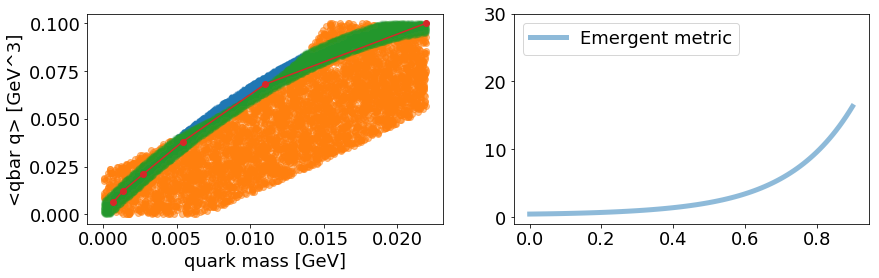

iter 3700 loss 0.251131
L: 1.8469984531402588, lmd: -2.081569194793701, poly: [4.8015327  5.129126   4.1497226  3.9266567  4.4470444  2.1921349
 2.4684246  0.59691894 0.42019957]
name grad
func.lmd tensor([-0.0071])
func.L tensor([0.0038])
func.metric.poly_para tensor([-0.0053, -0.0063, -0.0074, -0.0087, -0.0097, -0.0095, -0.0046,  0.0201,
         0.1632])


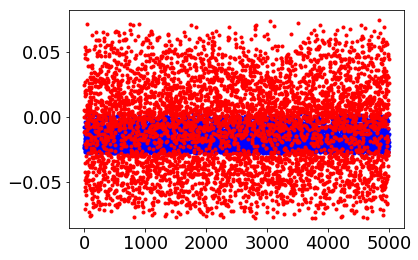

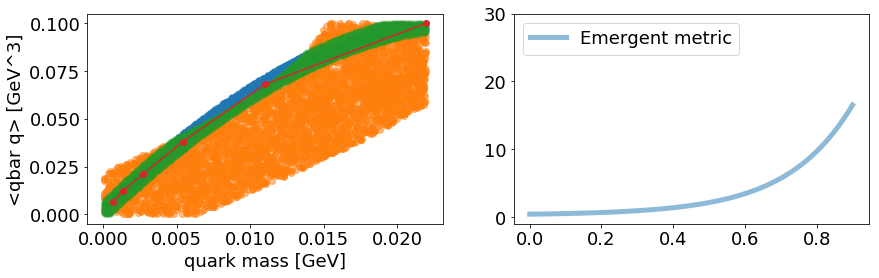

iter 3750 loss 0.250369
L: 1.8512933254241943, lmd: -1.9994314908981323, poly: [4.8661156 5.192607  4.2114477 3.9854472 4.5007234 2.2367604 2.4978693
 0.6051431 0.4059622]
name grad
func.lmd tensor([-0.0065])
func.L tensor([0.0108])
func.metric.poly_para tensor([-0.0044, -0.0051, -0.0059, -0.0064, -0.0063, -0.0038,  0.0060,  0.0435,
         0.2374])


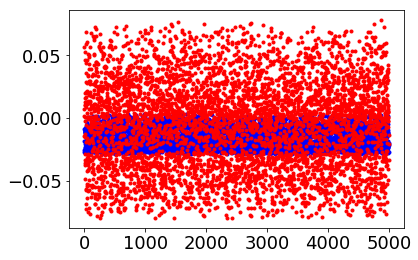

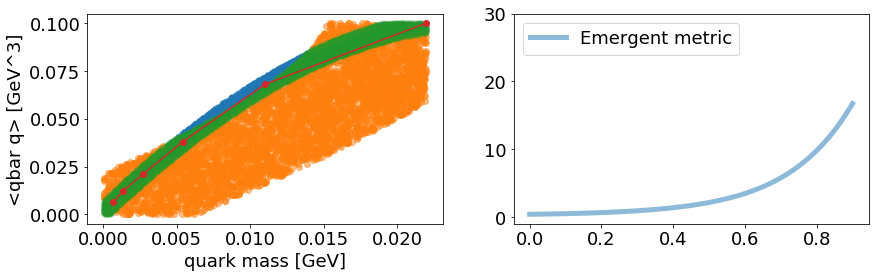

iter 3800 loss 0.241865
L: 1.8562042713165283, lmd: -1.917734980583191, poly: [4.930044   5.255431   4.2725077  4.0435653  4.553715   2.280676
 2.5265803  0.61267394 0.39121774]
name grad
func.lmd tensor([-0.0080])
func.L tensor([-0.0152])
func.metric.poly_para tensor([-0.0063, -0.0077, -0.0097, -0.0123, -0.0159, -0.0209, -0.0279, -0.0369,
        -0.0341])


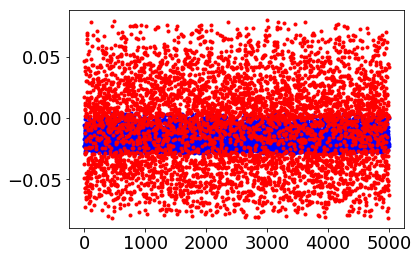

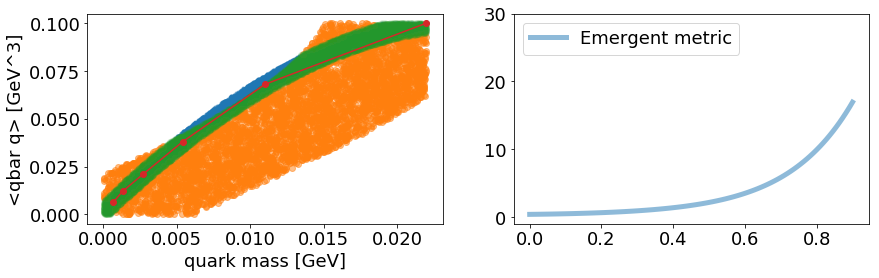

iter 3850 loss 0.237872
L: 1.8625333309173584, lmd: -1.8365281820297241, poly: [4.993408   5.317737   4.333118   4.101327   4.606486   2.3245425
 2.5554006  0.6204033  0.37676477]
name grad
func.lmd tensor([-0.0079])
func.L tensor([0.0049])
func.metric.poly_para tensor([-0.0049, -0.0059, -0.0071, -0.0084, -0.0095, -0.0098, -0.0063,  0.0137,
         0.1348])


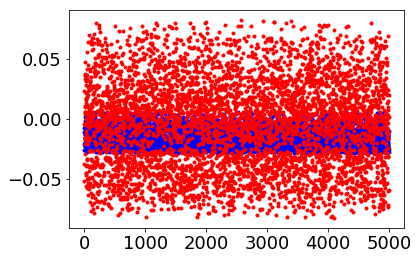

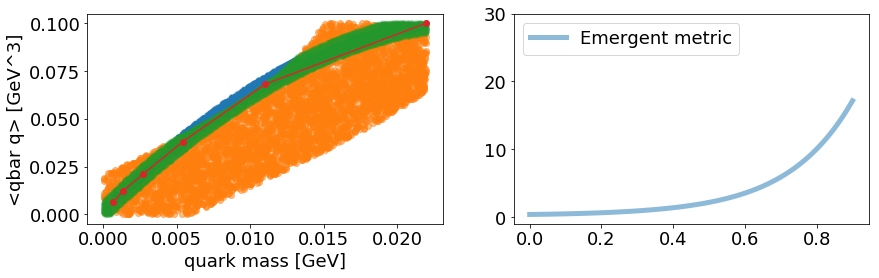

iter 3900 loss 0.230573
L: 1.8683360815048218, lmd: -1.754522442817688, poly: [5.0559654  5.3793144  4.3931155  4.158648   4.6590605  2.3685172
 2.5845587  0.6284244  0.36243287]
name grad
func.lmd tensor([-0.0113])
func.L tensor([-0.0162])
func.metric.poly_para tensor([-0.0072, -0.0091, -0.0119, -0.0159, -0.0222, -0.0328, -0.0528, -0.0987,
        -0.2509])


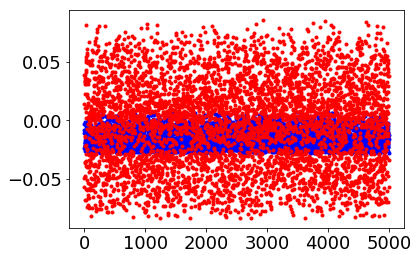

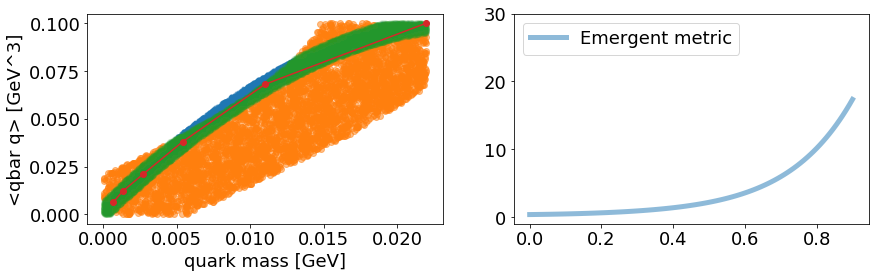

iter 3950 loss 0.222349
L: 1.8776838779449463, lmd: -1.6748911142349243, poly: [5.117913   5.4403043  4.452561   4.2154617  4.7111974  2.412148
 2.6134996  0.63640946 0.348336  ]
name grad
func.lmd tensor([-0.0086])
func.L tensor([-0.0247])
func.metric.poly_para tensor([-0.0067, -0.0083, -0.0104, -0.0133, -0.0172, -0.0226, -0.0304, -0.0408,
        -0.0413])


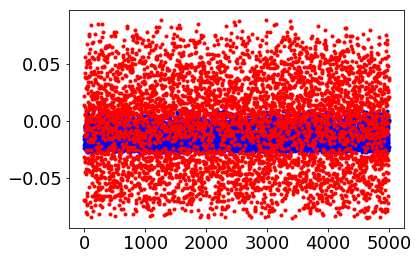

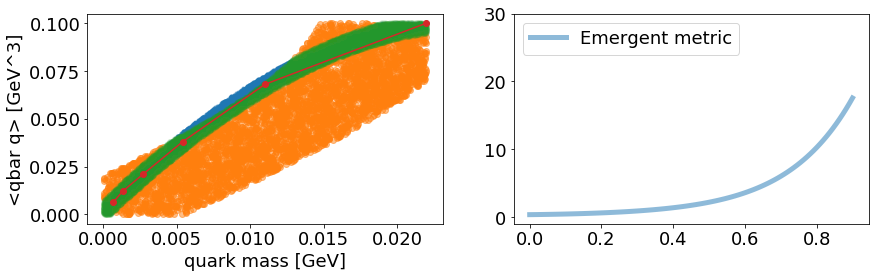

iter 4000 loss 0.221913
L: 1.8903899192810059, lmd: -1.5960230827331543, poly: [5.179802  5.501267  4.512014  4.272339  4.76347   2.4559906 2.6426787
 0.6445785 0.3343923]
name grad
func.lmd tensor([-0.0061])
func.L tensor([0.0272])
func.metric.poly_para tensor([-0.0029, -0.0029, -0.0024, -0.0007,  0.0036,  0.0146,  0.0443,  0.1385,
         0.5725])


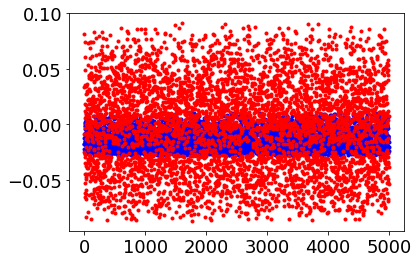

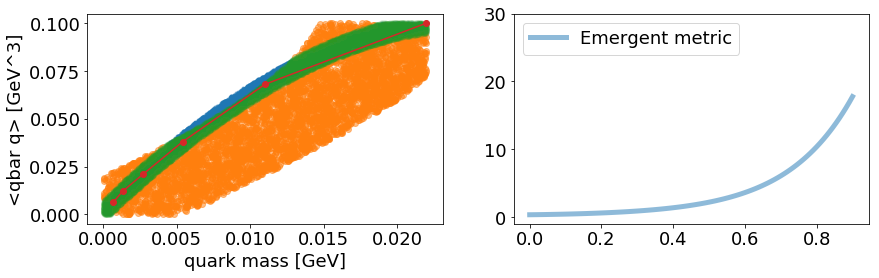

iter 4050 loss 0.213570
L: 1.9057689905166626, lmd: -1.5168086290359497, poly: [5.24227    5.562744   4.5718956  4.329513   4.815828   2.4995847
 2.6711214  0.65148985 0.3188928 ]
name grad
func.lmd tensor([-0.0067])
func.L tensor([0.0067])
func.metric.poly_para tensor([-0.0043, -0.0047, -0.0049, -0.0043, -0.0018,  0.0057,  0.0281,  0.1032,
         0.4619])


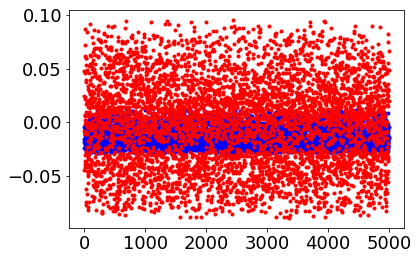

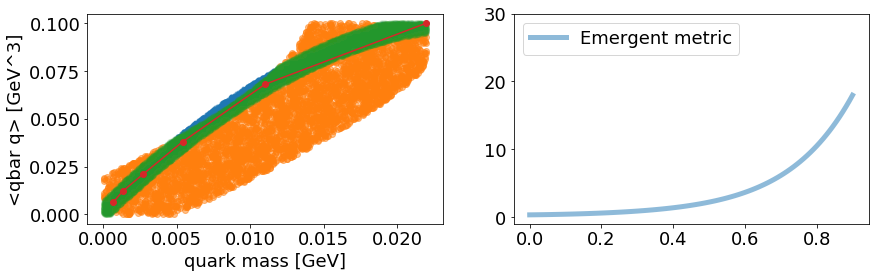

iter 4100 loss 0.204226
L: 1.9308862686157227, lmd: -1.4398410320281982, poly: [5.307116  5.626561  4.6340475 4.388835  4.870109  2.544727  2.7006156
 0.6590451 0.3038187]
name grad
func.lmd tensor([-0.0089])
func.L tensor([-0.0146])
func.metric.poly_para tensor([-0.0060, -0.0072, -0.0086, -0.0102, -0.0117, -0.0122, -0.0082,  0.0155,
         0.1599])


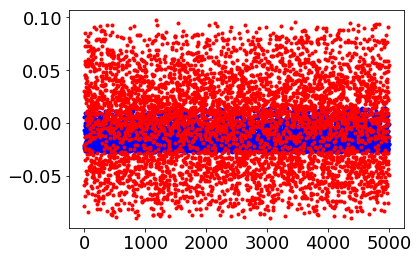

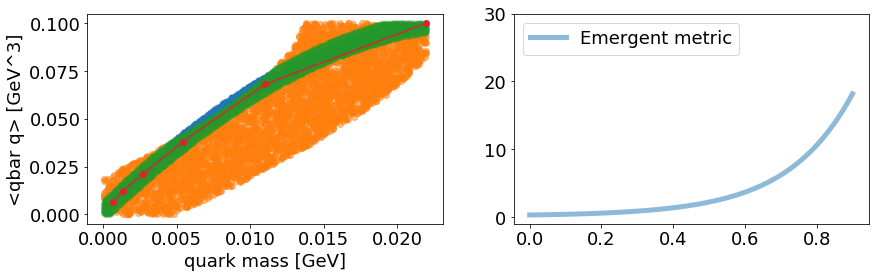

iter 4150 loss 0.196688
L: 1.9695849418640137, lmd: -1.3666906356811523, poly: [5.3751493  5.6934505  4.699095   4.450775   4.9265575  2.5912628
 2.730277   0.6652575  0.28619537]
name grad
func.lmd tensor([-0.0093])
func.L tensor([-0.0288])
func.metric.poly_para tensor([-0.0071, -0.0086, -0.0104, -0.0125, -0.0149, -0.0168, -0.0154,  0.0025,
         0.1285])


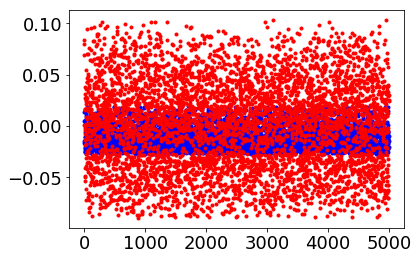

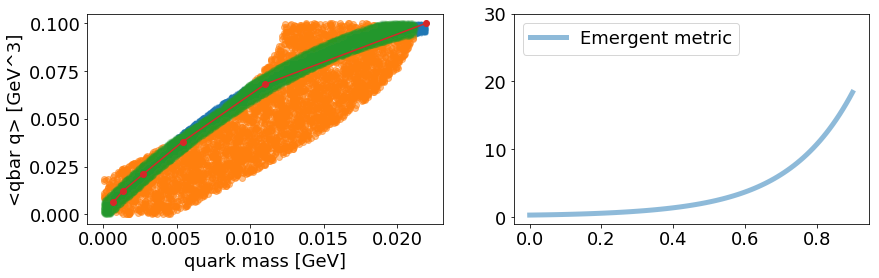

iter 4200 loss 0.189243
L: 1.9910756349563599, lmd: -1.273481845855713, poly: [5.4438825  5.761219   4.7652664  4.514178   4.9849267  2.6402605
 2.7627928  0.67422116 0.2708209 ]
name grad
func.lmd tensor([-0.0342])
func.L tensor([0.0060])
func.metric.poly_para tensor([-0.0119, -0.0159, -0.0221, -0.0320, -0.0491, -0.0817, -0.1523, -0.3401,
        -1.0844])


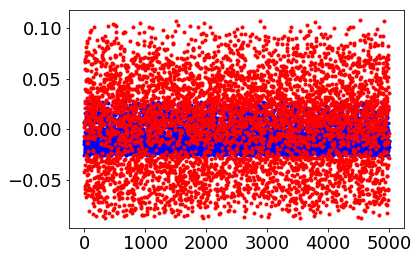

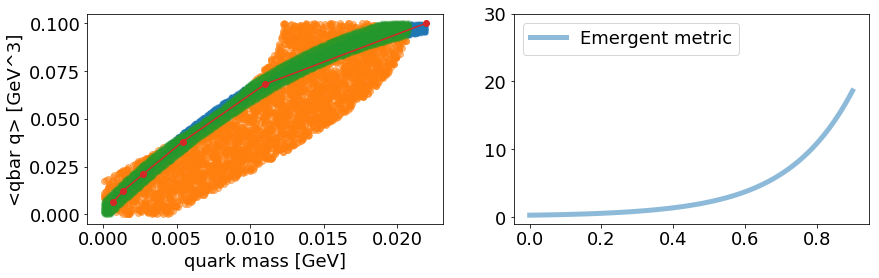

iter 4250 loss 0.184775
L: 1.9945764541625977, lmd: -1.171602487564087, poly: [5.5079093 5.8243876 4.8269877 4.573356  5.0394325 2.6860511 2.7934003
 0.6834891 0.2581789]
name grad
func.lmd tensor([-0.0161])
func.L tensor([-0.0162])
func.metric.poly_para tensor([-0.0076, -0.0095, -0.0120, -0.0156, -0.0207, -0.0286, -0.0415, -0.0657,
        -0.1206])


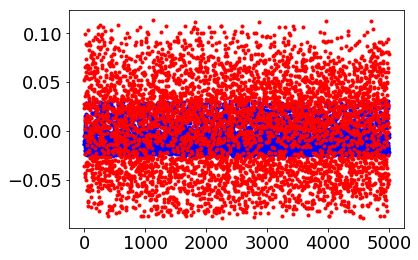

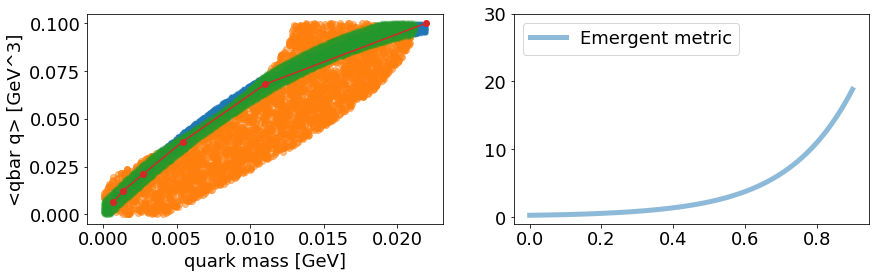

iter 4300 loss 0.175306
L: 1.9977208375930786, lmd: -1.0759425163269043, poly: [5.567798  5.8832808 4.8842406 4.627785  5.0888286 2.7264636 2.819092
 0.6897895 0.2452909]
name grad
func.lmd tensor([-0.0092])
func.L tensor([-0.0091])
func.metric.poly_para tensor([-0.0051, -0.0058, -0.0063, -0.0062, -0.0046,  0.0014,  0.0209,  0.0891,
         0.4245])


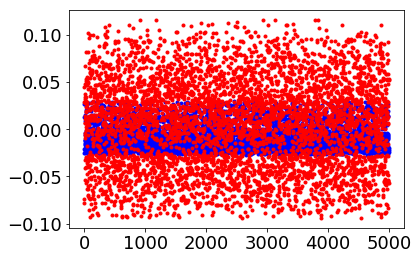

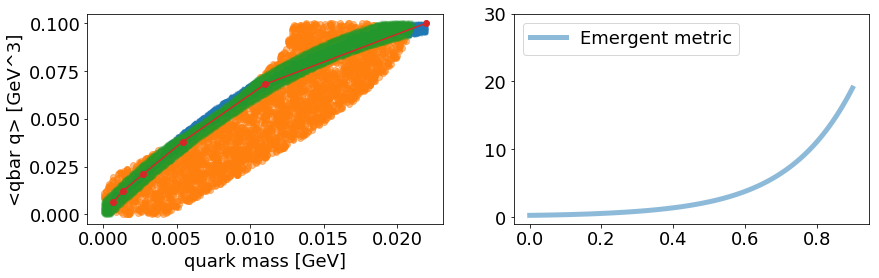

iter 4350 loss 0.174623
L: 2.0051193237304688, lmd: -0.9843006730079651, poly: [5.6255074  5.9400563  4.939463   4.680315   5.1365275  2.7655454
 2.8441386  0.696534   0.23403089]
name grad
func.lmd tensor([-0.0111])
func.L tensor([0.0046])
func.metric.poly_para tensor([-0.0042, -0.0047, -0.0049, -0.0045, -0.0023,  0.0046,  0.0256,  0.0967,
         0.4397])


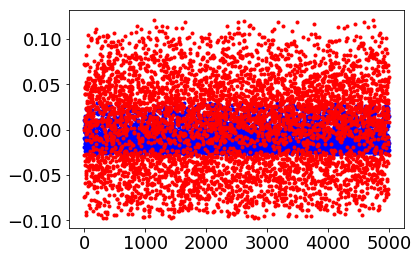

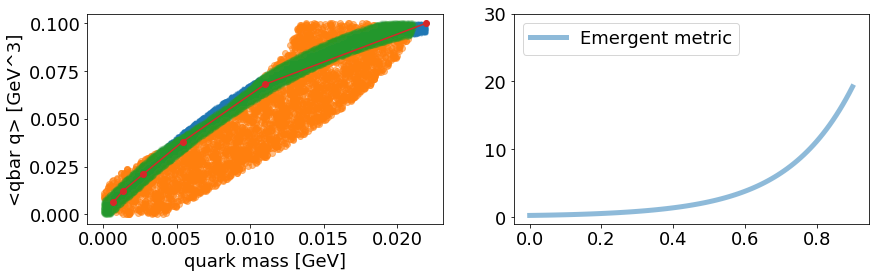

iter 4400 loss 0.171179
L: 2.0082435607910156, lmd: -0.892787516117096, poly: [5.6798415  5.993396   4.9911656  4.7292166  5.1805024  2.8009596
 2.866127   0.70164293 0.22285233]
name grad
func.lmd tensor([-0.0392])
func.L tensor([-0.0296])
func.metric.poly_para tensor([-0.0119, -0.0162, -0.0229, -0.0339, -0.0533, -0.0911, -0.1748, -0.4029,
        -1.3288])


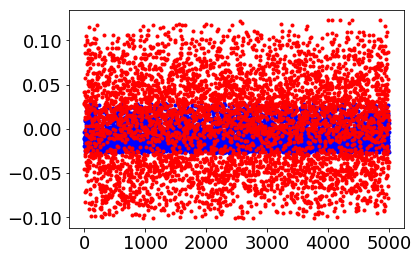

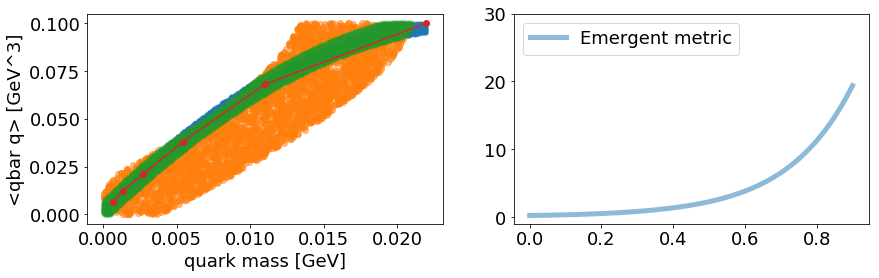

iter 4450 loss 0.154241
L: 2.0183417797088623, lmd: -0.8076977133750916, poly: [5.7320943  6.044589   5.040618   4.7757106  5.221892   2.8338192
 2.8863337  0.706772   0.21376643]
name grad
func.lmd tensor([-0.0235])
func.L tensor([-0.0141])
func.metric.poly_para tensor([-0.0070, -0.0090, -0.0119, -0.0162, -0.0230, -0.0349, -0.0584, -0.1153,
        -0.3186])


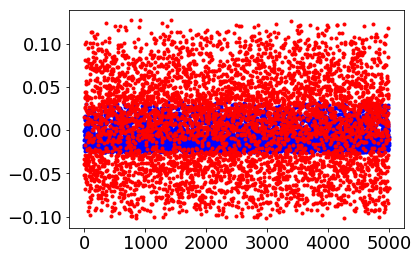

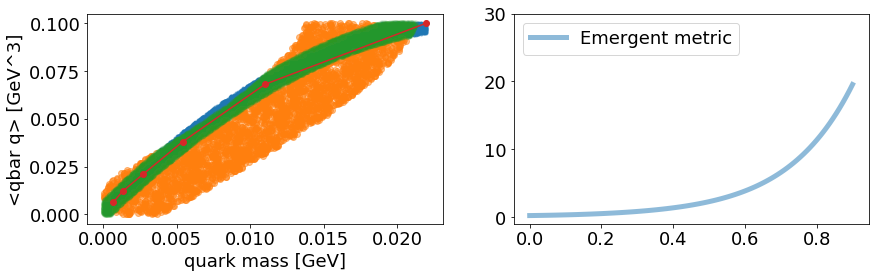

iter 4500 loss 0.158861
L: 2.0276687145233154, lmd: -0.7223970890045166, poly: [5.78179    6.0931525  5.087345   4.819362   5.260335   2.8637586
 2.9040084  0.71021396 0.20400096]
name grad
func.lmd tensor([-0.0191])
func.L tensor([-0.0070])
func.metric.poly_para tensor([-0.0054, -0.0066, -0.0080, -0.0097, -0.0116, -0.0131, -0.0123,  0.0011,
         0.0977])


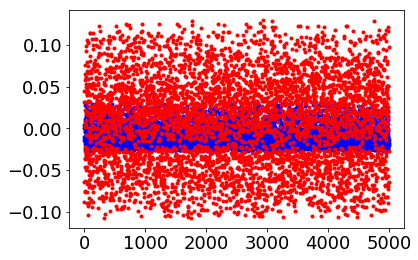

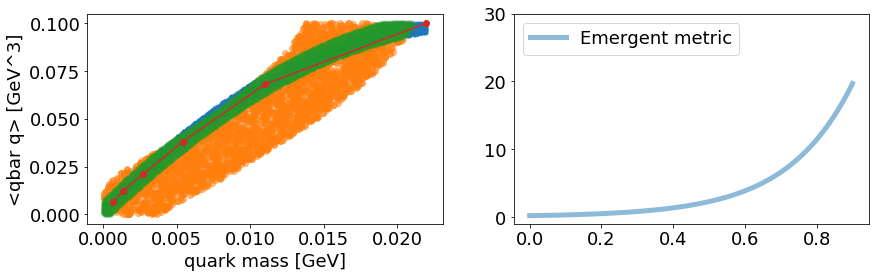

iter 4550 loss 0.158136
L: 2.0396173000335693, lmd: -0.6362389922142029, poly: [5.8303337  6.1406116  5.1330357  4.8620715  5.297983   2.8931603
 2.9215896  0.71416837 0.19534598]
name grad
func.lmd tensor([-0.0205])
func.L tensor([-0.0173])
func.metric.poly_para tensor([-0.0059, -0.0073, -0.0091, -0.0115, -0.0147, -0.0191, -0.0250, -0.0310,
        -0.0180])


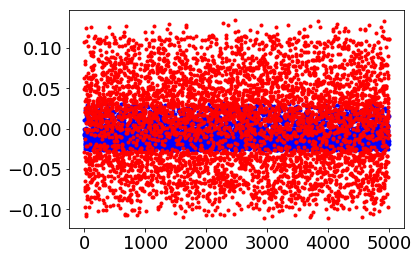

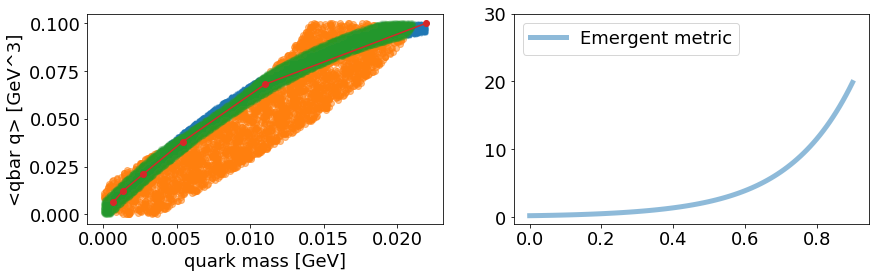

iter 4600 loss 0.144733
L: 2.0536510944366455, lmd: -0.5491986274719238, poly: [5.876989   6.1861997  5.1768775  4.9029894  5.3339515  2.9211006
 2.938107   0.71761435 0.18676688]
name grad
func.lmd tensor([-0.0239])
func.L tensor([-0.0317])
func.metric.poly_para tensor([-0.0068, -0.0087, -0.0113, -0.0152, -0.0213, -0.0316, -0.0513, -0.0974,
        -0.2554])


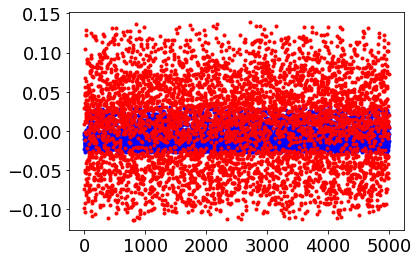

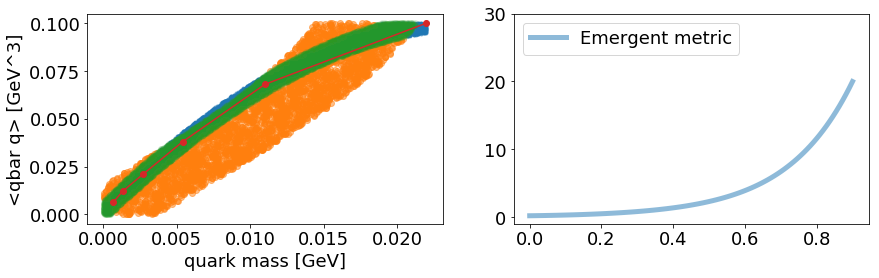

iter 4650 loss 0.142486
L: 2.0702409744262695, lmd: -0.46081939339637756, poly: [5.9218707  6.229991   5.2188983  4.942056   5.368073   2.9473388
 2.953361   0.7205366  0.17845964]
name grad
func.lmd tensor([-0.0180])
func.L tensor([-0.0057])
func.metric.poly_para tensor([-0.0039, -0.0043, -0.0044, -0.0039, -0.0014,  0.0060,  0.0279,  0.1017,
         0.4556])


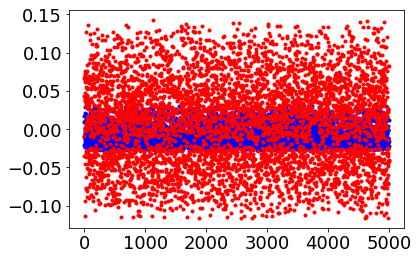

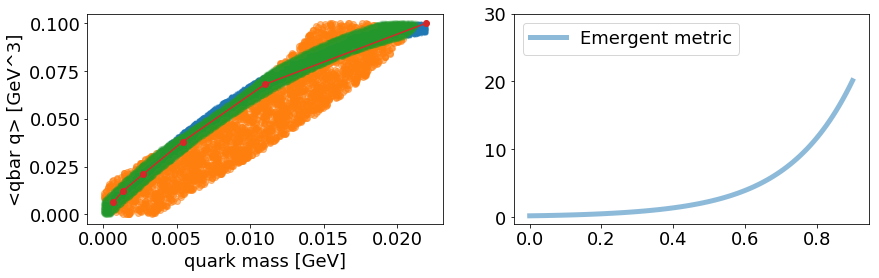

iter 4700 loss 0.137326
L: 2.0945229530334473, lmd: -0.3715945780277252, poly: [5.9662666  6.2732115  5.2602186  4.9802446  5.4011064  2.9723613
 2.9675741  0.72294587 0.17027612]
name grad
func.lmd tensor([-0.0109])
func.L tensor([0.0170])
func.metric.poly_para tensor([-1.0852e-03, -1.9744e-04,  1.7622e-03,  5.9644e-03,  1.5130e-02,
         3.6254e-02,  9.0127e-02,  2.5463e-01,  9.9194e-01])


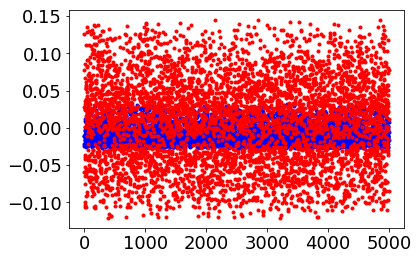

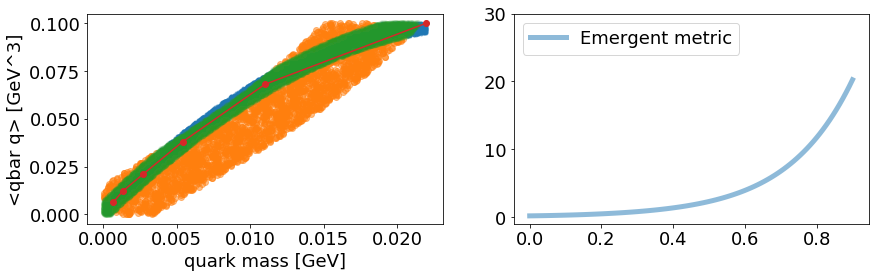

iter 4750 loss 0.129117
L: 2.123100519180298, lmd: -0.28069621324539185, poly: [6.0087705  6.314413   5.299348   5.0160236  5.4315414  2.994832
 2.9797788  0.7243367  0.16212769]
name grad
func.lmd tensor([-0.0142])
func.L tensor([0.0173])
func.metric.poly_para tensor([-8.3183e-04,  1.2808e-04,  2.1916e-03,  6.5515e-03,  1.5975e-02,
         3.7563e-02,  9.2398e-02,  2.5937e-01,  1.0062e+00])


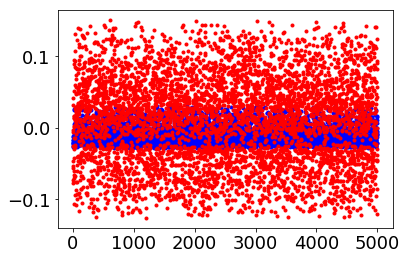

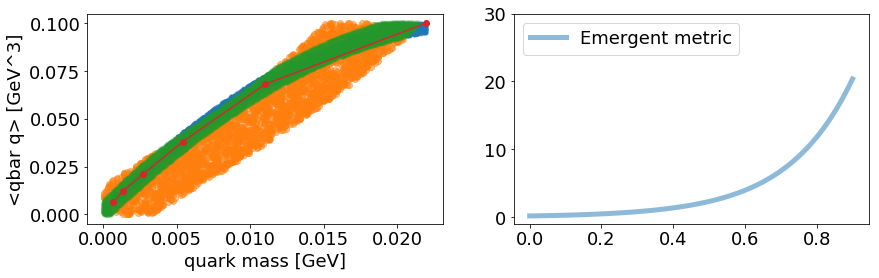

iter 4800 loss 0.128862
L: 2.1623952388763428, lmd: -0.1917491853237152, poly: [6.050209  6.354356  5.3369517 5.049942  5.4598107 3.0151231 2.990373
 0.7251642 0.1545127]
name grad
func.lmd tensor([-0.0037])
func.L tensor([0.0214])
func.metric.poly_para tensor([6.4927e-04, 2.3935e-03, 5.7870e-03, 1.2525e-02, 2.6496e-02, 5.7590e-02,
        1.3495e-01, 3.6697e-01, 1.3924e+00])


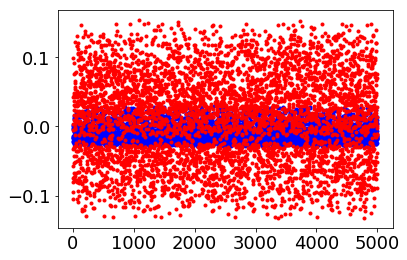

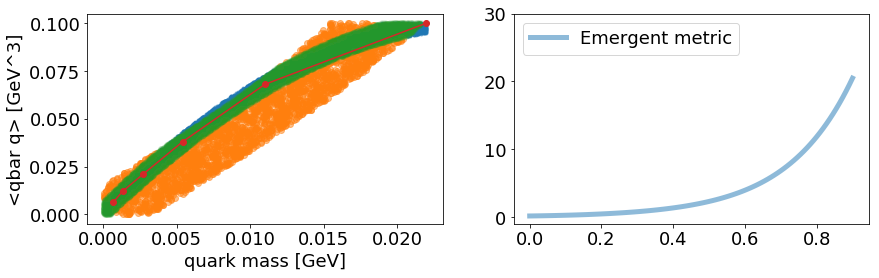

iter 4850 loss 0.119124
L: 2.214961528778076, lmd: -0.10414120554924011, poly: [6.091311   6.393858   5.373973   5.0830975  5.487117   3.0343018
 2.999828   0.7249658  0.14607175]
name grad
func.lmd tensor([-0.0822])
func.L tensor([-0.1146])
func.metric.poly_para tensor([-0.0129, -0.0181, -0.0266, -0.0408, -0.0669, -0.1193, -0.2394, -0.5762,
        -1.9862])


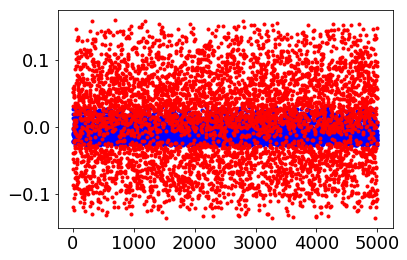

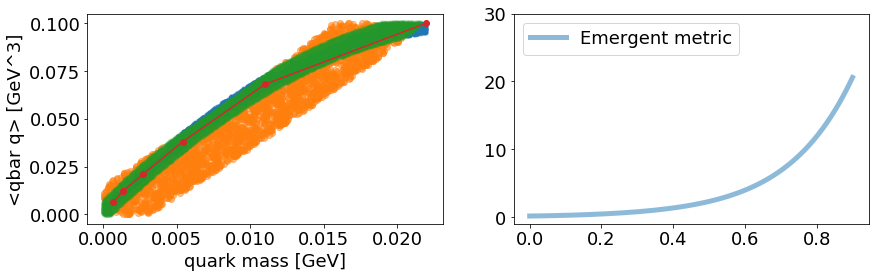

iter 4900 loss 0.109464
L: 2.2786178588867188, lmd: -0.020993925631046295, poly: [6.131725  6.432512  5.4099364 5.1149473 5.512905  3.0519457 3.008055
 0.7240766 0.1375136]
name grad
func.lmd tensor([-0.0391])
func.L tensor([-0.0672])
func.metric.poly_para tensor([-0.0067, -0.0087, -0.0116, -0.0159, -0.0231, -0.0359, -0.0622, -0.1284,
        -0.3787])


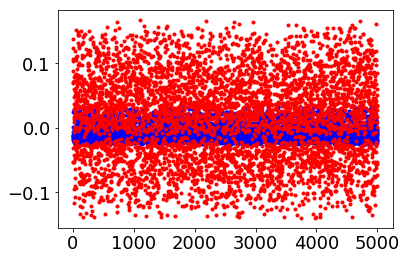

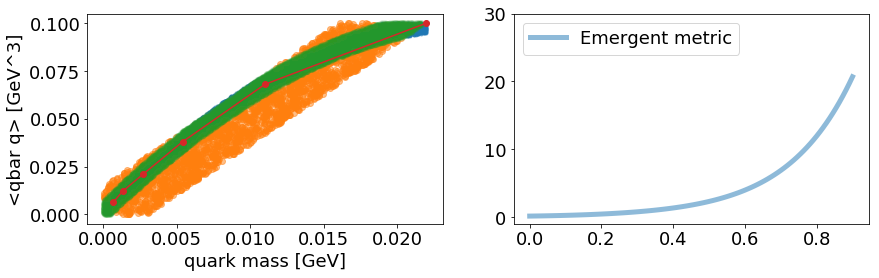

iter 4950 loss 0.098588
L: 2.354017734527588, lmd: 0.046745799481868744, poly: [6.173235   6.4721713  5.446765   5.1474733  5.53914    3.0698218
 3.0163882  0.72326875 0.12908362]
name grad
func.lmd tensor([-0.0203])
func.L tensor([-0.0622])
func.metric.poly_para tensor([-0.0059, -0.0074, -0.0096, -0.0127, -0.0175, -0.0253, -0.0398, -0.0723,
        -0.1785])


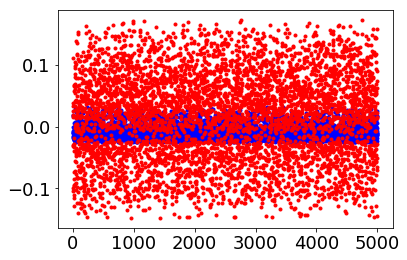

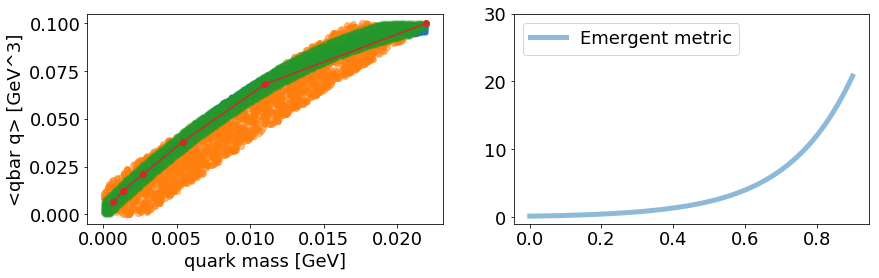

iter 5000 loss 0.092256
L: 2.433079957962036, lmd: 0.09725642204284668, poly: [6.21619    6.5130973  5.4846134  5.180673   5.5656247  3.087509
 3.0241714  0.721677   0.11974615]
name grad
func.lmd tensor([-0.0373])
func.L tensor([-0.0726])
func.metric.poly_para tensor([-0.0063, -0.0081, -0.0105, -0.0140, -0.0195, -0.0288, -0.0464, -0.0876,
        -0.2301])


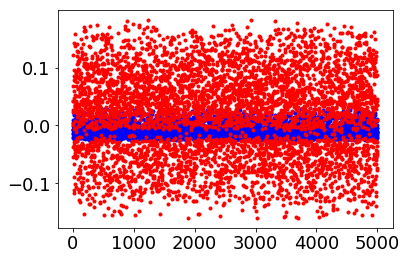

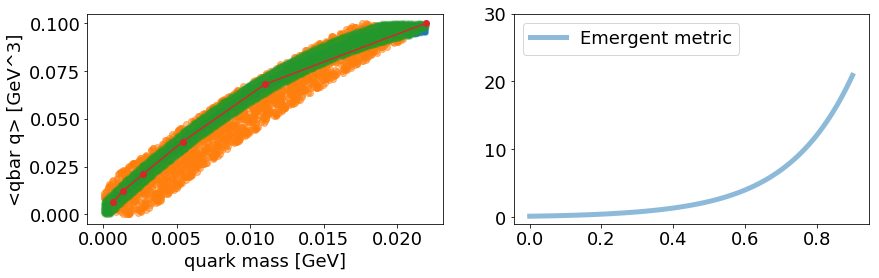

iter 5050 loss 0.085580
L: 2.5068037509918213, lmd: 0.1289326250553131, poly: [6.2589087  6.553832   5.5223227  5.2138085  5.592165   3.1054487
 3.032485   0.7209117  0.11148994]
name grad
func.lmd tensor([-0.0023])
func.L tensor([-0.0429])
func.metric.poly_para tensor([-0.0038, -0.0042, -0.0044, -0.0040, -0.0020,  0.0044,  0.0239,  0.0898,
         0.4069])


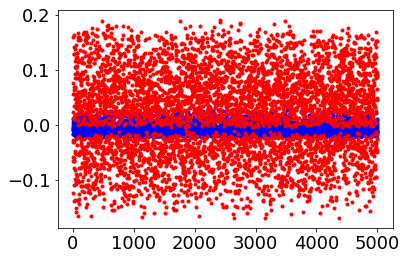

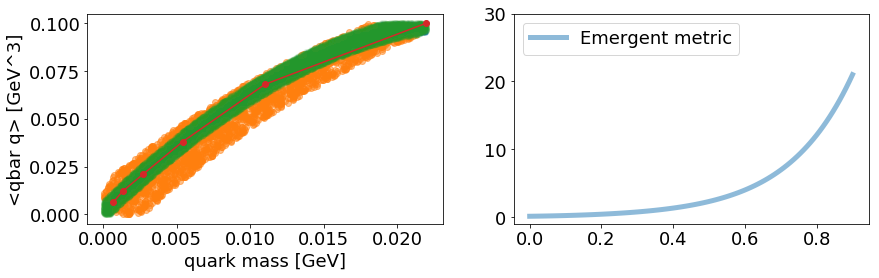

iter 5100 loss 0.083456
L: 2.5712647438049316, lmd: 0.14830519258975983, poly: [6.2995424  6.592459   5.557913   5.2448683  5.6167994  3.1218793
 3.0399077  0.7199487  0.10364166]
name grad
func.lmd tensor([0.0664])
func.L tensor([0.0091])
func.metric.poly_para tensor([-3.9089e-04,  8.3084e-04,  3.3524e-03,  8.5562e-03,  1.9641e-02,
         4.4796e-02,  1.0830e-01,  3.0084e-01,  1.1588e+00])


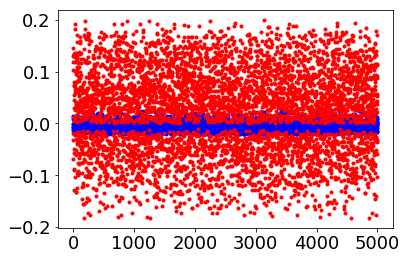

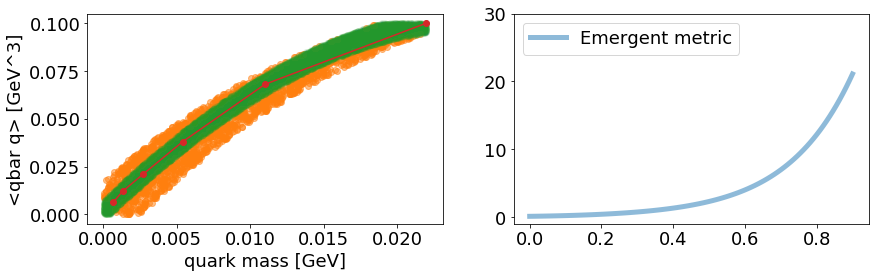

iter 5150 loss 0.074034
L: 2.6246135234832764, lmd: 0.15128017961978912, poly: [6.338083   6.6290264  5.59151    5.2740855  5.639924   3.1374054
 3.0472732  0.7198102  0.09734935]
name grad
func.lmd tensor([0.1075])
func.L tensor([0.0298])
func.metric.poly_para tensor([2.5761e-04, 1.7562e-03, 4.7278e-03, 1.0707e-02, 2.3231e-02, 5.1322e-02,
        1.2166e-01, 3.3374e-01, 1.2753e+00])


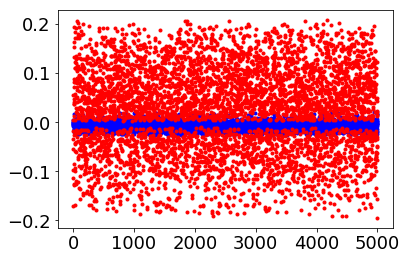

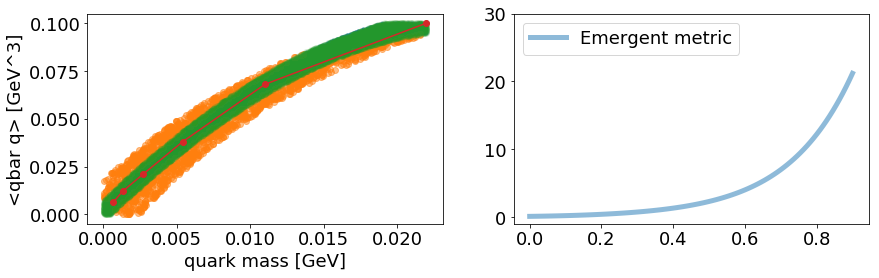

iter 5200 loss 0.074071
L: 2.668623208999634, lmd: 0.14273002743721008, poly: [6.375074   6.6639915  5.6234612  5.3016734  5.661592   3.151887
 3.054204   0.71987987 0.09179965]
name grad
func.lmd tensor([0.0166])
func.L tensor([-0.0297])
func.metric.poly_para tensor([-0.0035, -0.0041, -0.0046, -0.0050, -0.0046, -0.0019,  0.0078,  0.0441,
         0.2283])


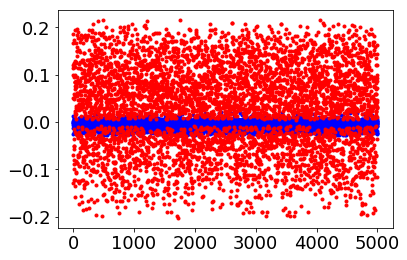

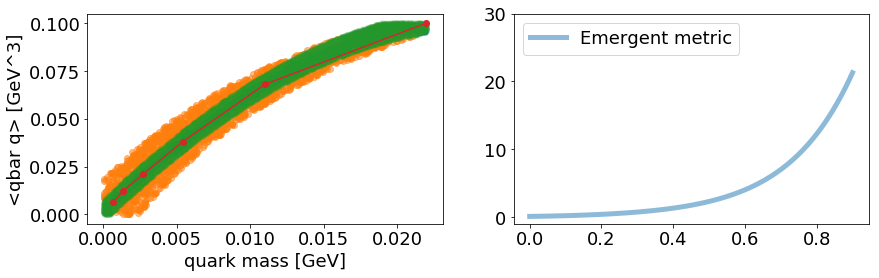

iter 5250 loss 0.070838
L: 2.7124183177948, lmd: 0.14456987380981445, poly: [6.411209   6.69796    5.654267   5.3280134  5.6820736  3.1654997
 3.060804   0.72021484 0.08703855]
name grad
func.lmd tensor([-0.0844])
func.L tensor([-0.0947])
func.metric.poly_para tensor([-0.0090, -0.0123, -0.0175, -0.0261, -0.0414, -0.0716, -0.1394, -0.3269,
        -1.1029])


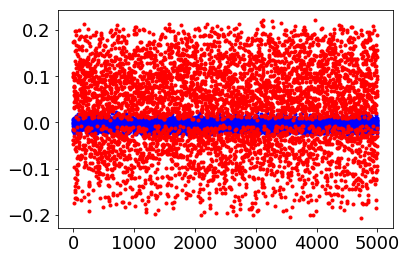

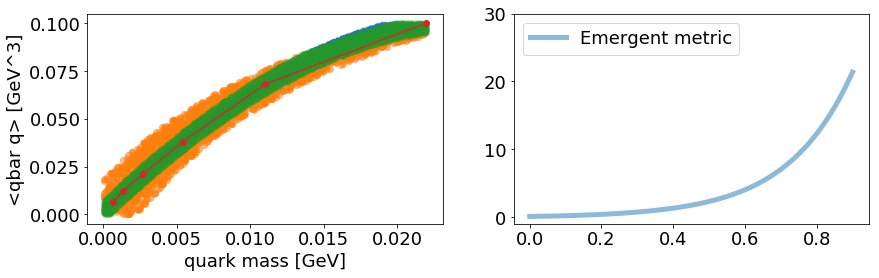

iter 5300 loss 0.069724
L: 2.7469024658203125, lmd: 0.13496452569961548, poly: [6.4459047  6.7303224  5.6832976  5.3524833  5.7007556  3.1776175
 3.0663888  0.72004336 0.08219375]
name grad
func.lmd tensor([-0.1128])
func.L tensor([-0.0959])
func.metric.poly_para tensor([-0.0080, -0.0109, -0.0154, -0.0228, -0.0360, -0.0618, -0.1197, -0.2793,
        -0.9388])


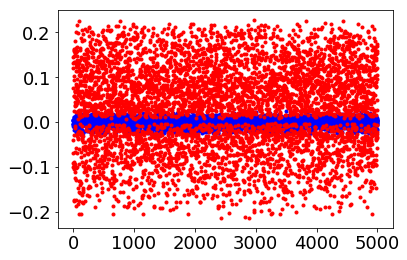

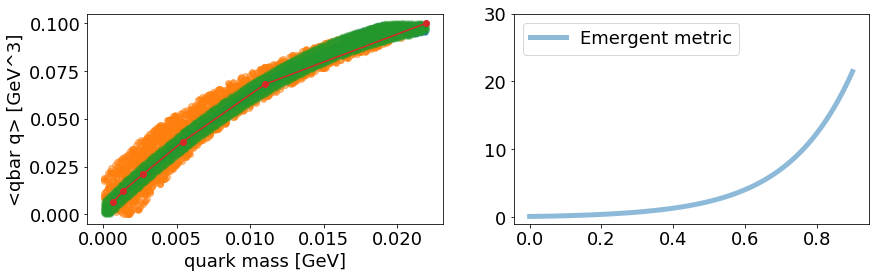

iter 5350 loss 0.064793
L: 2.777998447418213, lmd: 0.12639173865318298, poly: [6.4797745  6.7618046  5.7114353  5.376138   5.718878   3.189622
 3.0724115  0.72083956 0.07874782]
name grad
func.lmd tensor([0.0609])
func.L tensor([-0.0140])
func.metric.poly_para tensor([-0.0037, -0.0044, -0.0051, -0.0058, -0.0062, -0.0052,  0.0005,  0.0252,
         0.1595])


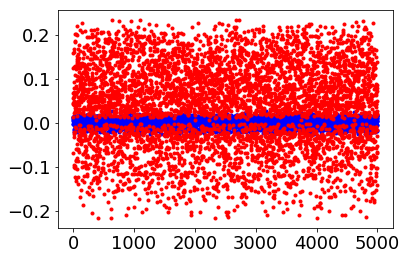

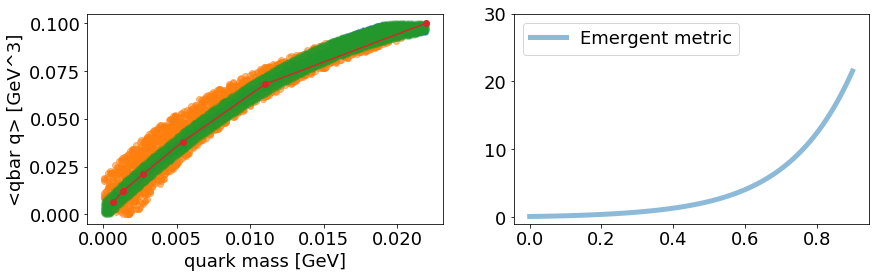

iter 5400 loss 0.060997
L: 2.8033463954925537, lmd: 0.11553268134593964, poly: [6.5119987  6.7915044  5.7377014  5.3979893  5.735509   3.2007053
 3.0782218  0.7221075  0.07633643]
name grad
func.lmd tensor([-0.3826])
func.L tensor([-0.1936])
func.metric.poly_para tensor([-0.0157, -0.0230, -0.0350, -0.0560, -0.0956, -0.1771, -0.3682, -0.9161,
        -3.2538])


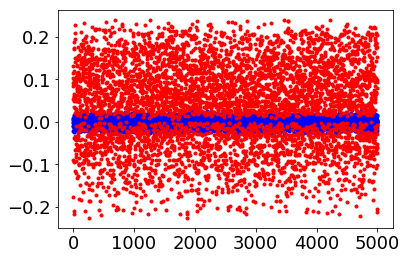

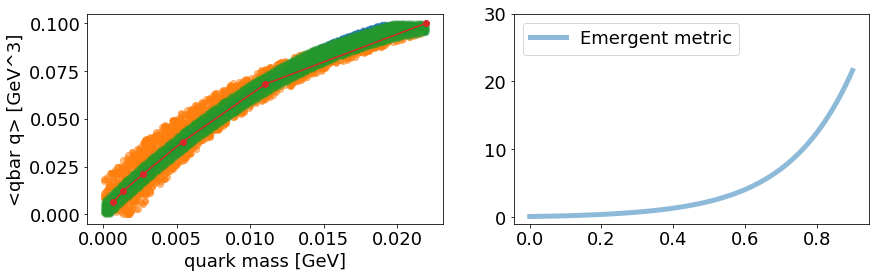

iter 5450 loss 0.062455
L: 2.8221518993377686, lmd: 0.10879964381456375, poly: [6.5394955  6.81606    5.758603   5.414637   5.747593   3.2083073
 3.0817897  0.72229433 0.07380984]
name grad
func.lmd tensor([-0.0084])
func.L tensor([-0.0425])
func.metric.poly_para tensor([-0.0056, -0.0073, -0.0099, -0.0140, -0.0210, -0.0339, -0.0614, -0.1337,
        -0.4190])


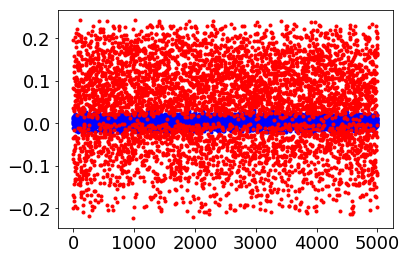

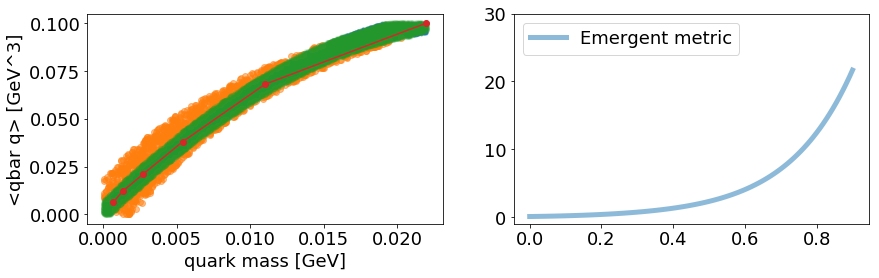

iter 5500 loss 0.057955
L: 2.842942953109741, lmd: 0.10271775722503662, poly: [6.5681515  6.8416343  5.7803693  5.432001   5.760263   3.2163925
 3.0857606  0.72282577 0.07158731]
name grad
func.lmd tensor([-0.1682])
func.L tensor([-0.1060])
func.metric.poly_para tensor([-0.0110, -0.0157, -0.0231, -0.0359, -0.0595, -0.1072, -0.2174, -0.5295,
        -1.8469])


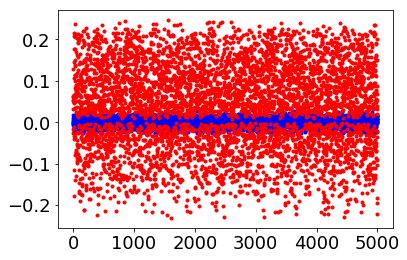

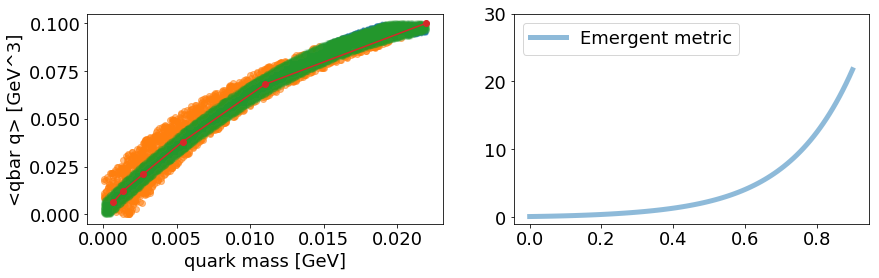

iter 5550 loss 0.059925
L: 2.8631107807159424, lmd: 0.09634673595428467, poly: [6.5964665  6.866876   5.8018327  5.4491234  5.7727814  3.2244358
 3.089796   0.7235149  0.06959752]
name grad
func.lmd tensor([-0.1447])
func.L tensor([-0.0827])
func.metric.poly_para tensor([-0.0076, -0.0106, -0.0153, -0.0231, -0.0373, -0.0656, -0.1299, -0.3098,
        -1.0615])


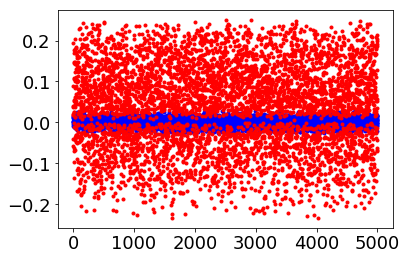

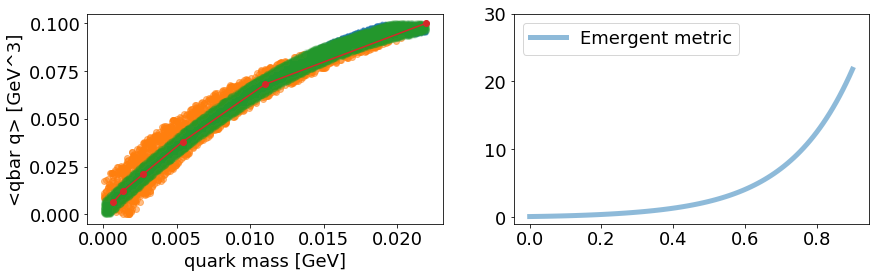

iter 5600 loss 0.057644
L: 2.88285231590271, lmd: 0.09233169257640839, poly: [6.6231775 6.8905044 5.8217316 5.464801  5.7840443 3.2314517 3.093037
 0.7236182 0.0671975]
name grad
func.lmd tensor([-0.0239])
func.L tensor([-0.0466])
func.metric.poly_para tensor([-0.0067, -0.0091, -0.0129, -0.0192, -0.0304, -0.0523, -0.1017, -0.2381,
        -0.8012])


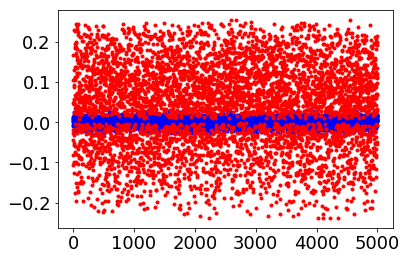

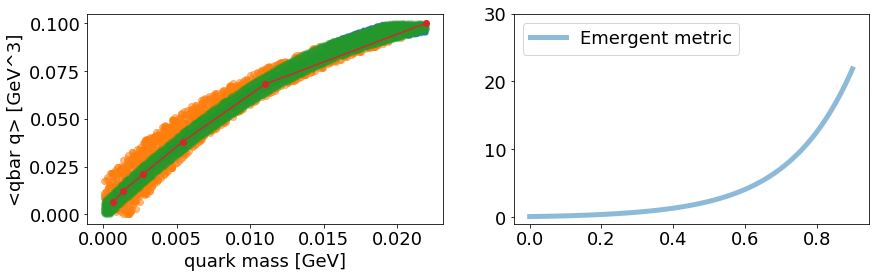

iter 5650 loss 0.054397
L: 2.9006187915802, lmd: 0.08706836402416229, poly: [6.6490273  6.913359   5.841003   5.4800663  5.795165   3.2386131
 3.0966978  0.724372   0.06562823]
name grad
func.lmd tensor([-0.2505])
func.L tensor([-0.1136])
func.metric.poly_para tensor([-0.0112, -0.0161, -0.0240, -0.0376, -0.0630, -0.1147, -0.2350, -0.5772,
        -2.0288])


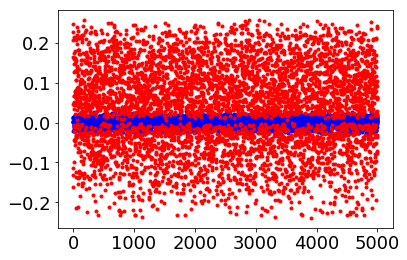

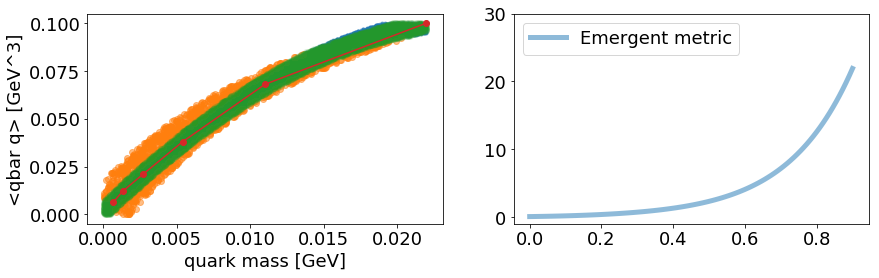

iter 5700 loss 0.060509
L: 2.9169602394104004, lmd: 0.08226638287305832, poly: [6.673026   6.934301   5.8583846  5.493567   5.8047347  3.2444925
 3.0993466  0.7243555  0.06348859]
name grad
func.lmd tensor([-0.8804])
func.L tensor([-0.2875])
func.metric.poly_para tensor([-0.0249, -0.0372, -0.0578, -0.0942, -0.1635, -0.3076, -0.6482, -1.6315,
        -5.8515])


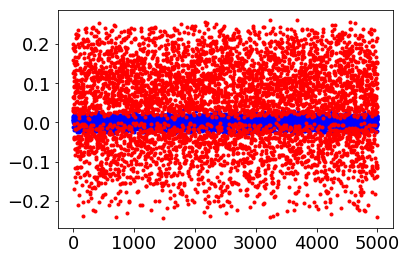

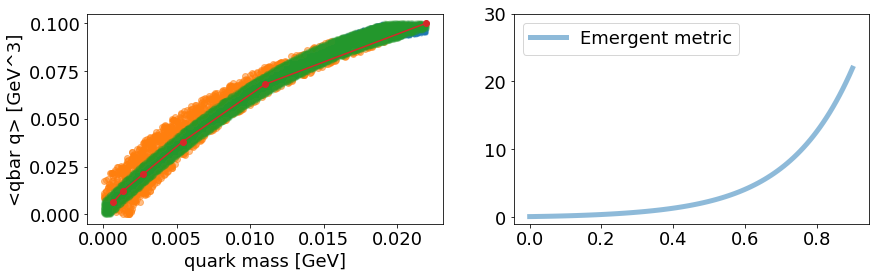

iter 5750 loss 0.055355
L: 2.9323208332061768, lmd: 0.07954659312963486, poly: [6.695637   6.95393    5.8746386  5.50624    5.8138576  3.2503314
 3.1023366  0.72500366 0.06227288]
name grad
func.lmd tensor([0.3485])
func.L tensor([0.0719])
func.metric.poly_para tensor([0.0046, 0.0080, 0.0141, 0.0255, 0.0481, 0.0969, 0.2156, 0.5665, 2.1007])


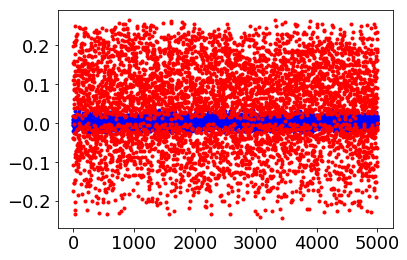

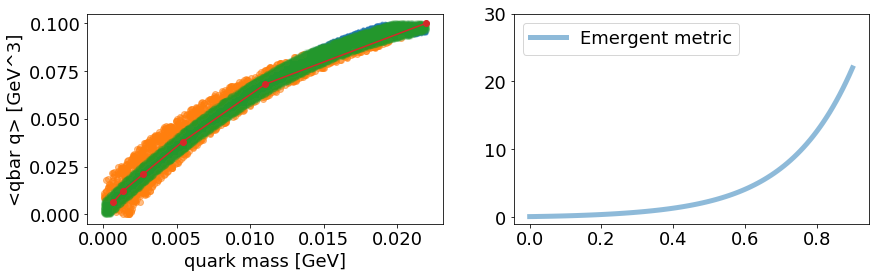

iter 5800 loss 0.053625
L: 2.947042942047119, lmd: 0.0769861489534378, poly: [6.71708    6.9723134  5.8896413  5.5177298  5.821926   3.2552788
 3.1045961  0.7250664  0.06059202]
name grad
func.lmd tensor([0.1172])
func.L tensor([0.0010])
func.metric.poly_para tensor([-1.7517e-03, -1.6799e-03, -1.2411e-03,  3.4875e-05,  3.2789e-03,
         1.1476e-02,  3.3693e-02,  1.0450e-01,  4.3206e-01])


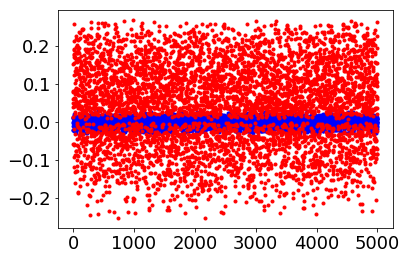

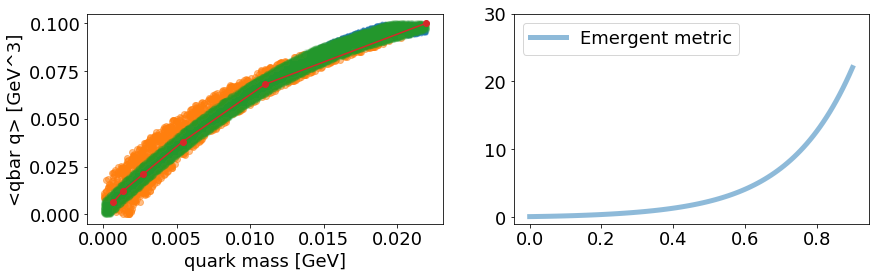

iter 5850 loss 0.051977
L: 2.9608287811279297, lmd: 0.0739016905426979, poly: [6.7378945  6.9900937  5.904103   5.528773   5.8296647  3.2600126
 3.106751   0.72511595 0.05897063]
name grad
func.lmd tensor([1.1154])
func.L tensor([0.2732])
func.metric.poly_para tensor([0.0224, 0.0352, 0.0572, 0.0971, 0.1745, 0.3382, 0.7307, 1.8762, 6.8377])


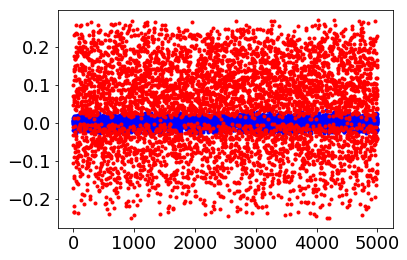

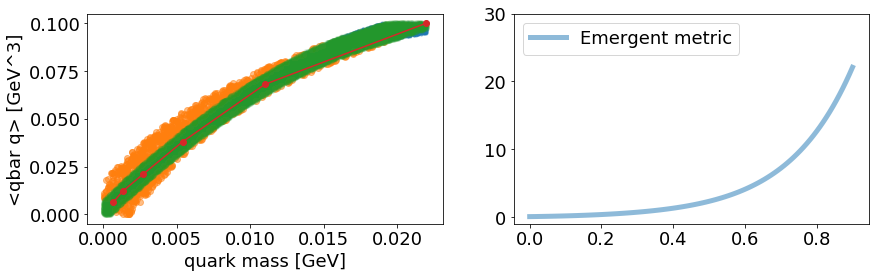

iter 5900 loss 0.048145
L: 2.97363543510437, lmd: 0.07115527242422104, poly: [6.7577434  7.006981   5.917813   5.539269   5.8370924  3.2646775
 3.109056   0.72549874 0.05782781]
name grad
func.lmd tensor([0.1744])
func.L tensor([0.0201])
func.metric.poly_para tensor([0.0013, 0.0029, 0.0060, 0.0120, 0.0242, 0.0512, 0.1181, 0.3181, 1.2015])


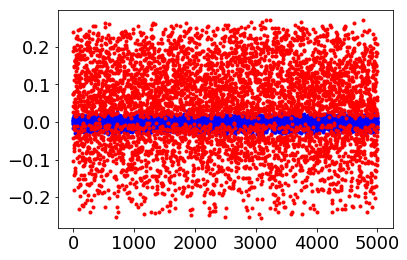

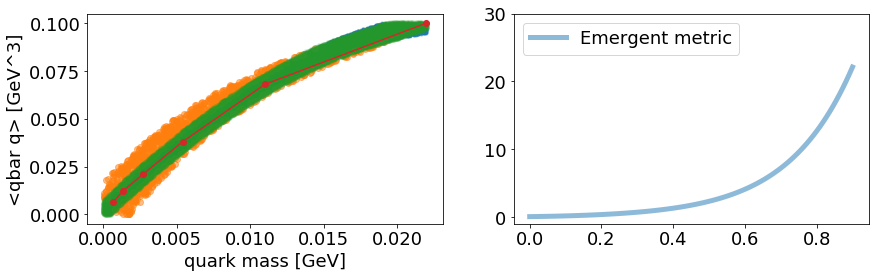

iter 5950 loss 0.051899
L: 2.9861912727355957, lmd: 0.0685323104262352, poly: [6.7767324  7.0230365  5.930744   5.5490565  5.8438983  3.2688086
 3.110908   0.7254972  0.05635802]
name grad
func.lmd tensor([0.4482])
func.L tensor([0.0772])
func.metric.poly_para tensor([0.0045, 0.0078, 0.0139, 0.0253, 0.0479, 0.0969, 0.2162, 0.5694, 2.1159])


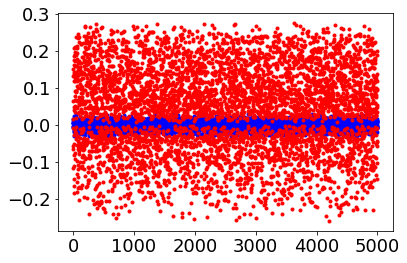

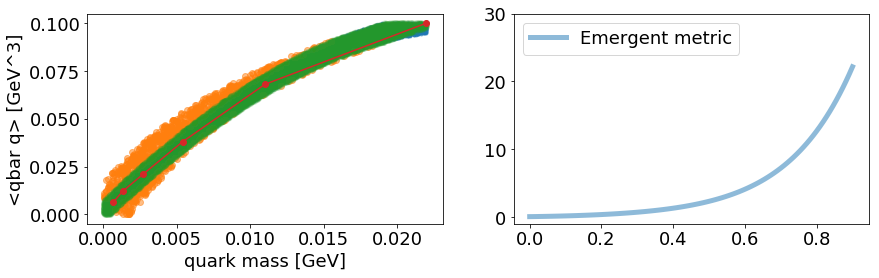

iter 6000 loss 0.051490
L: 2.998504638671875, lmd: 0.06723106652498245, poly: [6.794903   7.0383587  5.943083   5.5584254  5.8504763  3.2728944
 3.1128814  0.72575325 0.05525582]
name grad
func.lmd tensor([0.1643])
func.L tensor([0.0158])
func.metric.poly_para tensor([9.6179e-04, 2.3868e-03, 5.1003e-03, 1.0417e-02, 2.1356e-02, 4.5601e-02,
        1.0583e-01, 2.8647e-01, 1.0854e+00])


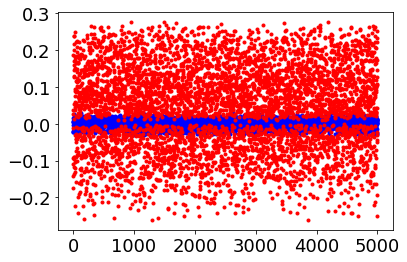

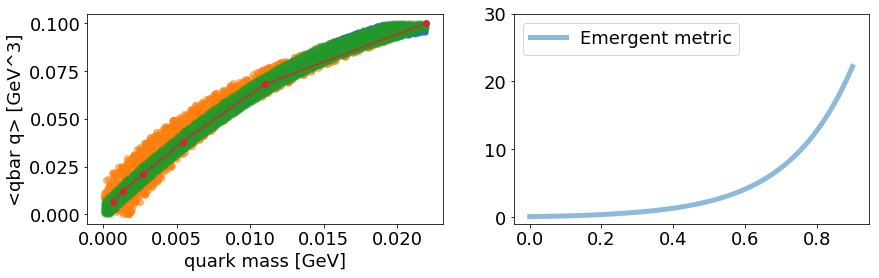

iter 6050 loss 0.050153
L: 3.010211229324341, lmd: 0.06437726318836212, poly: [6.813291   7.0538926  5.955629   5.568008   5.857275   3.2772114
 3.1150937  0.7262552  0.05440284]
name grad
func.lmd tensor([-0.5378])
func.L tensor([-0.1429])
func.metric.poly_para tensor([-0.0128, -0.0187, -0.0285, -0.0457, -0.0779, -0.1443, -0.3004, -0.7486,
        -2.6648])


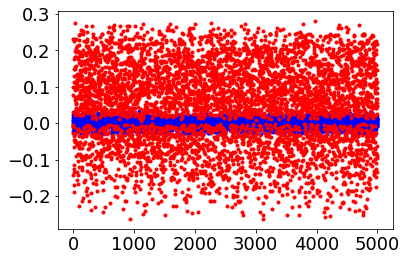

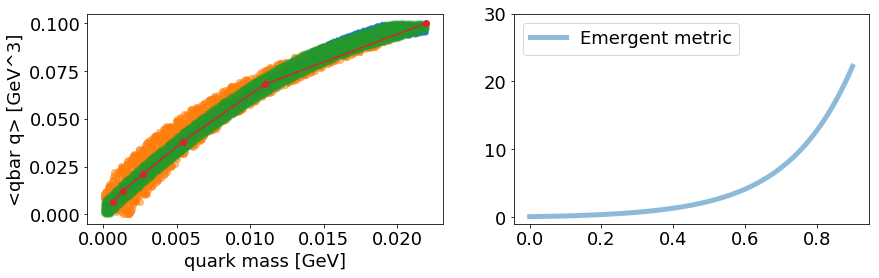

iter 6100 loss 0.049472
L: 3.021164894104004, lmd: 0.0623898059129715, poly: [6.8301296  7.068009   5.9669266  5.5765386  5.863223   3.280869
 3.1168156  0.72640616 0.05331179]
name grad
func.lmd tensor([-0.0872])
func.L tensor([-0.0422])
func.metric.poly_para tensor([-0.0044, -0.0059, -0.0082, -0.0118, -0.0181, -0.0301, -0.0565, -0.1277,
        -0.4165])


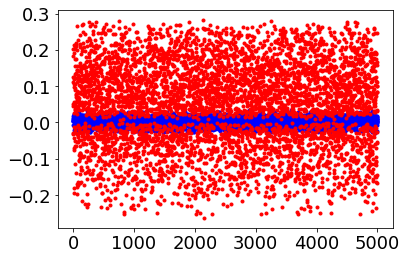

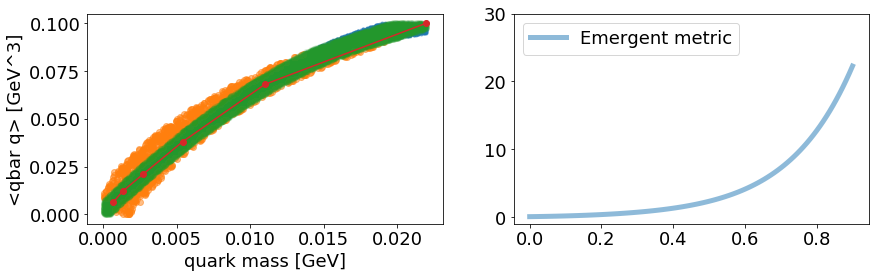

iter 6150 loss 0.047466
L: 3.0314104557037354, lmd: 0.05964731052517891, poly: [6.8465285  7.0817075  5.97785    5.584751   5.868919   3.2843425
 3.1184118  0.726482   0.05218469]
name grad
func.lmd tensor([0.6244])
func.L tensor([0.1146])
func.metric.poly_para tensor([0.0105, 0.0168, 0.0278, 0.0479, 0.0872, 0.1707, 0.3721, 0.9620, 3.5247])


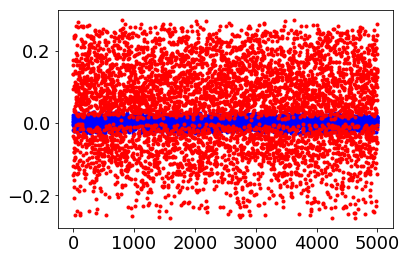

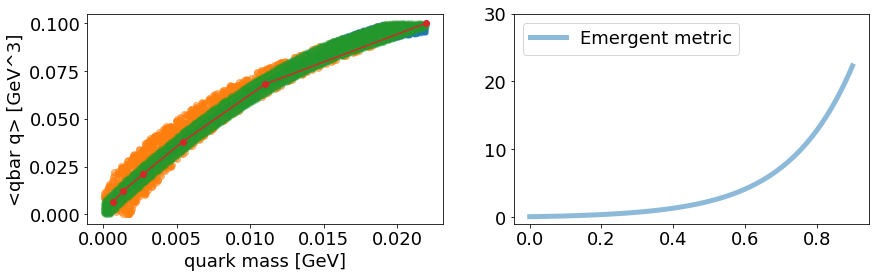

iter 6200 loss 0.050206
L: 3.041607141494751, lmd: 0.058505069464445114, poly: [6.86202    7.094608   5.9881215  5.5924883  5.874322   3.2876928
 3.120035   0.72670805 0.05130713]
name grad
func.lmd tensor([-0.6820])
func.L tensor([-0.1545])
func.metric.poly_para tensor([-0.0135, -0.0199, -0.0305, -0.0493, -0.0847, -0.1583, -0.3316, -0.8311,
        -2.9726])


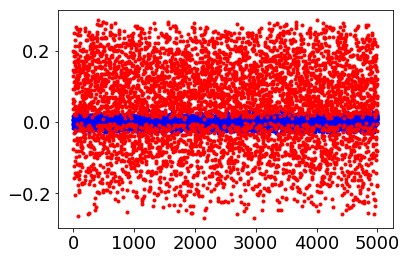

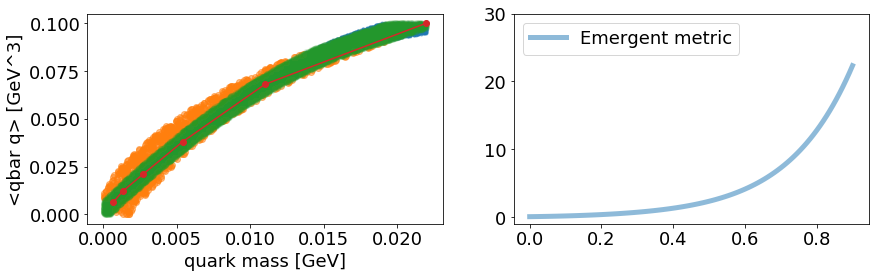

iter 6250 loss 0.048582
L: 3.0508534908294678, lmd: 0.05701005458831787, poly: [6.8764668  7.1065917  5.9976373  5.5996437  5.8793125  3.2907937
 3.1215472  0.7269377  0.05052343]
name grad
func.lmd tensor([0.0391])
func.L tensor([-0.0132])
func.metric.poly_para tensor([-0.0017, -0.0018, -0.0017, -0.0011,  0.0006,  0.0054,  0.0190,  0.0637,
         0.2737])


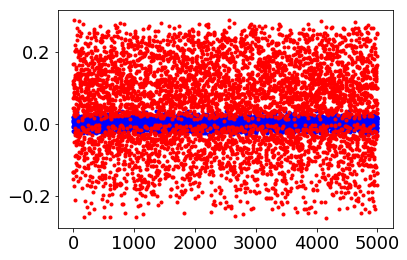

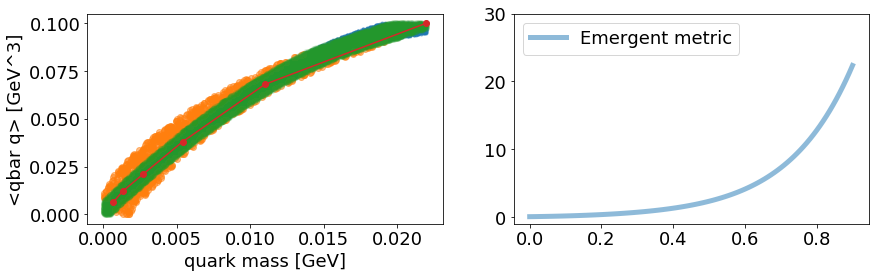

iter 6300 loss 0.050247
L: 3.0600297451019287, lmd: 0.056628648191690445, poly: [6.8897524  7.1174793  6.0061555  5.6059246  5.8835626  3.293277
 3.1225522  0.7267529  0.04940112]
name grad
func.lmd tensor([-0.9717])
func.L tensor([-0.2059])
func.metric.poly_para tensor([-0.0194, -0.0290, -0.0453, -0.0741, -0.1291, -0.2438, -0.5156, -1.3021,
        -4.6853])


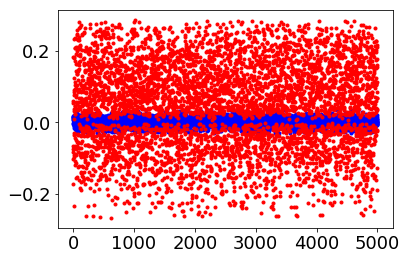

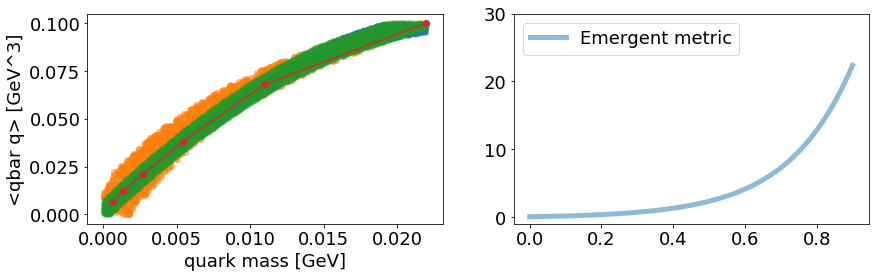

iter 6350 loss 0.047515
L: 3.068047046661377, lmd: 0.05408994480967522, poly: [6.903197   7.128583   6.0149517  5.612542   5.888207   3.2962043
 3.1240423  0.727084   0.04881631]
name grad
func.lmd tensor([1.2804])
func.L tensor([0.2180])
func.metric.poly_para tensor([0.0188, 0.0296, 0.0483, 0.0823, 0.1483, 0.2883, 0.6245, 1.6076, 5.8724])


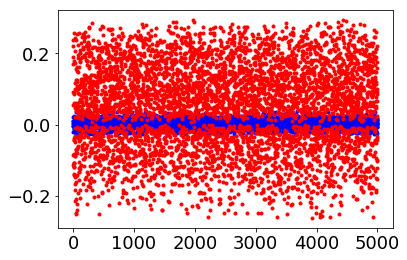

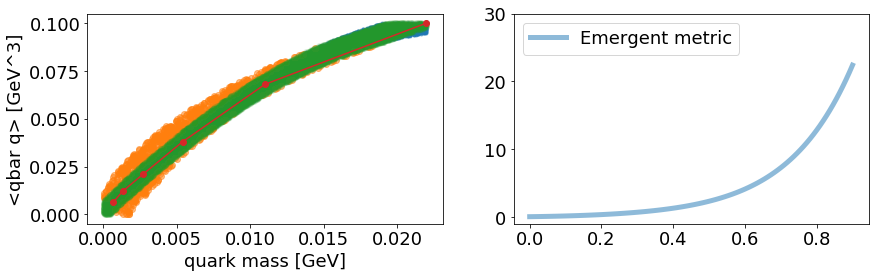

iter 6400 loss 0.047164
L: 3.0753109455108643, lmd: 0.05229286849498749, poly: [6.915675   7.1388664  6.023096   5.6186814  5.892539   3.2989693
 3.1254988  0.72748655 0.04838458]
name grad
func.lmd tensor([0.6921])
func.L tensor([0.1025])
func.metric.poly_para tensor([0.0070, 0.0114, 0.0190, 0.0330, 0.0605, 0.1192, 0.2609, 0.6773, 2.4912])


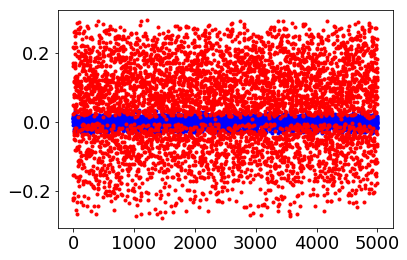

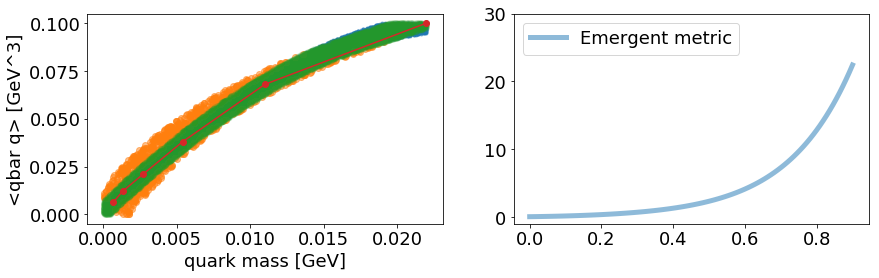

iter 6450 loss 0.048772
L: 3.082993268966675, lmd: 0.05126142501831055, poly: [6.927347   7.1483526  6.0304737  5.624104   5.8962097  3.3011315
 3.1264033  0.7273812  0.04748379]
name grad
func.lmd tensor([0.0590])
func.L tensor([-0.0094])
func.metric.poly_para tensor([-1.6343e-03, -1.7594e-03, -1.7369e-03, -1.3332e-03,  3.2636e-05,
         3.9320e-03,  1.5224e-02,  5.2689e-02,  2.3055e-01])


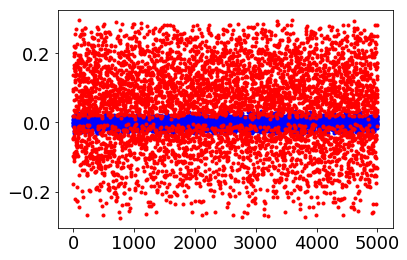

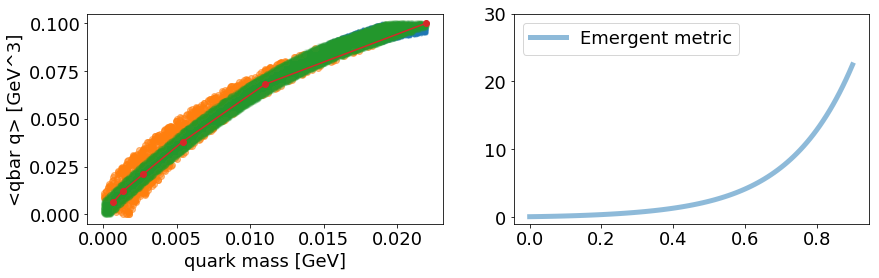

iter 6500 loss 0.047571
L: 3.090867519378662, lmd: 0.050980065017938614, poly: [6.9389176  7.157815   6.0379133  5.6296673  5.9000983  3.303577
 3.1276474  0.72766066 0.04700361]
name grad
func.lmd tensor([0.7480])
func.L tensor([0.1029])
func.metric.poly_para tensor([0.0067, 0.0111, 0.0188, 0.0330, 0.0610, 0.1209, 0.2660, 0.6932, 2.5571])


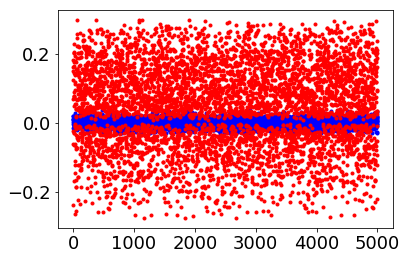

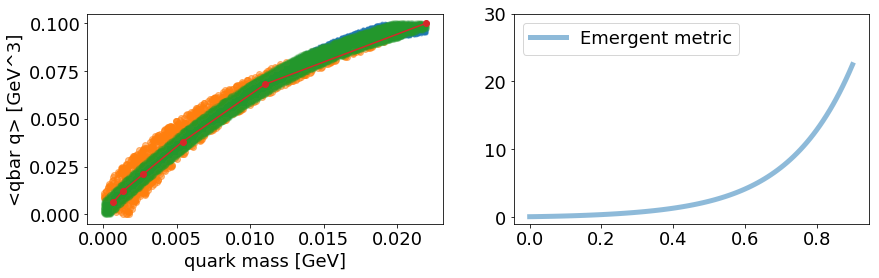

iter 6550 loss 0.046716
L: 3.0981462001800537, lmd: 0.050679661333560944, poly: [6.949422   7.166318   6.0445037  5.6344943  5.903353   3.3054814
 3.128429   0.72754085 0.0461756 ]
name grad
func.lmd tensor([1.2920])
func.L tensor([0.2080])
func.metric.poly_para tensor([0.0196, 0.0308, 0.0501, 0.0851, 0.1530, 0.2968, 0.6422, 1.6514, 6.0272])


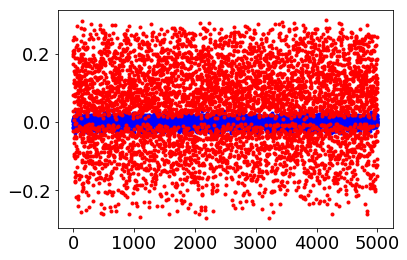

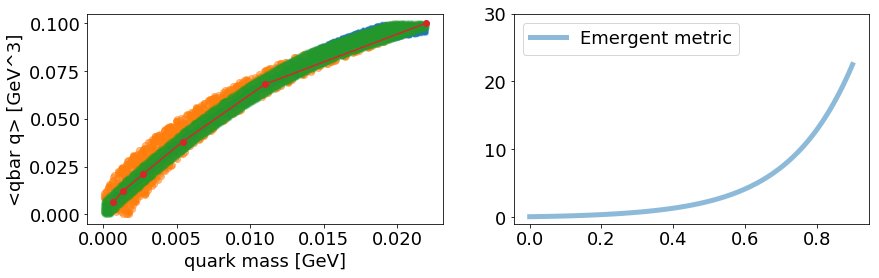

iter 6600 loss 0.044148
L: 3.1043014526367188, lmd: 0.04872163012623787, poly: [6.959981   7.1749015  6.051208   5.6394715  5.906793   3.3075974
 3.129448   0.7276763  0.04561428]
name grad
func.lmd tensor([-0.2846])
func.L tensor([-0.0709])
func.metric.poly_para tensor([-0.0085, -0.0123, -0.0186, -0.0295, -0.0499, -0.0918, -0.1899, -0.4708,
        -1.6681])


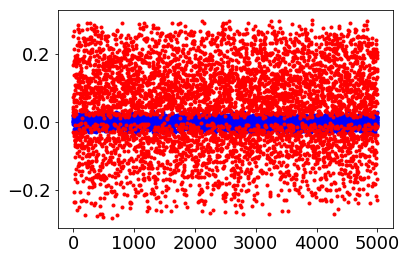

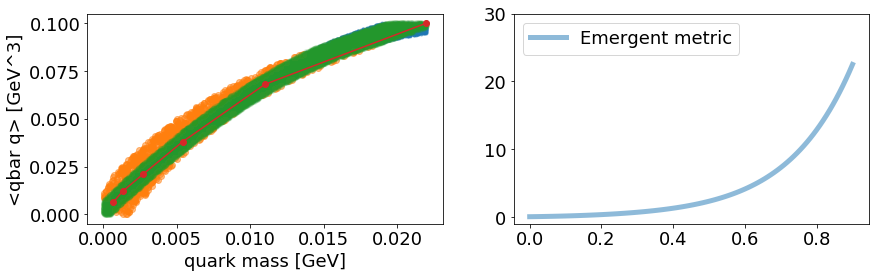

iter 6650 loss 0.046743
L: 3.111130714416504, lmd: 0.048456981778144836, poly: [6.9699564  7.1829653  6.057457   5.644061   5.9099083  3.309452
 3.130254   0.72764164 0.04491906]
name grad
func.lmd tensor([1.2661])
func.L tensor([0.1951])
func.metric.poly_para tensor([0.0185, 0.0290, 0.0471, 0.0800, 0.1437, 0.2789, 0.6032, 1.5510, 5.6608])


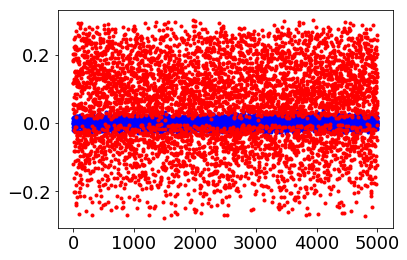

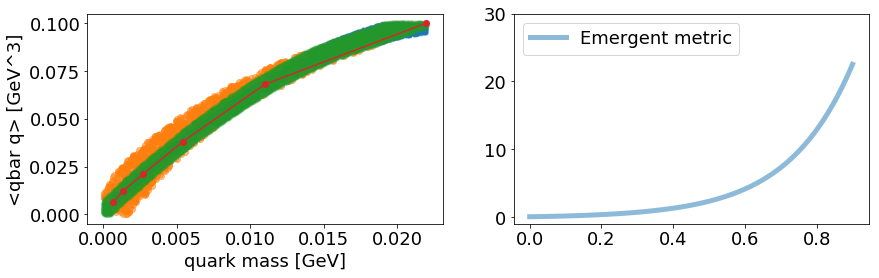

iter 6700 loss 0.046957
L: 3.1167757511138916, lmd: 0.046838440001010895, poly: [6.979496   7.190701   6.0634904  5.648537   5.9130096  3.3113713
 3.1311944  0.7277966  0.04445397]
name grad
func.lmd tensor([-0.0975])
func.L tensor([-0.0287])
func.metric.poly_para tensor([-0.0019, -0.0023, -0.0026, -0.0029, -0.0029, -0.0019,  0.0023,  0.0187,
         0.1034])


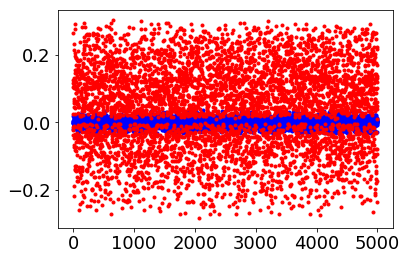

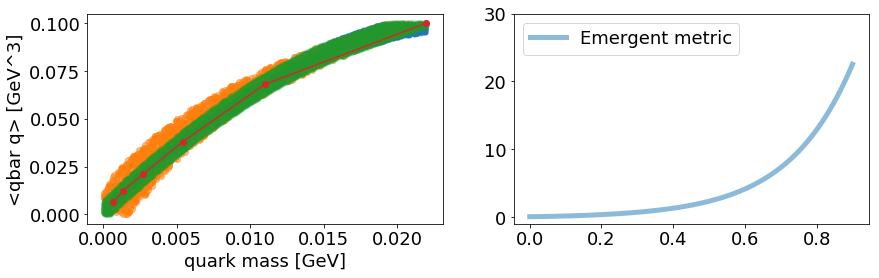

iter 6750 loss 0.046419
L: 3.1229188442230225, lmd: 0.04676419496536255, poly: [6.9886785  7.1981397  6.0692935  5.6528506  5.9160104  3.3132489
 3.1321394  0.7279958  0.04406603]
name grad
func.lmd tensor([1.0656])
func.L tensor([0.1546])
func.metric.poly_para tensor([0.0141, 0.0222, 0.0361, 0.0616, 0.1109, 0.2156, 0.4671, 1.2028, 4.3950])


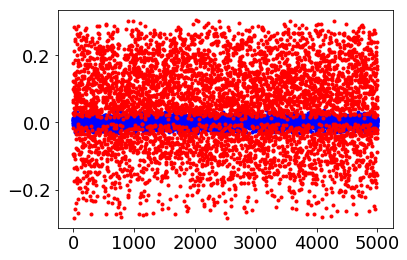

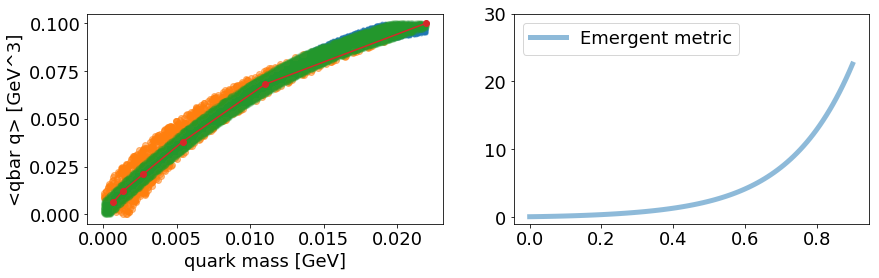

iter 6800 loss 0.044059
L: 3.1283156871795654, lmd: 0.04567762091755867, poly: [6.9972267  7.205025   6.0746255  5.6567717  5.91869    3.3148658
 3.1328776  0.72803104 0.04354713]
name grad
func.lmd tensor([-0.5063])
func.L tensor([-0.0976])
func.metric.poly_para tensor([-0.0108, -0.0159, -0.0245, -0.0396, -0.0682, -0.1275, -0.2675, -0.6710,
        -2.4012])


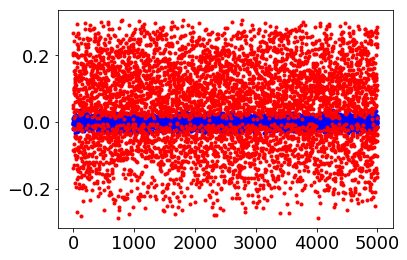

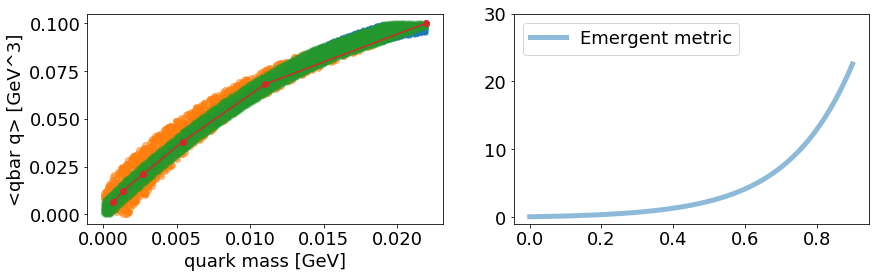

iter 6850 loss 0.044534
L: 3.133991003036499, lmd: 0.045080527663230896, poly: [7.0058365  7.211974   6.0800242  5.6607704  5.921447   3.3165689
 3.1337051  0.72815895 0.04312444]
name grad
func.lmd tensor([0.9891])
func.L tensor([0.1277])
func.metric.poly_para tensor([0.0097, 0.0155, 0.0257, 0.0443, 0.0805, 0.1578, 0.3440, 0.8903, 3.2674])


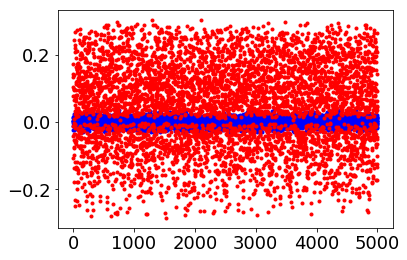

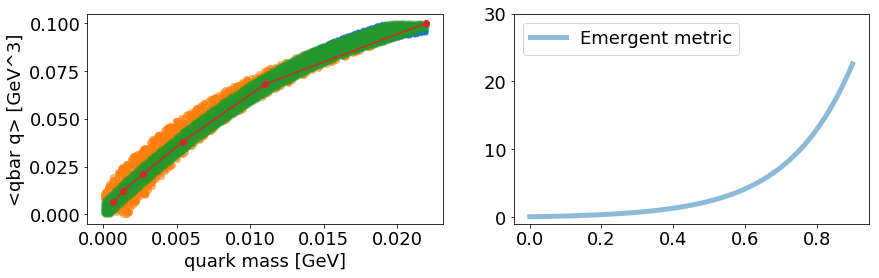

iter 6900 loss 0.044814
L: 3.1391830444335938, lmd: 0.04408382624387741, poly: [7.014257   7.218789   6.0853424  5.664732   5.924217   3.3183215
 3.134618   0.72839695 0.04283112]
name grad
func.lmd tensor([-0.3461])
func.L tensor([-0.0663])
func.metric.poly_para tensor([-0.0070, -0.0101, -0.0154, -0.0245, -0.0416, -0.0768, -0.1595, -0.3968,
        -1.4105])


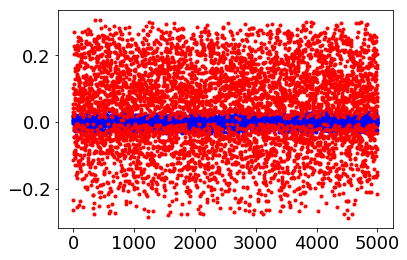

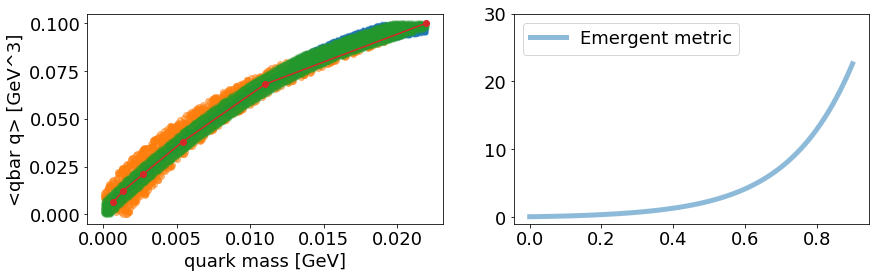

iter 6950 loss 0.044014
L: 3.144094944000244, lmd: 0.04251193627715111, poly: [7.0227013  7.225639   6.090711   5.6687613  5.927072   3.320172
 3.135639   0.72875226 0.04266186]
name grad
func.lmd tensor([-0.2859])
func.L tensor([-0.0617])
func.metric.poly_para tensor([-0.0082, -0.0120, -0.0183, -0.0294, -0.0503, -0.0937, -0.1957, -0.4891,
        -1.7447])


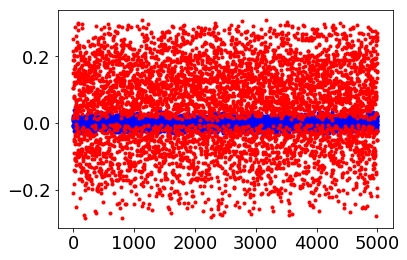

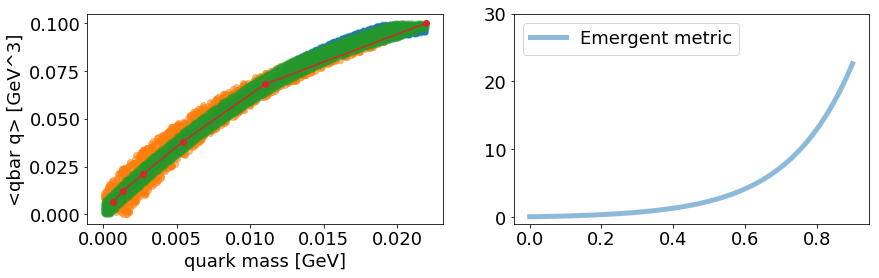

iter 7000 loss 0.045385
L: 3.149233341217041, lmd: 0.0417497493326664, poly: [7.030561  7.2319207 6.095528  5.672261  5.9294143 3.3215282 3.1361825
 0.7286433 0.0420405]
name grad
func.lmd tensor([0.1547])
func.L tensor([0.0124])
func.metric.poly_para tensor([0.0022, 0.0039, 0.0071, 0.0132, 0.0252, 0.0515, 0.1157, 0.3062, 1.1414])


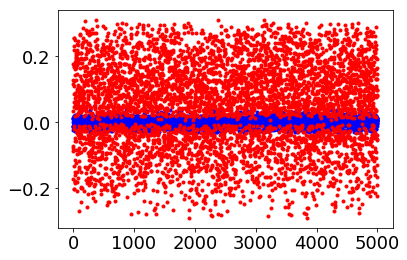

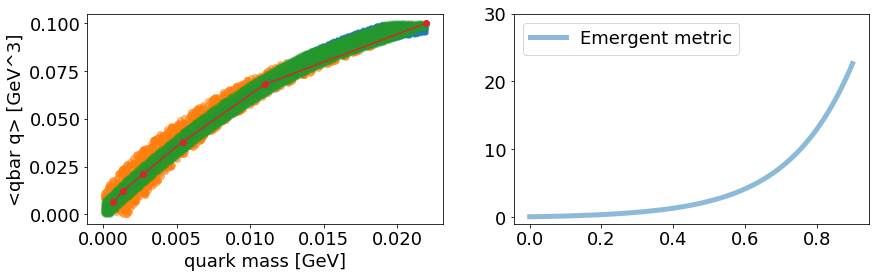

iter 7050 loss 0.046569
L: 3.155409336090088, lmd: 0.042870815843343735, poly: [7.0380197  7.2378354  6.1000137  5.6754627  5.9314885  3.3226435
 3.1365085  0.7283373  0.04124133]
name grad
func.lmd tensor([-2.1465])
func.L tensor([-0.3174])
func.metric.poly_para tensor([-0.0316, -0.0480, -0.0759, -0.1259, -0.2218, -0.4232, -0.9030, -2.2975,
        -8.3174])


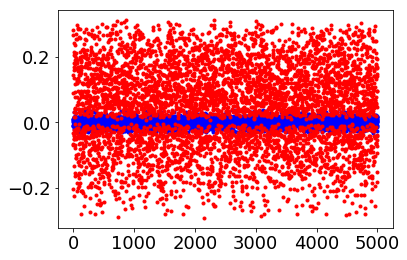

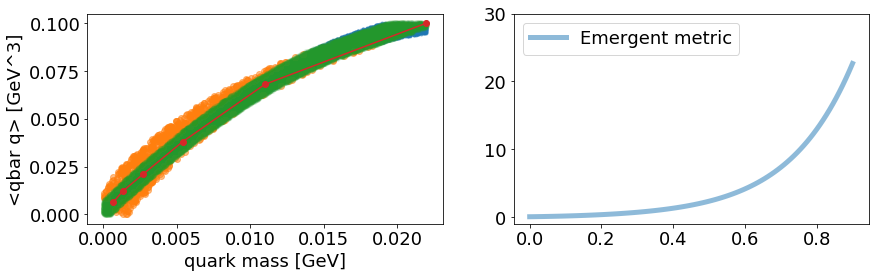

iter 7100 loss 0.043276
L: 3.1598856449127197, lmd: 0.041727758944034576, poly: [7.045575   7.243947   6.1047897  5.679038   5.9340124  3.3242714
 3.1373982  0.7286345  0.04107152]
name grad
func.lmd tensor([-0.4373])
func.L tensor([-0.0759])
func.metric.poly_para tensor([-0.0082, -0.0121, -0.0185, -0.0297, -0.0510, -0.0950, -0.1988, -0.4976,
        -1.7781])


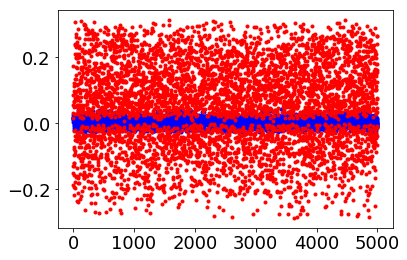

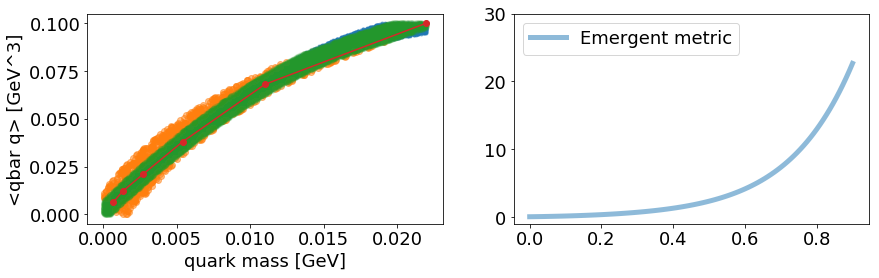

iter 7150 loss 0.043778
L: 3.1646108627319336, lmd: 0.04089000076055527, poly: [7.0528736  7.249798   6.109303   5.6823487  5.9362717  3.3256361
 3.1380272  0.72867197 0.04064479]
name grad
func.lmd tensor([-0.0966])
func.L tensor([-0.0327])
func.metric.poly_para tensor([-0.0050, -0.0070, -0.0104, -0.0161, -0.0267, -0.0481, -0.0978, -0.2388,
        -0.8352])


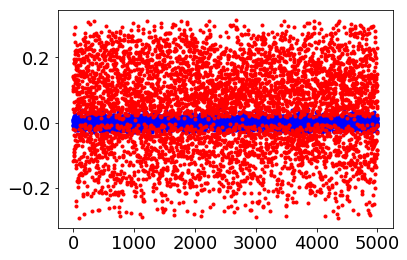

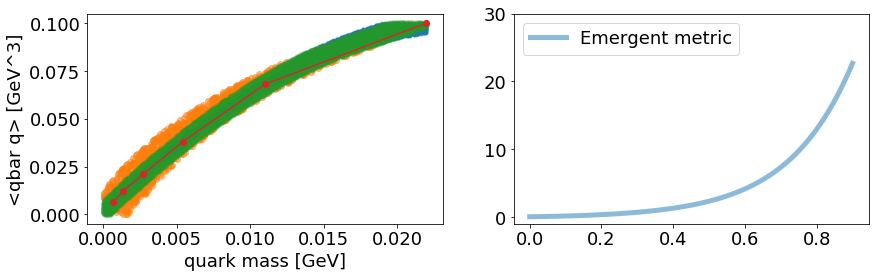

iter 7200 loss 0.044296
L: 3.1696648597717285, lmd: 0.04106024280190468, poly: [7.059825   7.255361   6.1135874  5.6854863  5.938406   3.326916
 3.1386046  0.72868663 0.04021883]
name grad
func.lmd tensor([0.5944])
func.L tensor([0.0705])
func.metric.poly_para tensor([0.0072, 0.0116, 0.0193, 0.0334, 0.0610, 0.1198, 0.2618, 0.6786, 2.4923])


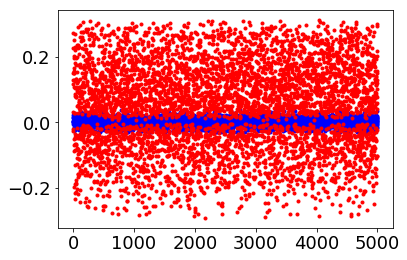

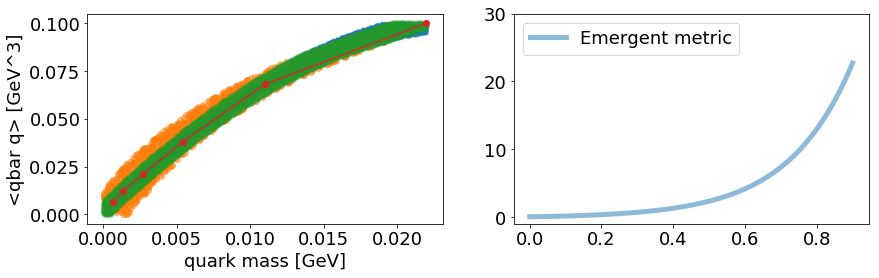

iter 7250 loss 0.042235
L: 3.1734964847564697, lmd: 0.03975391387939453, poly: [7.0665145  7.2607064  6.117696   5.688486   5.940438   3.328125
 3.1391373  0.72867537 0.03977897]
name grad
func.lmd tensor([-1.4396])
func.L tensor([-0.2004])
func.metric.poly_para tensor([-0.0194, -0.0293, -0.0461, -0.0760, -0.1333, -0.2532, -0.5387, -1.3671,
        -4.9405])


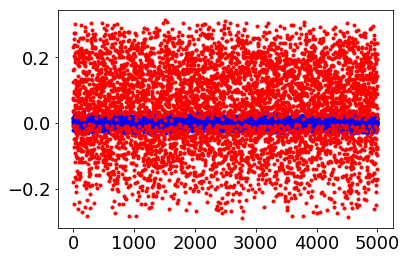

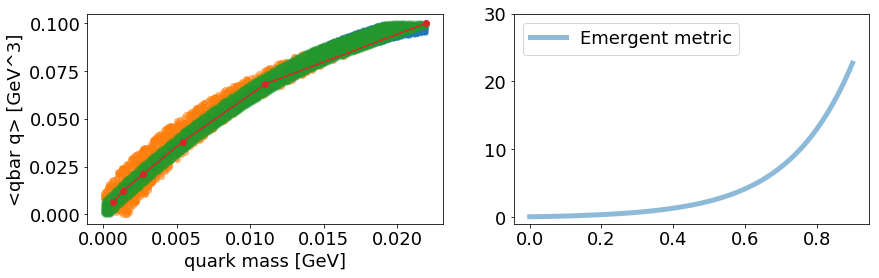

iter 7300 loss 0.043835
L: 3.1779754161834717, lmd: 0.039566099643707275, poly: [7.0732117  7.2660937  6.121886   5.6916037  5.9426227  3.3295152
 3.1398742  0.72888935 0.03958178]
name grad
func.lmd tensor([0.5971])
func.L tensor([0.0650])
func.metric.poly_para tensor([0.0061, 0.0099, 0.0166, 0.0289, 0.0531, 0.1048, 0.2299, 0.5979, 2.2015])


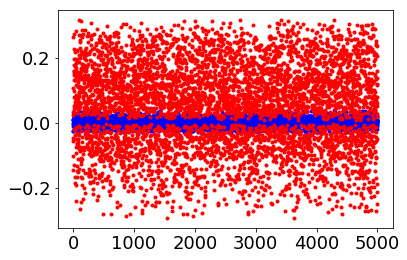

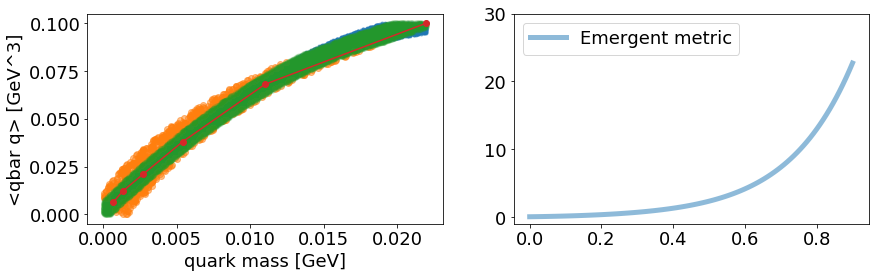

iter 7350 loss 0.045324
L: 3.182464838027954, lmd: 0.039424750953912735, poly: [7.0794663  7.271076   6.1256995  5.694379   5.9444895  3.3306134
 3.1403394  0.7288476  0.03914367]
name grad
func.lmd tensor([-1.0322])
func.L tensor([-0.1519])
func.metric.poly_para tensor([-0.0162, -0.0242, -0.0378, -0.0619, -0.1080, -0.2041, -0.4324, -1.0935,
        -3.9400])


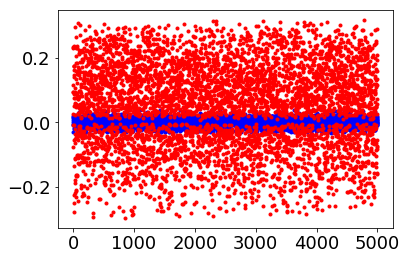

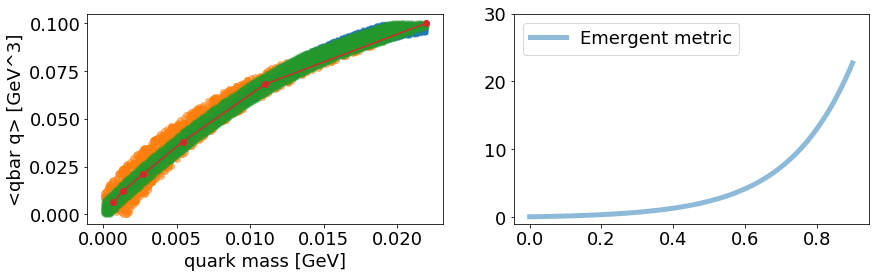

iter 7400 loss 0.042751
L: 3.1864895820617676, lmd: 0.03871409595012665, poly: [7.085732   7.276091   6.129568   5.697227   5.9464455  3.331814
 3.140918   0.7289293  0.03883414]
name grad
func.lmd tensor([1.2937])
func.L tensor([0.1608])
func.metric.poly_para tensor([0.0174, 0.0273, 0.0443, 0.0751, 0.1350, 0.2618, 0.5663, 1.4564, 5.3169])


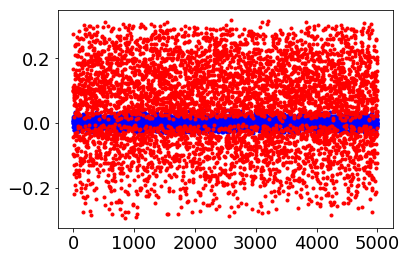

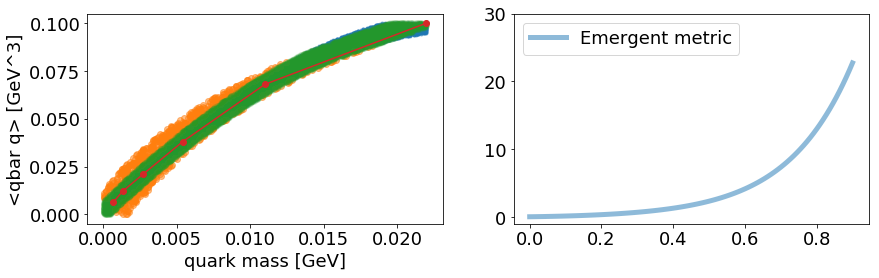

iter 7450 loss 0.045275
L: 3.190603017807007, lmd: 0.03809550777077675, poly: [7.091933  7.281053  6.1334    5.700051  5.94839   3.3330142 3.1415057
 0.7290264 0.0385462]
name grad
func.lmd tensor([2.1128])
func.L tensor([0.2591])
func.metric.poly_para tensor([0.0258, 0.0401, 0.0646, 0.1090, 0.1949, 0.3766, 0.8120, 2.0835, 7.5937])


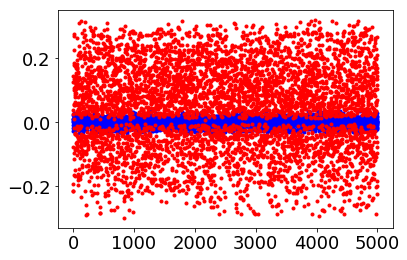

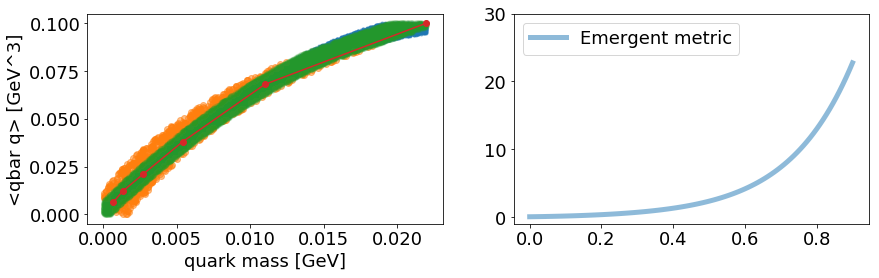

iter 7500 loss 0.041566
L: 3.1943252086639404, lmd: 0.036972254514694214, poly: [7.0980196  7.285916   6.1371455  5.7028003  5.95027    3.3341606
 3.1420472  0.72908276 0.0382213 ]
name grad
func.lmd tensor([-1.7422])
func.L tensor([-0.2286])
func.metric.poly_para tensor([-0.0233, -0.0352, -0.0554, -0.0915, -0.1604, -0.3050, -0.6490, -1.6476,
        -5.9556])


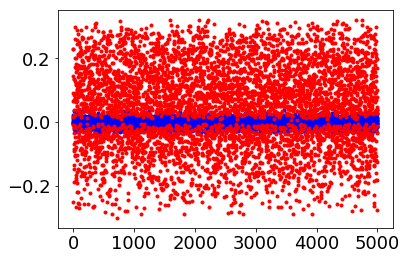

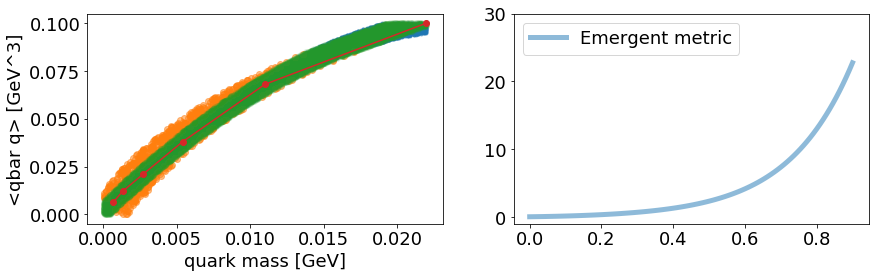

iter 7550 loss 0.043544
L: 3.1977548599243164, lmd: 0.03637230023741722, poly: [7.1036196 7.2903857 6.140584  5.705322  5.9519916 3.335204  3.1425333
 0.7291219 0.037909 ]
name grad
func.lmd tensor([1.0531])
func.L tensor([0.1217])
func.metric.poly_para tensor([0.0137, 0.0217, 0.0354, 0.0604, 0.1091, 0.2124, 0.4608, 1.1881, 4.3452])


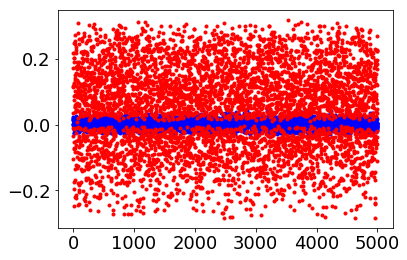

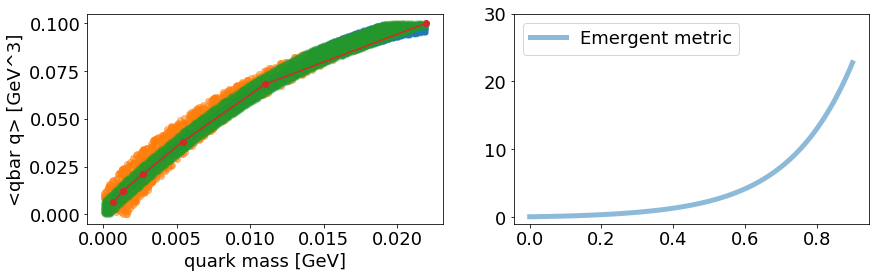

iter 7600 loss 0.041793
L: 3.2016079425811768, lmd: 0.03643534705042839, poly: [7.1091833  7.294845   6.1440396  5.7078834  5.953775   3.3363297
 3.1431177  0.7292737  0.03772094]
name grad
func.lmd tensor([0.4422])
func.L tensor([0.0388])
func.metric.poly_para tensor([0.0025, 0.0044, 0.0077, 0.0138, 0.0260, 0.0523, 0.1166, 0.3067, 1.1398])


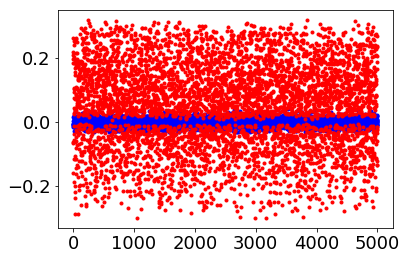

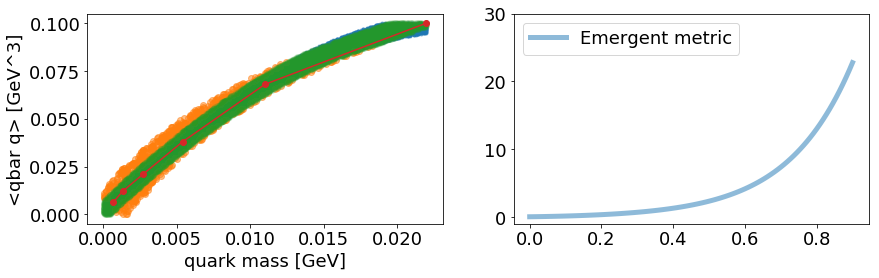

iter 7650 loss 0.041516
L: 3.2050235271453857, lmd: 0.03608265519142151, poly: [7.1144505  7.299039   6.147264   5.7102394  5.9553766  3.3372977
 3.1435628  0.72930056 0.03741869]
name grad
func.lmd tensor([1.8242])
func.L tensor([0.2178])
func.metric.poly_para tensor([0.0241, 0.0375, 0.0606, 0.1023, 0.1831, 0.3539, 0.7634, 1.9594, 7.1424])


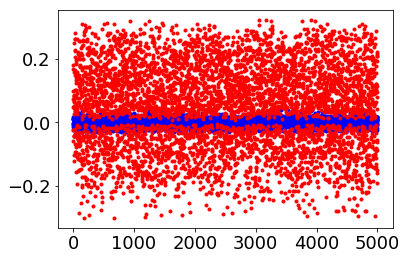

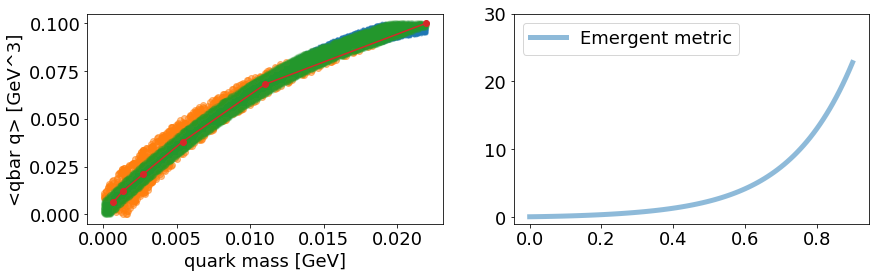

iter 7700 loss 0.040095
L: 3.208799123764038, lmd: 0.03606269881129265, poly: [7.1196    7.3031216 6.1503773 5.712495  5.956887  3.3381755 3.1439226
 0.7292452 0.0370388]
name grad
func.lmd tensor([1.8046])
func.L tensor([0.2131])
func.metric.poly_para tensor([0.0230, 0.0358, 0.0577, 0.0974, 0.1742, 0.3366, 0.7259, 1.8626, 6.7882])


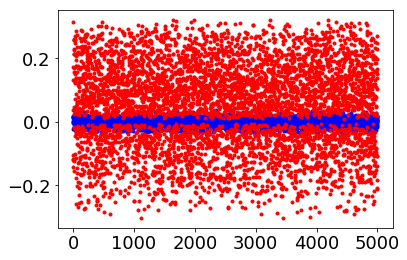

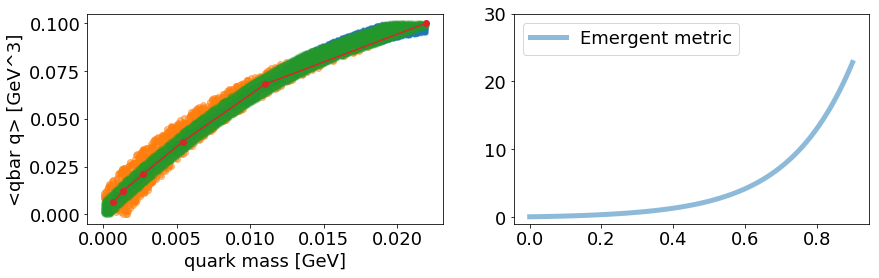

iter 7750 loss 0.040564
L: 3.211667537689209, lmd: 0.035378385335206985, poly: [7.1244297  7.30698    6.1533527  5.7146907  5.958403   3.3391175
 3.1443932  0.72933805 0.03683417]
name grad
func.lmd tensor([-1.8336])
func.L tensor([-0.2252])
func.metric.poly_para tensor([-0.0225, -0.0341, -0.0536, -0.0884, -0.1552, -0.2951, -0.6281, -1.5951,
        -5.7679])


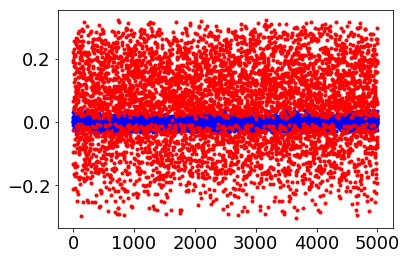

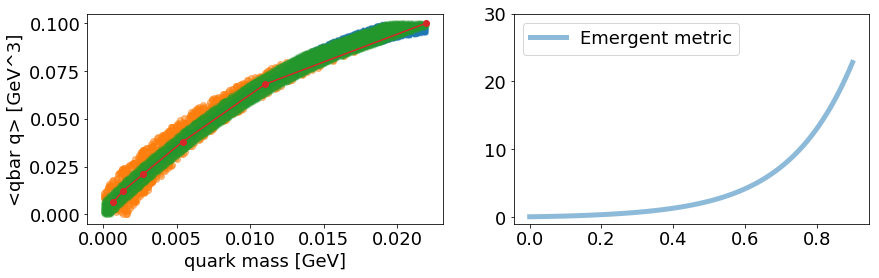

iter 7800 loss 0.042286
L: 3.214618682861328, lmd: 0.034359775483608246, poly: [7.1294413  7.310991   6.1564517  5.7169867  5.9599996  3.3401227
 3.144913   0.7294692  0.03665924]
name grad
func.lmd tensor([-0.6548])
func.L tensor([-0.0849])
func.metric.poly_para tensor([-0.0085, -0.0125, -0.0193, -0.0313, -0.0541, -0.1014, -0.2134, -0.5369,
        -1.9272])


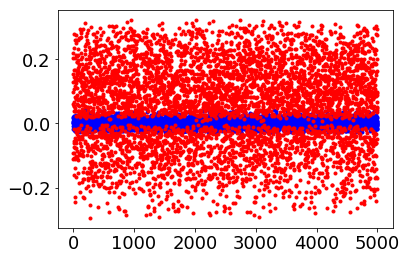

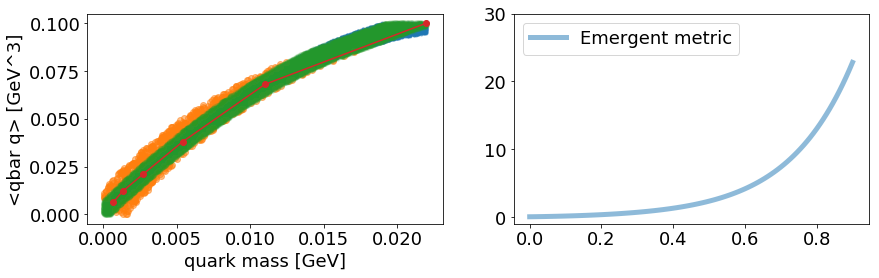

iter 7850 loss 0.042596
L: 3.2180585861206055, lmd: 0.034518152475357056, poly: [7.1343303  7.314908   6.1594872  5.719243   5.96158    3.3411314
 3.1454513  0.7296323  0.03652753]
name grad
func.lmd tensor([4.2861])
func.L tensor([0.4945])
func.metric.poly_para tensor([ 0.0512,  0.0790,  0.1266,  0.2123,  0.3778,  0.7271,  1.5630,  4.0007,
        14.5553])


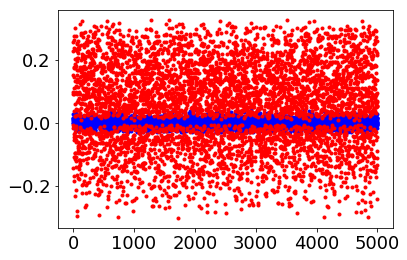

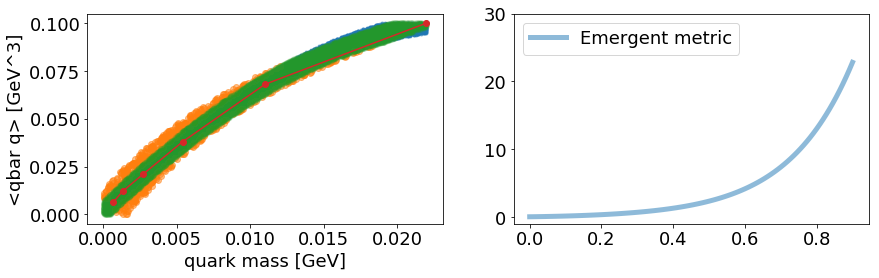

iter 7900 loss 0.041676
L: 3.22117018699646, lmd: 0.03453975170850754, poly: [7.1385922  7.3182425  6.1619844  5.7209983  5.962692   3.3417008
 3.1455748  0.7294001  0.03601624]
name grad
func.lmd tensor([-0.2650])
func.L tensor([-0.0465])
func.metric.poly_para tensor([-0.0053, -0.0075, -0.0111, -0.0173, -0.0286, -0.0516, -0.1049, -0.2563,
        -0.8979])


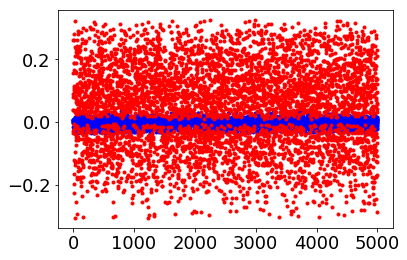

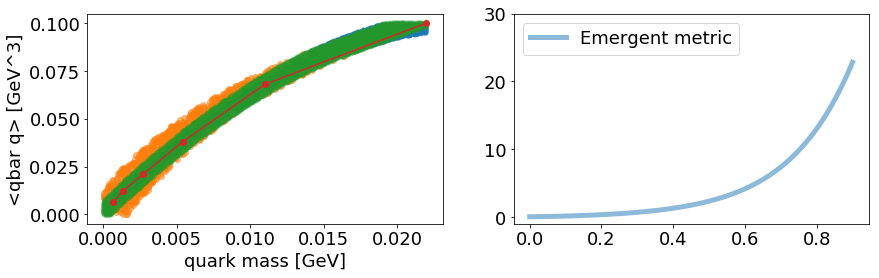

iter 7950 loss 0.038222
L: 3.2244255542755127, lmd: 0.034409165382385254, poly: [7.1431007  7.321832   6.1647434  5.723022   5.964078   3.3425505
 3.1459823  0.7294551  0.03579472]
name grad
func.lmd tensor([0.0161])
func.L tensor([-0.0098])
func.metric.poly_para tensor([-0.0015, -0.0018, -0.0022, -0.0027, -0.0033, -0.0039, -0.0042, -0.0023,
         0.0159])


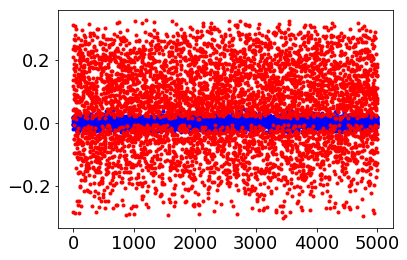

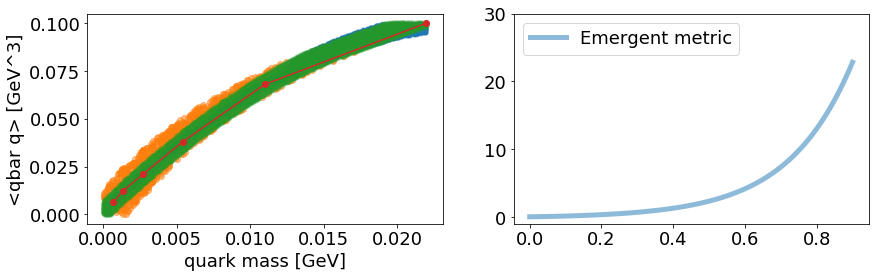

iter 8000 loss 0.041556
L: 3.2279975414276123, lmd: 0.03462286666035652, poly: [7.1477633  7.325557   6.167622   5.725152   5.96556    3.343485
 3.1464672  0.7295811  0.03563982]
name grad
func.lmd tensor([0.6532])
func.L tensor([0.0614])
func.metric.poly_para tensor([0.0045, 0.0073, 0.0121, 0.0209, 0.0381, 0.0748, 0.1636, 0.4245, 1.5617])


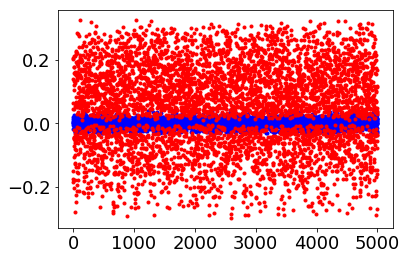

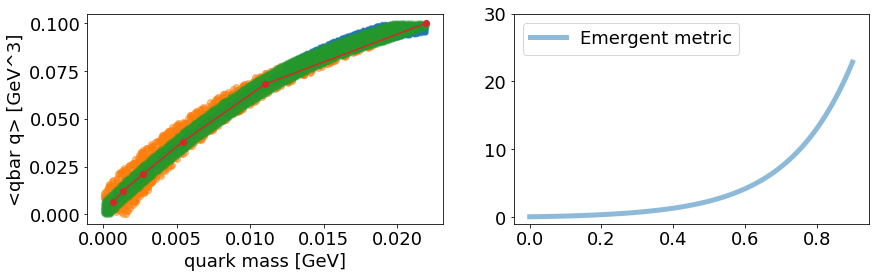

iter 8050 loss 0.042017
L: 3.230560779571533, lmd: 0.03385820984840393, poly: [7.151995   7.3289146  6.170191   5.7270207  5.966824   3.3442388
 3.146801   0.7295795  0.03537381]
name grad
func.lmd tensor([-0.7917])
func.L tensor([-0.1049])
func.metric.poly_para tensor([-0.0120, -0.0179, -0.0277, -0.0452, -0.0784, -0.1476, -0.3117, -0.7864,
        -2.8282])


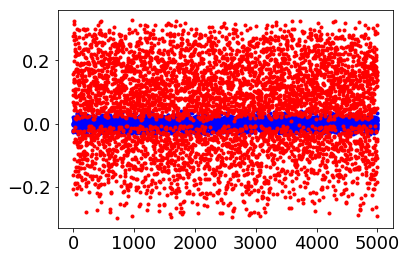

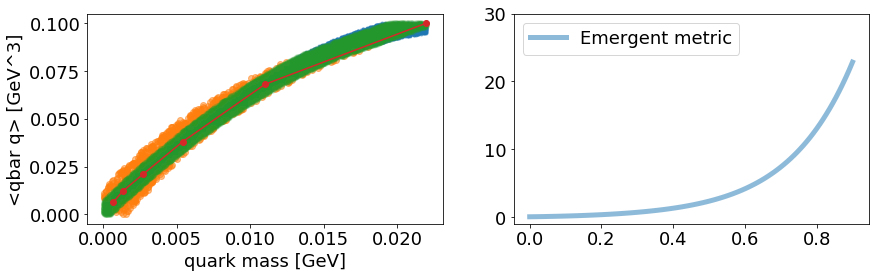

iter 8100 loss 0.040738
L: 3.2335610389709473, lmd: 0.03313567861914635, poly: [7.1565943  7.3325944  6.173042   5.729136   5.968306   3.3451834
 3.1473055  0.72973216 0.03524984]
name grad
func.lmd tensor([-1.2170])
func.L tensor([-0.1477])
func.metric.poly_para tensor([-0.0164, -0.0247, -0.0388, -0.0638, -0.1118, -0.2121, -0.4508, -1.1434,
        -4.1299])


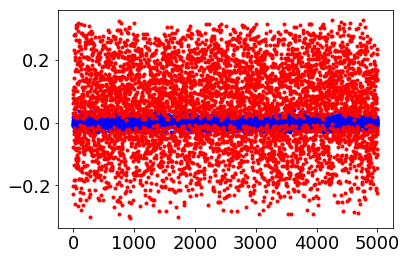

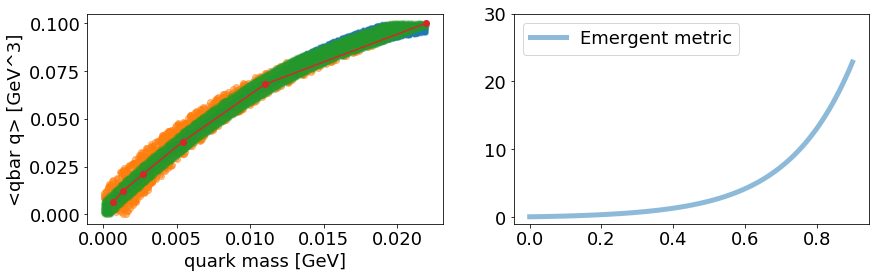

iter 8150 loss 0.040547
L: 3.2364509105682373, lmd: 0.03256332501769066, poly: [7.160898   7.3359966  6.1756277  5.731001   5.9695463  3.3458962
 3.1475847  0.7296657  0.03491176]
name grad
func.lmd tensor([-1.5353])
func.L tensor([-0.1825])
func.metric.poly_para tensor([-0.0207, -0.0313, -0.0493, -0.0814, -0.1428, -0.2718, -0.5788, -1.4704,
        -5.3178])


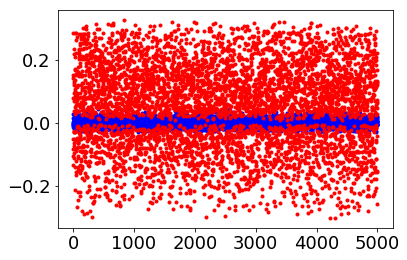

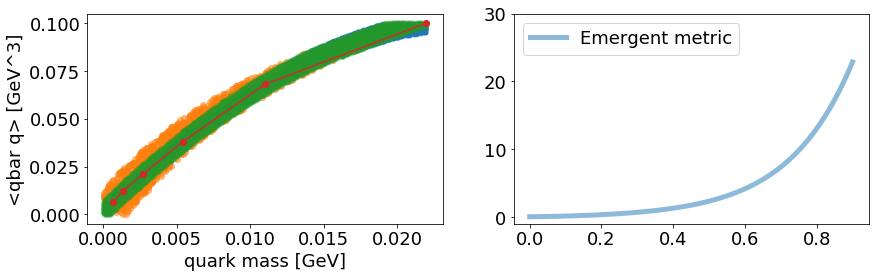

KeyboardInterrupt: 

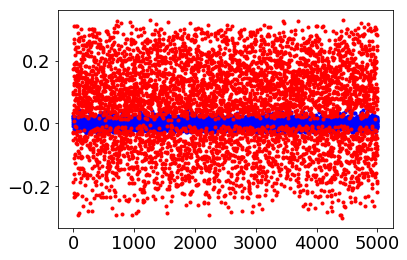

In [61]:
n_points = 2
batch_dim = 10000
num_itr = 10000
show_epoch_each = 50
eps = 0.03
dev = 0.03/5
panelty = 0.0

times_np = np.linspace(0, 0.9, num=n_points)
times = torch.from_numpy(times_np.astype(np.float32))

optimizer = optim.Adam(ode.parameters(), lr=1e-3)


for itr in range(num_itr):
    data_H, data_M, label = create_batch_data(pos_H, pos_M, neg_H, neg_M,
                                              batch_dim)
    init0 = data_2_init_cond(data_H, data_M, ode.func.L, ode.func.lmd)
    pred_final_state = ode(init0, times)

    loss = F.mse_loss(tanaka(pred_final_state[:, 1],
                              epsilon=eps,
                              tanh=torch.tanh, dev = dev),
                      torch.from_numpy(label.astype(np.float32)))+\
    panelty*((ode.func.metric.poly_para[-1]-4)**2)

    optimizer.zero_grad()
    loss.backward()
#     torch.nn.utils.clip_grad_norm_(ode.func.parameters(), 0.1)
    optimizer.step()

    if itr % show_epoch_each == 0:
        print('iter {} loss {:.6f}'.format(itr, loss.item()))
        np_losses.append(loss.item())
        print('L: {}, lmd: {}, poly: {}'.format(ode.func.L.item(), ode.func.lmd.item(),\
                                               ode.func.metric.poly_para.detach().numpy()))
        print('name grad')
        for name, param in ode.named_parameters():
            print('{} {}'.format(name, param.grad))
        plot_phase_and_metric(eps = eps, dev = dev, threshold=0.1)
        plt.plot(pred_final_state.detach().numpy()[:int(batch_dim/2),1],'b.')
        plt.plot(pred_final_state.detach().numpy()[int(batch_dim/2):,1],'r.')